## EDA

In [0]:
from pyspark.sql.functions import col, sum as _sum, when
import pandas as pd
import matplotlib.pyplot as plt
from pyspark.sql import functions as F
from pyspark.sql.types import NumericType

import seaborn as sns



In [0]:
section = "4"
number = "1"
folder_path = f"dbfs:/student-groups/Group_{section}_{number}"
dbutils.fs.mkdirs(folder_path)


True

## Data for the Project

### _**Load Data**_

OTPW Data: This is our joined data (We joined Airlines and Weather) - 3 Months Sample Data

In [0]:
# OTPW
df_otpw = spark.read.format("csv").option("header","true").load(f"dbfs:/mnt/mids-w261/OTPW_3M_2015.csv")

# Total rows and columns
print(f"Rows: {df_otpw.count():,}")
print(f"Columns: {len(df_otpw.columns)}")

# Schema information
df_otpw.printSchema()

display(df_otpw.limit(5))


Rows: 1,401,363
Columns: 216
root
 |-- QUARTER: string (nullable = true)
 |-- DAY_OF_MONTH: string (nullable = true)
 |-- DAY_OF_WEEK: string (nullable = true)
 |-- FL_DATE: string (nullable = true)
 |-- OP_UNIQUE_CARRIER: string (nullable = true)
 |-- OP_CARRIER_AIRLINE_ID: string (nullable = true)
 |-- OP_CARRIER: string (nullable = true)
 |-- TAIL_NUM: string (nullable = true)
 |-- OP_CARRIER_FL_NUM: string (nullable = true)
 |-- ORIGIN_AIRPORT_ID: string (nullable = true)
 |-- ORIGIN_AIRPORT_SEQ_ID: string (nullable = true)
 |-- ORIGIN_CITY_MARKET_ID: string (nullable = true)
 |-- ORIGIN: string (nullable = true)
 |-- ORIGIN_CITY_NAME: string (nullable = true)
 |-- ORIGIN_STATE_ABR: string (nullable = true)
 |-- ORIGIN_STATE_FIPS: string (nullable = true)
 |-- ORIGIN_STATE_NM: string (nullable = true)
 |-- ORIGIN_WAC: string (nullable = true)
 |-- DEST_AIRPORT_ID: string (nullable = true)
 |-- DEST_AIRPORT_SEQ_ID: string (nullable = true)
 |-- DEST_CITY_MARKET_ID: string (nullable 

QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat

In [0]:
display(df_otpw.limit(100))


QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat

In [0]:
from pyspark.sql import functions as F

# Columns to summarize
numeric_cols = [
    "DEP_DELAY",
    "DEP_DELAY_NEW",
    "DEP_DELAY_GROUP",
    "TAXI_OUT",
    "WHEELS_OFF",
    "DEP_TIME",
    "CRS_DEP_TIME"
]

# 1. Summary stats for numeric fields
summary_stats = (
    df_otpw.select(numeric_cols)
      .summary("count", "mean", "stddev", "min", "25%", "50%", "75%", "max")
)

summary_stats.show(truncate=False)

# 2. DEP_DEL15 (Binary) — only percentage of 1's
dep_del15_stats = (
    df_otpw.select(
        F.mean(F.col("DEP_DEL15")).alias("pct_delayed_over_15min")
    )
)

dep_del15_stats.show()


+-------+------------------+------------------+-------------------+------------------+------------------+------------------+------------------+
|summary|DEP_DELAY         |DEP_DELAY_NEW     |DEP_DELAY_GROUP    |TAXI_OUT          |WHEELS_OFF        |DEP_TIME          |CRS_DEP_TIME      |
+-------+------------------+------------------+-------------------+------------------+------------------+------------------+------------------+
|count  |1359057           |1359057           |1359057            |1358244           |1358244           |1359057           |1401363           |
|mean   |10.356973254249086|13.018863079326326|0.10478736359107822|16.396356619281956|1360.2707805077732|1337.0941873666814|1327.3694809981425|
|stddev |37.84557177171765 |36.7668667774631  |2.094169598462632  |9.62962543055323  |485.9576917932718 |485.4186189667937 |473.6824407220725 |
|min    |-1.0              |0.0               |-1                 |1.0               |1                 |1                 |1           

In [0]:

from pyspark.sql import functions as F

# Columns to summarize
numeric_cols = [
    "HourlyAltimeterSetting",
    "HourlySeaLevelPressure",
    "HourlyStationPressure",
    "HourlyPressureChange",
    "HourlyPressureTendency"
]

# 1. Summary stats for numeric fields
summary_stats = (
    df_otpw.select([col if col != 'HourlySeaLevelPressure' else 'HourlySeaLevelPressure' for col in numeric_cols])
      .summary("count", "mean", "stddev", "min", "25%", "50%", "75%", "max")
)

summary_stats.show(truncate=False)



+-------+----------------------+----------------------+---------------------+---------------------+----------------------+
|summary|HourlyAltimeterSetting|HourlySeaLevelPressure|HourlyStationPressure|HourlyPressureChange |HourlyPressureTendency|
+-------+----------------------+----------------------+---------------------+---------------------+----------------------+
|count  |1338148               |1247907               |1391739              |471407               |471407                |
|mean   |30.121501822905373    |30.130006451411255    |29.2278870452999     |0.0013680535079029377|4.391328512304654     |
|stddev |0.20081071933645678   |0.2097999685402198    |1.3501513443882156   |0.05032599354804974  |2.7950930537437944    |
|min    |28.62                 |28.63                 |22.22                |+0.00                |0                     |
|25%    |29.99                 |29.99                 |29.13                |-0.03                |2.0                   |
|50%    |30.12  

In [0]:

from pyspark.sql import functions as F

# Columns to summarize
numeric_cols = [
    "HourlyDryBulbTemperature", "HourlyWetBulbTemperature" , "HourlyDewPointTemperature" , "HourlyRelativeHumidity",
"HourlyWindDirection", "HourlyWindSpeed","HourlyWindGustSpeed", "HourlyVisibility", "HourlyPrecipitation"
]

# 1. Summary stats for numeric fields
summary_stats = (
    df_otpw.select(numeric_cols)
      .summary("count", "mean", "stddev", "min", "25%", "50%", "75%", "max")
)

summary_stats.show(truncate=False)



+-------+------------------------+------------------------+-------------------------+----------------------+-------------------+-----------------+-------------------+-----------------+--------------------+
|summary|HourlyDryBulbTemperature|HourlyWetBulbTemperature|HourlyDewPointTemperature|HourlyRelativeHumidity|HourlyWindDirection|HourlyWindSpeed  |HourlyWindGustSpeed|HourlyVisibility |HourlyPrecipitation |
+-------+------------------------+------------------------+-------------------------+----------------------+-------------------+-----------------+-------------------+-----------------+--------------------+
|count  |1396906                 |1391105                 |1396790                  |1396642               |1395292            |1396717          |182027             |1397276          |1242335             |
|mean   |47.39732720280171       |40.87331200204734       |32.178502448844256       |60.50087211300522     |183.51128579857084 |8.954836141396958|25.875176486746327 |9.00799213

### **_Check Duplicates - 1 row per flight_**

In [0]:
#DEP_DELAY_NEW

# ---------- Find Duplicates ----------
dup_key = ["FL_DATE", "OP_CARRIER_FL_NUM", "ORIGIN", "DEST", "CRS_DEP_TIME"]

dups = (df_otpw
        .groupBy(dup_key)
        .count()
        .filter(F.col("count") > 1)
        .orderBy(F.desc("count")))

print("Number of duplicate key groups:", dups.count())
display(dups)  # show examples


Number of duplicate key groups: 31


FL_DATE,OP_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,count
2015-03-07,415,JFK,SFO,1630,2
2015-03-19,415,JFK,SFO,1630,2
2015-03-01,415,JFK,SFO,1630,2
2015-03-04,415,JFK,SFO,1630,2
2015-03-18,415,JFK,SFO,1630,2
2015-03-11,415,JFK,SFO,1630,2
2015-03-08,415,JFK,SFO,1630,2
2015-03-15,415,JFK,SFO,1630,2
2015-03-21,415,JFK,SFO,1630,2
2015-03-27,415,JFK,SFO,1630,2


In [0]:
import pandas as pd
from pyspark.sql import functions as F

dup_key = ["FL_DATE","OP_CARRIER_FL_NUM","ORIGIN","DEST","CRS_DEP_TIME"]

# 1. get duplicate keys (small)
dup_keys = (df_otpw
            .groupBy(dup_key)
            .count()
            .filter(F.col("count") > 1)
            .select(*dup_key))

dup_list = dup_keys.collect()   # safe: 30 groups

# 2. pull all duplicate rows in a single spark->pandas transfer
dup_rows = df_otpw.join(dup_keys, on=dup_key, how="inner").orderBy(*dup_key)
dup_pdf = dup_rows.toPandas()   # small, OK to collect once

# 3. do vectorized pandas group diffs
compare_cols = dup_pdf.columns.tolist()  # or a subset like earlier
report_rows = []
group_dfs = {}

grouped = dup_pdf.groupby(["FL_DATE","OP_CARRIER_FL_NUM","ORIGIN","DEST","CRS_DEP_TIME"])

for name, group in grouped:
    group_dfs[name] = group  # store for detailed inspection
    if group.shape[0] >= 2:
        # compare first two rows (or compute distinct counts)
        diffs = []
        for c in compare_cols:
            a = group.iloc[0][c]
            # check difference across entire group (any value different)
            vals = group[c].dropna().unique()
            if len(vals) > 1:
                diffs.append(c)
        num_diff = len(diffs)
        sample_diff = ", ".join(diffs[:8])
    else:
        num_diff = 0
        sample_diff = ""

    report_rows.append({
        "FL_DATE": name[0],
        "OP_CARRIER_FL_NUM": name[1],
        "ORIGIN": name[2],
        "DEST": name[3],
        "CRS_DEP_TIME": name[4],
        "group_size": group.shape[0],
        "num_diff_columns": num_diff,
        "diff_columns_sample": sample_diff
    })

report_df = pd.DataFrame(report_rows).sort_values(["FL_DATE"])
display(report_df)
# group_dfs holds the small pandas DF per group for in-depth checks


FL_DATE,OP_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,group_size,num_diff_columns,diff_columns_sample
2015-03-01,415,JFK,SFO,1630,2,17,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, TAXI_OUT, WHEELS_OFF, WHEELS_ON, TAXI_IN"
2015-03-02,415,JFK,SFO,1630,2,22,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, DEP_DELAY_NEW, DEP_DEL15"
2015-03-03,415,JFK,SFO,1630,2,23,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, DEP_DELAY_NEW, DEP_DEL15"
2015-03-04,415,JFK,SFO,1630,2,16,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, TAXI_OUT, WHEELS_OFF"
2015-03-05,415,JFK,SFO,1630,2,7,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, CRS_ARR_TIME, CANCELLED, CRS_ELAPSED_TIME"
2015-03-06,415,JFK,SFO,1630,2,22,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, DEP_DELAY_NEW, DEP_DEL15"
2015-03-07,415,JFK,SFO,1630,2,17,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, DEP_DELAY_GROUP, TAXI_OUT"
2015-03-08,415,JFK,SFO,1630,2,14,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, DEP_DELAY_NEW, WHEELS_OFF"
2015-03-09,415,JFK,SFO,1630,2,22,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, DEP_DELAY_NEW, DEP_DEL15"
2015-03-10,415,JFK,SFO,1630,2,16,"OP_UNIQUE_CARRIER, OP_CARRIER_AIRLINE_ID, OP_CARRIER, TAIL_NUM, DEP_TIME, DEP_DELAY, TAXI_OUT, WHEELS_OFF"


In [0]:
from pyspark.sql import functions as F
from pyspark.sql.window import Window
from pyspark.sql.functions import col, row_number

dup_key = ["FL_DATE","OP_CARRIER_FL_NUM","ORIGIN","DEST","CRS_DEP_TIME"]

#quick counts before
before_count = df_otpw.count()
dup_groups_count = (df_otpw.groupBy(dup_key).count().filter(F.col("count") > 1).count())
print(f"Total rows before: {before_count:,}")
print(f"Duplicate groups found: {dup_groups_count:,}")

# create an integer DEP_TIME helper (nulls -> -1 so they sort last)
df_tmp = df_otpw.withColumn(
    "DEP_TIME_int",
    F.when(F.col("DEP_TIME").isNull(), F.lit(-1)).otherwise(F.col("DEP_TIME").cast("int"))
)

# window to keep latest DEP_TIME (highest DEP_TIME_int)
w = Window.partitionBy(*dup_key).orderBy(col("DEP_TIME_int").desc())

# rank and filter
df_ranked = df_tmp.withColumn("rn", row_number().over(w))

# inspect rows that would be removed for a few groups
to_remove = df_ranked.filter(F.col("rn") > 1)
print("Example rows that will be removed (showing up to 20):")
display(to_remove.select(*dup_key, "DEP_TIME", "DEP_TIME_int", "DEP_DELAY", "ARR_TIME", "ARR_DELAY").limit(20))

# 6) keep top row per group
df_dedup = df_ranked.filter(F.col("rn") == 1).drop("rn", "DEP_TIME_int")

# 7) counts after and sanity check
after_count = df_dedup.count()
print(f"Total rows after dedup: {after_count:,}")
print(f"Rows removed: {before_count - after_count:,}")

# 8) verify there are no duplicate groups left
remaining_dup_groups = (df_dedup.groupBy(dup_key).count().filter(F.col("count") > 1).count())
print(f"Duplicate groups remaining after dedup: {remaining_dup_groups}")



Total rows before: 1,401,363
Duplicate groups found: 31
Example rows that will be removed (showing up to 20):


FL_DATE,OP_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,DEP_TIME,DEP_TIME_int,DEP_DELAY,ARR_TIME,ARR_DELAY
2015-03-01,415,JFK,SFO,1630,1654,1654,24.0,2158,102.0
2015-03-03,415,JFK,SFO,1630,1626,1626,-4.0,2104,45.0
2015-03-05,415,JFK,SFO,1630,null,-1,null,null,null
2015-03-15,415,JFK,SFO,1630,1631,1631,1.0,2021,2.0
2015-03-21,415,JFK,SFO,1630,1625,1625,-5.0,1959,-20.0
2015-03-02,415,JFK,SFO,1630,1629,1629,-1.0,2112,58.0
2015-03-13,415,JFK,SFO,1630,1627,1627,-3.0,1948,-26.0
2015-03-14,415,JFK,SFO,1630,1628,1628,-2.0,1927,-52.0
2015-03-10,415,JFK,SFO,1630,1625,1625,-5.0,1931,-43.0
2015-03-09,415,JFK,SFO,1630,1631,1631,1.0,2006,-8.0


Total rows after dedup: 1,401,332
Rows removed: 31
Duplicate groups remaining after dedup: 0


In [0]:
from pyspark.sql.functions import col

# Find duplicate groups and pick 2 sample keys
sample_groups = (df_otpw
    .groupBy(dup_key)
    .count()
    .filter(F.col("count") > 1)
    .limit(2)   #  only 2 groups for your examples
    .collect()
)
sample_groups


for g in sample_groups:
    print("\n🔹 Duplicate Example Group:")
    print(f"FL_DATE={g.FL_DATE}, Flight={g.OP_CARRIER_FL_NUM}, {g.ORIGIN}->{g.DEST}, CRS_DEP_TIME={g.CRS_DEP_TIME}")

    display(
        df_otpw.filter(
            (col("FL_DATE") == g.FL_DATE) &
            (col("OP_CARRIER_FL_NUM") == g.OP_CARRIER_FL_NUM) &
            (col("ORIGIN") == g.ORIGIN) &
            (col("DEST") == g.DEST) &
            (col("CRS_DEP_TIME") == g.CRS_DEP_TIME)
        ).select(
            *dup_key, "DEP_TIME", "DEP_DELAY", "ARR_TIME", "ARR_DELAY", "TAIL_NUM"
        )
    )



🔹 Duplicate Example Group:
FL_DATE=2015-03-15, Flight=415, JFK->SFO, CRS_DEP_TIME=1630


FL_DATE,OP_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,ARR_TIME,ARR_DELAY,TAIL_NUM
2015-03-15,415,JFK,SFO,1630,1938,188.0,2306,172.0,N723TW
2015-03-15,415,JFK,SFO,1630,1631,1.0,2021,2.0,N943JB



🔹 Duplicate Example Group:
FL_DATE=2015-03-03, Flight=415, JFK->SFO, CRS_DEP_TIME=1630


FL_DATE,OP_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,ARR_TIME,ARR_DELAY,TAIL_NUM
2015-03-03,415,JFK,SFO,1630,1654,24.0,2148,94.0,N717TW
2015-03-03,415,JFK,SFO,1630,1626,-4.0,2104,45.0,N947JB


### **_Missing Value Analysis_**

In [0]:

total_rows = df_dedup.count()

# Compute null count and percentage per column
null_summary = df_dedup.select([
    _sum(when(col(c).isNull(), 1).otherwise(0)).alias(c)
    for c in df_dedup.columns
]).toPandas().T.reset_index()

null_summary.columns = ["Column", "Null_Count"] 
null_summary["Null_%"] = (null_summary["Null_Count"] / total_rows * 100).round(2)

# Sort by highest missing percentage
null_summary = null_summary.sort_values(by="Null_%", ascending=False).reset_index(drop=True)

display(null_summary)


Column,Null_Count,Null_%
MonthlyAverageRH,1401332,100.0
MonthlyDaysWithGT001Precip,1401332,100.0
MonthlyDaysWithGT010Precip,1401332,100.0
MonthlyDaysWithGT32Temp,1401332,100.0
MonthlyDaysWithGT90Temp,1401332,100.0
MonthlyDaysWithLT0Temp,1401332,100.0
ShortDurationPrecipitationValue030,1401332,100.0
ShortDurationPrecipitationValue045,1401332,100.0
ShortDurationPrecipitationValue060,1401332,100.0
ShortDurationPrecipitationValue080,1401332,100.0


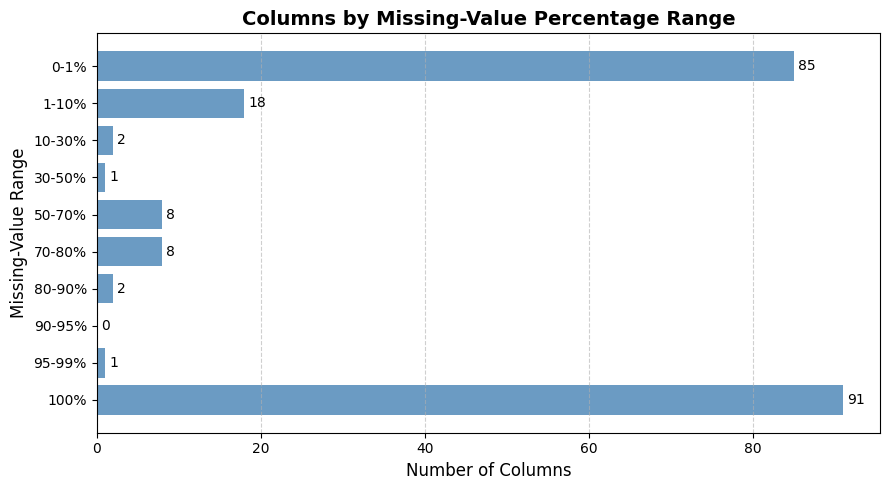

In [0]:
# Defining bins 
bins = [0, 1, 10, 30, 50, 70, 80, 90, 95, 99, 100.1]
labels = [
    "0-1%", "1-10%", "10-30%", "30-50%",
    "50-70%", "70-80%", "80-90%", "90-95%",
    "95-99%", "100%"
]

# Bin and count
null_summary["MissingRange"] = pd.cut(null_summary["Null_%"], bins=bins, labels=labels, right=False)
bucket_counts = null_summary["MissingRange"].value_counts().sort_index().reset_index()
bucket_counts.columns = ["MissingRange", "NumColumns"]

# Plot
plt.figure(figsize=(9,5))
plt.barh(bucket_counts["MissingRange"], bucket_counts["NumColumns"], color="steelblue", alpha=0.8)
plt.title("Columns by Missing-Value Percentage Range", fontsize=14, weight="bold")
plt.xlabel("Number of Columns", fontsize=12)
plt.ylabel("Missing-Value Range", fontsize=12)
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.gca().invert_yaxis()  # highest bucket on top
for i, v in enumerate(bucket_counts["NumColumns"]):
    plt.text(v + 0.5, i, str(v), va="center", fontsize=10)
plt.tight_layout()
plt.show()

The columns showing 100% null means those fields have no values in any row of your otpw dataframe. 

That usually happens when: the upstream data source didn’t populate those fields or the dataset extract/merge didn’t include the table that contains those monthly/daily aggregates.

The chart shows that 91 columns have 100 % missing values and 85 columns have less than 1 % missing.

**Action**
- Above 90% missing - Drop Columns
- Greater than 0.1 and 10 % - Impute
- 0 % - No change





In [0]:
valid_cols = null_summary[null_summary["Null_%"] <= 12]["Column"].tolist()

print(f"Number of columns retained (=10% missing): {len(valid_cols)}")
print(valid_cols)

Number of columns retained (=10% missing): 105
['HourlyPrecipitation', 'HourlySeaLevelPressure', 'HourlyAltimeterSetting', 'AIR_TIME', 'ARR_DELAY', 'ACTUAL_ELAPSED_TIME', 'ARR_DELAY_NEW', 'ARR_DELAY_GROUP', 'ARR_DEL15', 'TAXI_IN', 'WHEELS_ON', 'ARR_TIME', 'TAXI_OUT', 'WHEELS_OFF', 'DEP_DELAY_NEW', 'DEP_TIME', 'DEP_DELAY', 'DEP_DEL15', 'DEP_DELAY_GROUP', 'HourlySkyConditions', 'HourlyWetBulbTemperature', 'HourlyStationPressure', 'TAIL_NUM', 'HourlyWindDirection', 'HourlyRelativeHumidity', 'HourlyDewPointTemperature', 'HourlyWindSpeed', 'HourlyDryBulbTemperature', 'HourlyVisibility', 'REM', 'DEST_STATE_FIPS', 'SOURCE', 'LATITUDE', 'DATE', 'STATION', 'two_hours_prior_depart_UTC', 'four_hours_prior_depart_UTC', 'sched_depart_date_time_UTC', 'sched_depart_date_time', 'DEP_TIME_BLK', 'DIVERTED', 'CANCELLED', 'ARR_TIME_BLK', 'DISTANCE_GROUP', 'DISTANCE', 'CRS_ARR_TIME', 'DAY_OF_MONTH', 'ORIGIN_AIRPORT_ID', 'OP_CARRIER_FL_NUM', 'DEST_STATE_ABR', 'DEST_CITY_NAME', 'DEST', 'DEST_CITY_MARKET_ID',

In [0]:
# Filter columns that have missing values (>0 nulls)
missing_cols = null_summary[(null_summary["Null_%"] > 0) & (null_summary["Null_%"] <= 12)]

# Sort by highest missing % first
missing_cols = missing_cols.sort_values(by="Null_%", ascending=False)

# Print only the 18 columns and their missing %
print("18 Columns with Missing Values (<=12%):\n")
print(missing_cols[["Column", "Null_%"]])

print(f"\nTotal columns with missing values shown: {len(missing_cols)}")


18 Columns with Missing Values (<=12%):

                        Column  Null_%
111        HourlyPrecipitation   11.35
112     HourlySeaLevelPressure   10.95
113     HourlyAltimeterSetting    4.51
114                   AIR_TIME    3.33
115                  ARR_DELAY    3.33
116        ACTUAL_ELAPSED_TIME    3.33
117              ARR_DELAY_NEW    3.33
118            ARR_DELAY_GROUP    3.33
119                  ARR_DEL15    3.33
120                    TAXI_IN    3.16
121                  WHEELS_ON    3.16
122                   ARR_TIME    3.16
123                   TAXI_OUT    3.08
124                 WHEELS_OFF    3.08
125              DEP_DELAY_NEW    3.02
126                   DEP_TIME    3.02
127                  DEP_DELAY    3.02
128                  DEP_DEL15    3.02
129            DEP_DELAY_GROUP    3.02
130        HourlySkyConditions    2.35
131   HourlyWetBulbTemperature    0.73
132      HourlyStationPressure    0.69
133                   TAIL_NUM    0.58
134        HourlyWindDi

In [0]:
missing_cols

,Column,Null_Count,Null_%,MissingRange
111,HourlyPrecipitation,159027,11.35,10-30%
112,HourlySeaLevelPressure,153451,10.95,10-30%
113,HourlyAltimeterSetting,63215,4.51,1-10%
114,AIR_TIME,46599,3.33,1-10%
115,ARR_DELAY,46599,3.33,1-10%
116,ACTUAL_ELAPSED_TIME,46599,3.33,1-10%
117,ARR_DELAY_NEW,46599,3.33,1-10%
118,ARR_DELAY_GROUP,46599,3.33,1-10%
119,ARR_DEL15,46599,3.33,1-10%
120,TAXI_IN,44315,3.16,1-10%


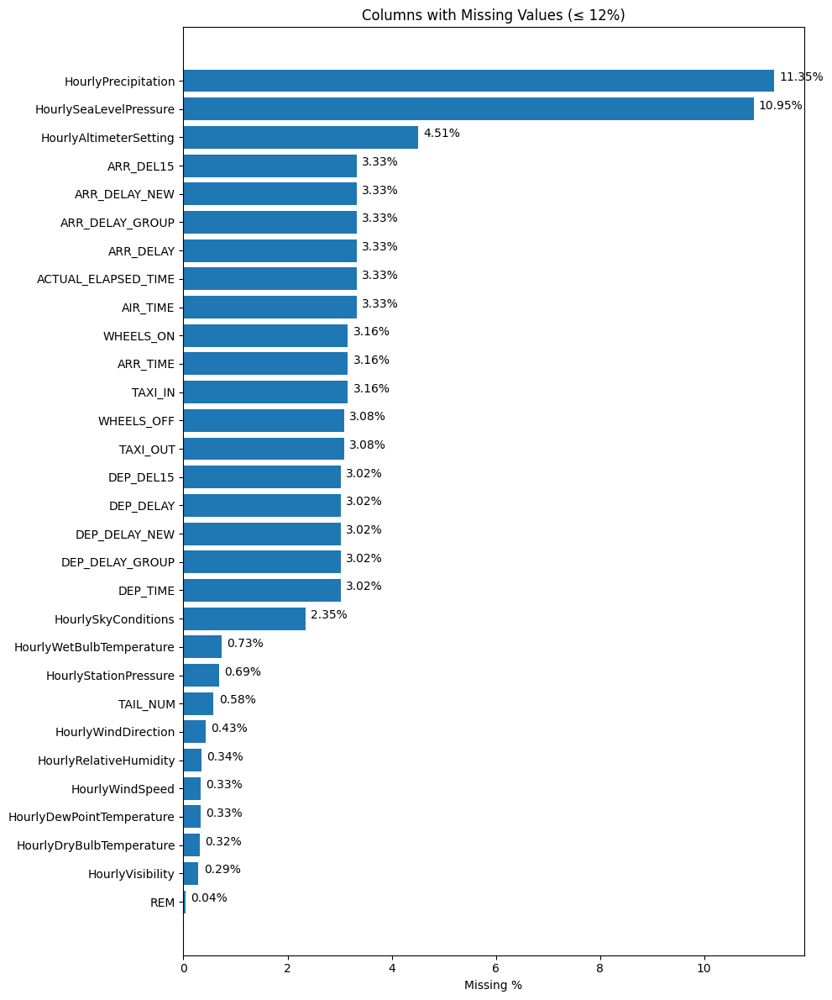

In [0]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter missing columns (<=10% and >0)
missing_cols = null_summary[(null_summary["Null_%"] > 0) & (null_summary["Null_%"] <= 12)]
missing_cols = missing_cols.sort_values(by="Null_%", ascending=True)

plt.figure(figsize=(10, 12))

plt.barh(missing_cols["Column"], missing_cols["Null_%"])
plt.xlabel("Missing %")
plt.title("Columns with Missing Values (≤ 12%)")

# Optional: show value labels
for index, value in enumerate(missing_cols["Null_%"]):
    plt.text(value + 0.1, index, f"{value:.2f}%")

plt.tight_layout()
plt.show()


In [0]:
from pyspark.sql.functions import col

# Count rows where DEP_TIME is NULL
null_dep_time_count = df_dedup.filter(col("DEP_TIME").isNull()).count()
print(f"Number of rows where DEP_TIME is null: {null_dep_time_count:,}")

# Display top 10 rows where DEP_TIME is NULL
null_dep_time_df = df_dedup.filter(col("DEP_TIME").isNull())
display(null_dep_time_df.limit(10))



Number of rows where DEP_TIME is null: 42,305


QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat

In [0]:
#null departure on specific dates:
null_dep_time_df.groupBy("FL_DATE").count().orderBy(col("count").desc()).show(15)


+----------+-----+
|   FL_DATE|count|
+----------+-----+
|2015-01-27| 2877|
|2015-03-05| 2824|
|2015-02-02| 2747|
|2015-02-01| 1941|
|2015-01-26| 1573|
|2015-03-01| 1457|
|2015-02-15| 1360|
|2015-02-23| 1315|
|2015-02-09| 1255|
|2015-03-04| 1204|
|2015-02-28| 1160|
|2015-02-25| 1160|
|2015-02-16| 1130|
|2015-02-21|  899|
|2015-03-03|  881|
+----------+-----+
only showing top 15 rows


In [0]:
# null departure on specific month:

from pyspark.sql.functions import month

null_dep_time_df.groupBy(month("FL_DATE").alias("month")).count().orderBy("month").show()


+-----+-----+
|month|count|
+-----+-----+
|    1|11642|
|    2|20036|
|    3|10627|
+-----+-----+



In [0]:
# null departure by airline
null_dep_time_df.groupBy("OP_CARRIER").count().orderBy(col("count").desc()).show(20)


+----------+-----+
|OP_CARRIER|count|
+----------+-----+
|        MQ| 7974|
|        WN| 7267|
|        EV| 6663|
|        AA| 4787|
|        US| 3213|
|        OO| 3007|
|        DL| 2824|
|        B6| 2787|
|        UA| 2530|
|        NK|  486|
|        VX|  285|
|        F9|  242|
|        AS|  204|
|        HA|   36|
+----------+-----+



In [0]:
# null departure time by origin airport

null_dep_time_df.groupBy("ORIGIN").count().orderBy(col("count").desc()).show(10)


+------+-----+
|ORIGIN|count|
+------+-----+
|   DFW| 3535|
|   ORD| 3400|
|   LGA| 2686|
|   BOS| 1992|
|   EWR| 1783|
|   ATL| 1426|
|   JFK| 1320|
|   DCA| 1222|
|   MDW|  932|
|   BWI|  805|
+------+-----+
only showing top 10 rows


In [0]:
# null departure for cancelled flights
null_dep_time_df.groupBy("CANCELLED").count().show()


+---------+-----+
|CANCELLED|count|
+---------+-----+
|      1.0|42305|
+---------+-----+



In [0]:
# what is the reason for cancellation

null_dep_time_df.groupBy("CANCELLATION_CODE").count().show()

+-----------------+-----+
|CANCELLATION_CODE|count|
+-----------------+-----+
|                B|28671|
|                C| 5890|
|                A| 7740|
|                D|    5|
+-----------------+-----+



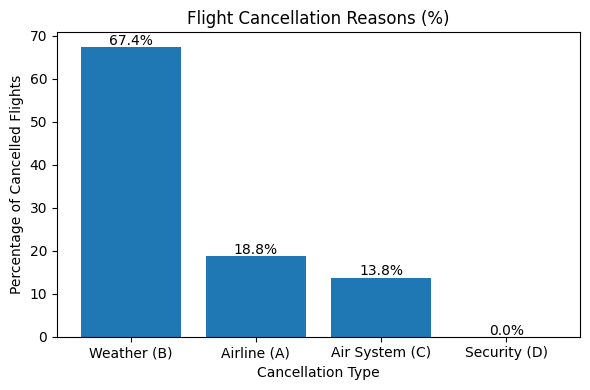

In [0]:
import matplotlib.pyplot as plt

# Get cancellation counts
cancel_df = df_dedup.groupBy("CANCELLATION_CODE").count().toPandas()

# Remove non-cancelled rows (null cancellation code)
cancel_df = cancel_df[cancel_df["CANCELLATION_CODE"].notna()]

# Map codes to readable labels
cancel_df["CANCELLATION_CODE"] = cancel_df["CANCELLATION_CODE"].replace({
    "A": "Airline (A)",
    "B": "Weather (B)",
    "C": "Air System (C)",
    "D": "Security (D)"
})

# Calculate percentage
total_cancelled = cancel_df["count"].sum()
cancel_df["percent"] = (cancel_df["count"] / total_cancelled) * 100

# Sort largest → smallest
cancel_df = cancel_df.sort_values("percent", ascending=False)

# Plot
plt.figure(figsize=(6,4))
plt.bar(cancel_df["CANCELLATION_CODE"], cancel_df["percent"])

plt.title("Flight Cancellation Reasons (%)")
plt.xlabel("Cancellation Type")
plt.ylabel("Percentage of Cancelled Flights")

# Add percentage labels
for i, v in enumerate(cancel_df["percent"]):
    plt.text(i, v + 0.5, f"{v:.1f}%", ha='center', fontsize=10)

plt.tight_layout()
plt.show()


In [0]:
from pyspark.sql.functions import col

# departure is null for cancelled flights, so dropping the columns where cancelled flights == 0

df_otpw_new = df_dedup.filter(col("CANCELLED") == 0)

print(f"Remaining rows after dropping null DEP_TIME: {df_otpw_new.count():,}")


Remaining rows after dropping null DEP_TIME: 1,357,884


In [0]:
df_otpw_new.display(5)

QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat

In [0]:
# Deleting columns with null values > 12%

df_otpw_clean = df_otpw_new.select('HourlyPrecipitation', 'HourlySeaLevelPressure', 'HourlyAltimeterSetting', 'AIR_TIME', 'ARR_DELAY', 'ACTUAL_ELAPSED_TIME', 'ARR_DELAY_NEW', 'ARR_DELAY_GROUP', 'ARR_DEL15', 'TAXI_IN', 'WHEELS_ON', 'ARR_TIME', 'TAXI_OUT', 'WHEELS_OFF', 'DEP_DELAY_NEW', 'DEP_TIME', 'DEP_DELAY', 'DEP_DEL15', 'DEP_DELAY_GROUP', 'HourlySkyConditions', 'HourlyWetBulbTemperature', 'HourlyStationPressure', 'TAIL_NUM', 'HourlyWindDirection', 'HourlyRelativeHumidity', 'HourlyDewPointTemperature', 'HourlyWindSpeed', 'HourlyDryBulbTemperature', 'HourlyVisibility', 'REM', 'DEST_STATE_FIPS', 'SOURCE', 'LATITUDE', 'DATE', 'STATION', 'two_hours_prior_depart_UTC', 'four_hours_prior_depart_UTC', 'sched_depart_date_time_UTC', 'sched_depart_date_time', 'DEP_TIME_BLK', 'DIVERTED', 'CANCELLED', 'ARR_TIME_BLK', 'DISTANCE_GROUP', 'DISTANCE', 'CRS_ARR_TIME', 'DAY_OF_MONTH', 'ORIGIN_AIRPORT_ID', 'OP_CARRIER_FL_NUM', 'DEST_STATE_ABR', 'DEST_CITY_NAME', 'DEST', 'DEST_CITY_MARKET_ID', 'DEST_AIRPORT_SEQ_ID', 'DEST_STATE_NM', 'ORIGIN_WAC', 'ORIGIN_STATE_NM', 'CRS_DEP_TIME', 'DEST_WAC', '_row_desc', 'REPORT_TYPE', 'NAME', 'ELEVATION', 'FLIGHTS', 'DEST_AIRPORT_ID', 'dest_station_id', 'dest_station_name', 'dest_airport_name', 'origin_station_dis', 'origin_airport_lon', 'origin_airport_lat', 'origin_station_lon', 'dest_station_dis', 'DAY_OF_WEEK', 'dest_airport_lon', 'ORIGIN_STATE_ABR', 'ORIGIN_CITY_NAME', 'ORIGIN', 'ORIGIN_CITY_MARKET_ID', 'ORIGIN_AIRPORT_SEQ_ID', 'OP_CARRIER', 'OP_CARRIER_AIRLINE_ID', 'OP_UNIQUE_CARRIER', 'FL_DATE', 'ORIGIN_STATE_FIPS', 'QUARTER', 'dest_airport_lat', 'dest_station_lon', 'dest_station_lat', 'dest_region', 'dest_type', 'dest_icao', 'LONGITUDE', 'CRS_ELAPSED_TIME', 'dest_iata_code', 'YEAR', 'origin_station_lat', 'origin_region', 'origin_type', 'origin_icao', 'origin_iata_code', 'origin_station_id', 'origin_station_name', 'origin_airport_name', 'MONTH')

### Checkpoint - 1 - After removing cancellation flight and null values


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_1/"

# create folder (optional)
dbutils.fs.mkdirs(out_path)

# write parquet (coalesce(1) writes one file — ok for moderate-sized DF)
df_otpw_clean.coalesce(1).write.mode("overwrite").parquet(out_path)

print("Wrote parquet to:", out_path)



Wrote parquet to: dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_1/


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_1/"

df_otpw = spark.read.parquet(out_path)
df_otpw.printSchema()

display(df_otpw.limit(5))

root
 |-- HourlyPrecipitation: string (nullable = true)
 |-- HourlySeaLevelPressure: string (nullable = true)
 |-- HourlyAltimeterSetting: string (nullable = true)
 |-- AIR_TIME: string (nullable = true)
 |-- ARR_DELAY: string (nullable = true)
 |-- ACTUAL_ELAPSED_TIME: string (nullable = true)
 |-- ARR_DELAY_NEW: string (nullable = true)
 |-- ARR_DELAY_GROUP: string (nullable = true)
 |-- ARR_DEL15: string (nullable = true)
 |-- TAXI_IN: string (nullable = true)
 |-- WHEELS_ON: string (nullable = true)
 |-- ARR_TIME: string (nullable = true)
 |-- TAXI_OUT: string (nullable = true)
 |-- WHEELS_OFF: string (nullable = true)
 |-- DEP_DELAY_NEW: string (nullable = true)
 |-- DEP_TIME: string (nullable = true)
 |-- DEP_DELAY: string (nullable = true)
 |-- DEP_DEL15: string (nullable = true)
 |-- DEP_DELAY_GROUP: string (nullable = true)
 |-- HourlySkyConditions: string (nullable = true)
 |-- HourlyWetBulbTemperature: string (nullable = true)
 |-- HourlyStationPressure: string (nullable = t

HourlyPrecipitation,HourlySeaLevelPressure,HourlyAltimeterSetting,AIR_TIME,ARR_DELAY,ACTUAL_ELAPSED_TIME,ARR_DELAY_NEW,ARR_DELAY_GROUP,ARR_DEL15,TAXI_IN,WHEELS_ON,ARR_TIME,TAXI_OUT,WHEELS_OFF,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DEL15,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,REM,DEST_STATE_FIPS,SOURCE,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DIVERTED,CANCELLED,ARR_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,DEST_STATE_ABR,DEST_CITY_NAME,DEST,DEST_CITY_MARKET_ID,DEST_AIRPORT_SEQ_ID,DEST_STATE_NM,ORIGIN_WAC,ORIGIN_STATE_NM,CRS_DEP_TIME,DEST_WAC,_row_desc,REPORT_TYPE,NAME,ELEVATION,FLIGHTS,DEST_AIRPORT_ID,dest_station_id,dest_station_name,dest_airport_name,origin_station_dis,origin_airport_lon,origin_airport_lat,origin_station_lon,dest_station_dis,DAY_OF_WEEK,dest_airport_lon,ORIGIN_STATE_ABR,ORIGIN_CITY_NAME,ORIGIN,ORIGIN_CITY_MARKET_ID,ORIGIN_AIRPORT_SEQ_ID,OP_CARRIER,OP_CARRIER_AIRLINE_ID,OP_UNIQUE_CARRIER,FL_DATE,ORIGIN_STATE_FIPS,QUARTER,dest_airport_lat,dest_station_lon,dest_station_lat,dest_region,dest_type,dest_icao,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,YEAR,origin_station_lat,origin_region,origin_type,origin_icao,origin_iata_code,origin_station_id,origin_station_name,origin_airport_name,MONTH
0.00,30.14,30.14,275.0,-15.0,294.0,0.0,-1,0.0,5.0,539,544,14.0,2204,0.0,2150,0.0,0.0,0,CLR:00,40,29.79,N796AA,000,74,35,0,43,10.00,MET09601/02/15 01:53:02 METAR KLAX 020953Z 00000KT 10SM CLR 06/02 A3014 RMK AO2 SLP206 T00610017 (RPA),36,7,33.938,2015-01-02T01:53:00,72295023174,2015-01-02T03:50:00,2015-01-02T01:50:00,2015-01-02T05:50:00,2015-01-01T21:50:00,2100-2159,0.0,0.0,0001-0559,10,2475.0,559,1,12892,10,NY,"New York, NY",JFK,31703,1247802,New York,91,California,2150,22,1,FM-15,"LOS ANGELES INTERNATIONAL AIRPORT, CA US",29.6,1.0,12478,74486094789,JOHN F KENNEDY INTERNATIONAL,John F Kennedy International Airport,0.0,-118.4,33.9,-118.4,0.0,4,-73.8,CA,"Los Angeles, CA",LAX,32575,1289203,AA,19805,AA,2015-01-01,6,1,40.6,-73.8,40.6,US-NY,large_airport,KJFK,-118.3888,309.0,JFK,2015,33.9,US-CA,large_airport,KLAX,LAX,72295023174,LOS ANGELES INTERNATIONAL AIR,Los Angeles International Airport,1
0.00,30.13,30.13,274.0,7.0,289.0,7.0,0,0.0,6.0,620,626,9.0,2246,0.0,2237,0.0,0.0,0,CLR:00,39,29.78,N594JB,000,76,35,0,42,10.00,MET09601/02/15 02:53:02 METAR KLAX 021053Z 00000KT 10SM CLR 06/02 A3013 RMK AO2 SLP203 T00560017 (RPA),12,7,33.938,2015-01-02T02:53:00,72295023174,2015-01-02T04:37:00,2015-01-02T02:37:00,2015-01-02T06:37:00,2015-01-01T22:37:00,2200-2259,0.0,0.0,0600-0659,10,2342.0,619,1,12892,100,FL,"Fort Lauderdale, FL",FLL,32467,1169703,Florida,91,California,2237,33,1,FM-15,"LOS ANGELES INTERNATIONAL AIRPORT, CA US",29.6,1.0,11697,74783012849,FT LAUD/HOLLYWOOD INTL APT,Fort Lauderdale Hollywood International Airport,0.0,-118.4,33.9,-118.4,0.0,4,-80.2,CA,"Los Angeles, CA",LAX,32575,1289203,B6,20409,B6,2015-01-01,6,1,26.1,-80.2,26.1,US-FL,large_airport,KFLL,-118.3888,282.0,FLL,2015,33.9,US-CA,large_airport,KLAX,LAX,72295023174,LOS ANGELES INTERNATIONAL AIR,Los Angeles International Airport,1
T,29.96,29.93,58.0,-14.0,75.0,0.0,-1,0.0,9.0,2146,2155,8.0,2048,0.0,2040,-5.0,0.0,-1,FEW:02 25 OVC:08 30,27,29.18,N267JB,260,64,20,20,31,9.00,MET14401/01/15 21:54:02 METAR KBUF 020254Z 26017G32KT 9SM -SN FEW025 OVC030 M01/M07 A2993 RMK AO2 PK WND 26034/0216 SLP146 P0000 60000 T10061067 53023,36,7,42.93997,2015-01-01T21:54:00,72528014733,2015-01-01T23:45:00,2015-01-01T21:45:00,2015-01-02T01:45:00,2015-01-01T20:45:00,2000-2059,0.0,0.0,2200-2259,2,301.0,2209,1,10792,1001,NY,"New York, NY",JFK,31703,1247802,New York,22,New York,2045,22,1,FM-15,"BUFFALO NIAGARA INTERNATIONAL, NY US",218.2,1.0,12478,74486094789,JOHN F KENNEDY INTERNAT

### **_Drop Data Leakage Columns_**


In [0]:
leakage_cols = [
    "ARR_DELAY", "ARR_DELAY_NEW", "ARR_DEL15",
    "TAXI_IN", "TAXI_OUT", "WHEELS_ON", "WHEELS_OFF",
    "ARR_TIME"
]

#"DEP_DELAY", "DEP_DELAY_NEW", "DEP_DEL15", "DEP_TIME",

# Only keep those that exist in dataset
leakage_cols = [c for c in leakage_cols if c in df_otpw.columns]

print("Leakage columns used for correlation:", leakage_cols)


Leakage columns used for correlation: ['ARR_DELAY', 'ARR_DELAY_NEW', 'ARR_DEL15', 'TAXI_IN', 'TAXI_OUT', 'WHEELS_ON', 'WHEELS_OFF', 'ARR_TIME']


In [0]:
import pandas as pd

df_corr = df_otpw.select(*leakage_cols).toPandas()
corr_matrix = df_corr.corr()

corr_matrix


/root/.ipykernel/1691/command-7250714370588829-1131169790:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df_corr.corr()


""


In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
if corr_matrix.size > 0: sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f") else: print('Correlation matrix is empty, skipping heatmap.')
plt.title("Correlation Between Data Leakage Columns")
plt.show()


  File <command-7250714370588830>, line 5
    if corr_matrix.size > 0: sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f") else: print('Correlation matrix is empty, skipping heatmap.')
                                                                                              ^
SyntaxError: invalid syntax


In [0]:
from pyspark.sql.functions import col

drop_cols = [
    "ARR_DELAY", "ARR_DELAY_NEW", "ARR_DELAY_GROUP", "ARR_DEL15",
    "ARR_TIME", "WHEELS_ON", "TAXI_IN", "DEP_DEL15", "TAXI_OUT",  "WHEELS_OFF"
]

df_otpw_clean = df_otpw.drop(*drop_cols)

print("Remaining columns:", len(df_otpw_clean.columns))



Remaining columns: 95


In [0]:
# new df with only above columns:
total_rows = df_otpw_clean.count()

# Compute null count and percentage per column
null_summary = df_otpw_clean.select([
    _sum(when(col(c).isNull(), 1).otherwise(0)).alias(c)
    for c in df_otpw_clean.columns
]).toPandas().T.reset_index()

null_summary.columns = ["Column", "Null_Count"] 
null_summary["Null_%"] = (null_summary["Null_Count"] / total_rows * 100).round(2)

# Sort by highest missing percentage
null_summary = null_summary.sort_values(by="Null_%", ascending=False).reset_index(drop=True)

display(null_summary)


Column,Null_Count,Null_%
HourlyPrecipitation,152441,11.23
HourlySeaLevelPressure,142905,10.52
HourlyAltimeterSetting,60658,4.47
HourlySkyConditions,31804,2.34
HourlyWetBulbTemperature,9767,0.72
HourlyStationPressure,9161,0.67
HourlyWindDirection,5876,0.43
HourlyRelativeHumidity,4536,0.33
HourlyWindSpeed,4480,0.33
HourlyDewPointTemperature,4392,0.32


In [0]:
# Deleting all other columns after review

drop_cols = [
 "OP_UNIQUE_CARRIER","OP_CARRIER_AIRLINE_ID","OP_CARRIER",
 "ORIGIN_AIRPORT_SEQ_ID","ORIGIN_CITY_MARKET_ID","ORIGIN_CITY_NAME",
 "ORIGIN_STATE_ABR","ORIGIN_STATE_FIPS","ORIGIN_STATE_NM","ORIGIN_WAC",
 "DEST_AIRPORT_SEQ_ID","DEST_CITY_MARKET_ID","DEST","DEST_CITY_NAME",
 "DEST_STATE_ABR","DEST_STATE_FIPS","DEST_STATE_NM","DEST_WAC",
 "TAXI_OUT","WHEELS_OFF","WHEELS_ON","TAXI_IN",
 "ARR_TIME","ARR_DELAY","ARR_DELAY_NEW","ARR_DEL15","ARR_DELAY_GROUP",
 "ARR_TIME_BLK","CANCELLED","CANCELLATION_CODE","DIVERTED",
 "ACTUAL_ELAPSED_TIME","AIR_TIME","FLIGHTS",
 "CARRIER_DELAY","WEATHER_DELAY","NAS_DELAY","SECURITY_DELAY",
 "LATE_AIRCRAFT_DELAY","FIRST_DEP_TIME","TOTAL_ADD_GTIME","LONGEST_ADD_GTIME","YEAR",
 "origin_airport_name","origin_station_name","origin_station_id",
 "origin_icao",
 "origin_station_lat","origin_station_lon","origin_station_dis",
 "dest_airport_name","dest_station_name","dest_station_id",
 "dest_icao","dest_station_lat","dest_station_lon","dest_station_dis",
 "REPORT_TYPE","SOURCE",
 "REM"
]

df_otpw = df_otpw_clean.drop(*drop_cols)


### Check Point - 2 - Remove Data Leakage columns and removed the columns not needed - Save Data


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_2/"

# create folder (optional)
dbutils.fs.mkdirs(out_path)

# write parquet (coalesce(1) writes one file — ok for moderate-sized DF)
df_otpw.coalesce(1).write.mode("overwrite").parquet(out_path)

print("Wrote parquet to:", out_path)



---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-7172902687414987>, line 7
      4 dbutils.fs.mkdirs(out_path)
      6 # write parquet (coalesce(1) writes one file — ok for moderate-sized DF)
----> 7 df_otpw.coalesce(1).write.mode("overwrite").parquet(out_path)
      9 print("Wrote parquet to:", out_path)

NameError: name 'df_otpw' is not defined

# Read Data

In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_2/"

df_otpw = spark.read.parquet(out_path)
df_otpw.printSchema()

display(df_otpw.limit(5))

root
 |-- HourlyPrecipitation: string (nullable = true)
 |-- HourlySeaLevelPressure: string (nullable = true)
 |-- HourlyAltimeterSetting: string (nullable = true)
 |-- DEP_DELAY_NEW: string (nullable = true)
 |-- DEP_TIME: string (nullable = true)
 |-- DEP_DELAY: string (nullable = true)
 |-- DEP_DELAY_GROUP: string (nullable = true)
 |-- HourlySkyConditions: string (nullable = true)
 |-- HourlyWetBulbTemperature: string (nullable = true)
 |-- HourlyStationPressure: string (nullable = true)
 |-- TAIL_NUM: string (nullable = true)
 |-- HourlyWindDirection: string (nullable = true)
 |-- HourlyRelativeHumidity: string (nullable = true)
 |-- HourlyDewPointTemperature: string (nullable = true)
 |-- HourlyWindSpeed: string (nullable = true)
 |-- HourlyDryBulbTemperature: string (nullable = true)
 |-- HourlyVisibility: string (nullable = true)
 |-- LATITUDE: string (nullable = true)
 |-- DATE: string (nullable = true)
 |-- STATION: string (nullable = true)
 |-- two_hours_prior_depart_UTC: st

HourlyPrecipitation,HourlySeaLevelPressure,HourlyAltimeterSetting,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,ORIGIN,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH
0.00,30.14,30.14,0.0,2150,0.0,0,CLR:00,40,29.79,N796AA,000,74,35,0,43,10.00,33.938,2015-01-02T01:53:00,72295023174,2015-01-02T03:50:00,2015-01-02T01:50:00,2015-01-02T05:50:00,2015-01-01T21:50:00,2100-2159,10,2475.0,559,1,12892,10,2150,1,"LOS ANGELES INTERNATIONAL AIRPORT, CA US",29.6,12478,-118.4,33.9,4,-73.8,LAX,2015-01-01,1,40.6,US-NY,large_airport,-118.3888,309.0,JFK,US-CA,large_airport,LAX,1
0.00,30.13,30.13,0.0,2237,0.0,0,CLR:00,39,29.78,N594JB,000,76,35,0,42,10.00,33.938,2015-01-02T02:53:00,72295023174,2015-01-02T04:37:00,2015-01-02T02:37:00,2015-01-02T06:37:00,2015-01-01T22:37:00,2200-2259,10,2342.0,619,1,12892,100,2237,1,"LOS ANGELES INTERNATIONAL AIRPORT, CA US",29.6,11697,-118.4,33.9,4,-80.2,LAX,2015-01-01,1,26.1,US-FL,large_airport,-118.3888,282.0,FLL,US-CA,large_airport,LAX,1
T,29.96,29.93,0.0,2040,-5.0,-1,FEW:02 25 OVC:08 30,27,29.18,N267JB,260,64,20,20,31,9.00,42.93997,2015-01-01T21:54:00,72528014733,2015-01-01T23:45:00,2015-01-01T21:45:00,2015-01-02T01:45:00,2015-01-01T20:45:00,2000-2059,2,301.0,2209,1,10792,1001,2045,1,"BUFFALO NIAGARA INTERNATIONAL, NY US",218.2,12478,-78.7,42.9,4,-73.8,BUF,2015-01-01,1,40.6,US-NY,large_airport,-78.73615,84.0,JFK,US-NY,large_airport,BUF,1
0.01,null,30.22,76.0,1941,76.0,5,SCT:04 6 OVC:08 19,35,29.57,N4WTAA,030,93,34,7,36,9.00,32.8978,2015-01-01T20:38:00,72259003927,2015-01-01T22:25:00,2015-01-01T20:25:00,2015-01-02T00:25:00,2015-01-01T18:25:00,1800-1859,4,813.0,1945,1,11298,1001,1825,1,"DAL FTW WSCMO AIRPORT, TX US",170.7,15376,-97.0,32.9,4,-111.0,DFW,2015-01-01,1,32.1,US-AZ,large_airport,-97.0189,140.0,TUS,US-TX,large_airport,DFW,1
0.00,30.29,30.28,5.0,1720,5.0,0,BKN:07 70 BKN:07 130 BKN:07 200,42,29.18,N230WN,000,43,30,0,52,10.00,33.6301,2015-01-01T18:52:00,72219013874,2015-01-01T20:15:00,2015-01-01T18:15:00,2015-01-01T22:15:00,2015-01-01T17:15:00,1700-1759,3,581.0,1905,1,10397,1003,1715,1,"ATLANTA HARTSFIELD JACKSON INTERNATIONAL AIRPORT, GA US",307.8,11697,-84.4,33.6,4,-80.2,ATL,2015-01-01,1,26.1,US-FL,large_airport,-84.4418,110.0,FLL,US-GA,large_airport,ATL,1


In [0]:

# Duplicates - Done
# Save to the file system-Done

# remove these columns - ARR_DELAY,  ARR_DELAY_NEW, ARR_DEL15,WHEELS_OFF", "WHEELS_ON","ARR_DELAY_GROUP", "ACTUAL_ELAPSED_TIME - Done


#Impute below 3 categories
#HourlyAltimeterSetting, HourlyStationPressure, HourlyWetBulbTemperature, HourlyDewPointTemperature, HourlyDryBulbTemperature, HourlyRelativeHumidity, HourlyWindSpeed, HourlyWindDirection, HourlyVisibility




#ARR_DELAY, ARR_DELAY_NEW, ARR_DEL15, ACTUAL_ELAPSED_TIME, AIR_TIME, TAXI_IN, TAXI_OUT, WHEELS_ON, WHEELS_OFF, ARR_TIME

# remove the delay related columns


#HourlySkyConditions, REM, TAIL_NUM maybe categorical


# Combine Holiday Data
# +_ 3 days


# Do the same analysis for one year data.

# Save the final data in dbfs file system

# One hot encoding

# Histograms for selected features


### Imputation Analysis:


In [0]:
display(df_otpw.select("HourlyPrecipitation").summary())


summary,HourlyPrecipitation
count,1205443
mean,0.0023059179999174247
stddev,0.01594244839150424
min,0.00
25%,0.0
50%,0.0
75%,0.0
max,T


In [0]:
display(df_plot)

# multiple rows for the same hour because your dataset contains multiple weather station readings within the same hour — same airport, same hour, but different exact timestamps (minutes & seconds).

DATE,HourlyPrecipitation,hour
2015-01-01T09:53:00,0.00,9
2015-01-01T17:53:00,0.00,17
2015-01-01T16:53:00,0.00,16
2015-01-01T07:53:00,0.00,7
2015-01-01T11:53:00,0.00,11
2015-01-01T19:53:00,0.00,19
2015-01-01T12:53:00,0.00,12
2015-01-01T15:17:00,0.03,15
2015-01-01T12:53:00,0.00,12
2015-01-01T13:53:00,0.00,13


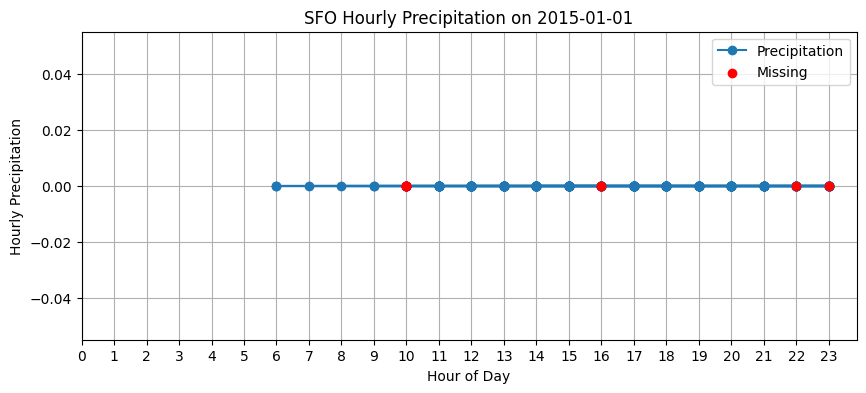

In [0]:
import pyspark.sql.functions as F
import pandas as pd
import matplotlib.pyplot as plt

# Filter for SFO + Jan 1 2015
df_plot = df_otpw.filter(
    (F.col("ORIGIN") == "SFO") &
    (F.to_date(F.col("Date")) == "2015-01-01")
).select("DATE", "HourlyPrecipitation")

# Convert timestamp to hour
df_plot = df_plot.withColumn("hour", F.hour(F.col("Date")))

# Convert to pandas for plotting
pdf = df_plot.toPandas()

# Ensure numeric precipitation
pdf["HourlyPrecipitation"] = pd.to_numeric(pdf["HourlyPrecipitation"], errors="coerce")

# Plot
plt.figure(figsize=(10,4))
plt.plot(pdf["hour"], pdf["HourlyPrecipitation"], marker="o", label="Precipitation")
plt.scatter(pdf[pdf["HourlyPrecipitation"].isna()]["hour"], 
            [0]*pdf["HourlyPrecipitation"].isna().sum(), 
            color="red", label="Missing", zorder=3)

plt.title("SFO Hourly Precipitation on 2015-01-01")
plt.xlabel("Hour of Day")
plt.ylabel("Hourly Precipitation")
plt.xticks(range(0,24))
plt.grid(True)
plt.legend()
plt.show()


In [0]:
import pyspark.sql.functions as F
import pandas as pd
import matplotlib.pyplot as plt

#filter data for DFW + Jan 1 2015
df_plot = df_otpw.filter(
    (F.col("ORIGIN") == "DFW") &
    (F.to_date(F.col("Date")) == "2015-01-01")
).select("DATE", "HourlyPrecipitation")



In [0]:
display(df_plot)

DATE,HourlyPrecipitation
2015-01-01T20:38:00,0.01
2015-01-01T18:25:00,0.01
2015-01-01T20:51:00,null
2015-01-01T12:00:00,null
2015-01-01T19:53:00,0.03
2015-01-01T16:26:00,0.01
2015-01-01T23:53:00,T
2015-01-01T16:26:00,0.01
2015-01-01T19:12:00,0.01
2015-01-01T17:53:00,0.02


+-----+-------------+-------------+------------------+
|month|total_records|missing_count|       missing_pct|
+-----+-------------+-------------+------------------+
|    1|       457067|        52684| 11.52653768484708|
|    2|       408159|        45551|11.160111623166461|
|    3|       492658|        54206|11.002764595317645|
+-----+-------------+-------------+------------------+



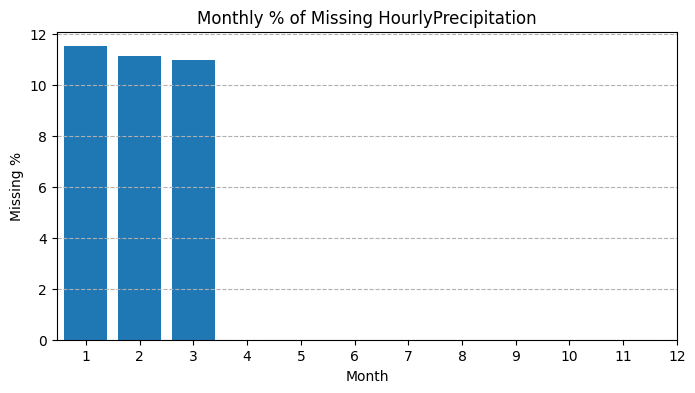

In [0]:
# Extract month from Date
df_missing = df_otpw.withColumn("month", F.month("Date"))

# Flag missing precipitation
df_missing = df_missing.withColumn(
    "is_missing", F.col("HourlyPrecipitation").isNull()
)

# Aggregate by month
df_month = df_missing.groupBy("month").agg(
    F.count("*").alias("total_records"),
    F.sum(F.col("is_missing").cast("int")).alias("missing_count")
)

df_month = df_month.withColumn(
    "missing_pct", (F.col("missing_count")/F.col("total_records")) * 100
).orderBy("month")

df_month.show()

pdf_month = df_month.toPandas()

plt.figure(figsize=(8,4))
plt.bar(pdf_month["month"], pdf_month["missing_pct"])
plt.title("Monthly % of Missing HourlyPrecipitation")
plt.xlabel("Month")
plt.ylabel("Missing %")
plt.xticks(range(1,13))
plt.grid(axis='y', linestyle='--')
plt.show()


In [0]:
display(df_otpw)

HourlyPrecipitation,HourlyAltimeterSetting,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH
0.01,30.22,76.0,1941,76.0,5,SCT:04 6 OVC:08 19,35,29.57,N4WTAA,030,93,34,7,36,9.00,32.8978,2015-01-01T20:38:00,72259003927,2015-01-01T22:25:00,2015-01-01T20:25:00,2015-01-02T00:25:00,2015-01-01T18:25:00,1800-1859,4,813.0,1945,1,11298,1001,1825,1,"DAL FTW WSCMO AIRPORT, TX US",170.7,15376,-97.0,32.9,4,-111.0,2015-01-01,1,32.1,US-AZ,large_airport,-97.0189,140.0,TUS,US-TX,large_airport,DFW,1
0.00,30.28,5.0,1720,5.0,0,BKN:07 70 BKN:07 130 BKN:07 200,42,29.18,N230WN,000,43,30,0,52,10.00,33.6301,2015-01-01T18:52:00,72219013874,2015-01-01T20:15:00,2015-01-01T18:15:00,2015-01-01T22:15:00,2015-01-01T17:15:00,1700-1759,3,581.0,1905,1,10397,1003,1715,1,"ATLANTA HARTSFIELD JACKSON INTERNATIONAL AIRPORT, GA US",307.8,11697,-84.4,33.6,4,-80.2,2015-01-01,1,26.1,US-FL,large_airport,-84.4418,110.0,FLL,US-GA,large_airport,ATL,1
0.00,30.14,0.0,1352,-8.0,-1,CLR:00,46,30.10,N796JB,000,64,40,0,52,10.00,33.8116,2015-01-01T18:53:00,72297023129,2015-01-01T20:00:00,2015-01-01T18:00:00,2015-01-01T22:00:00,2015-01-01T14:00:00,1400-1459,4,965.0,1643,1,12954,1006,1400,1,"LONG BEACH DAUGHERTY AIRPORT, CA US",9.4,14747,-118.1,33.8,4,-122.3,2015-01-01,1,47.4,US-WA,large_airport,-118.1463,163.0,SEA,US-CA,medium_airport,LGB,1
0.00,29.90,30.0,1235,30.0,2,FEW:02 130 SCT:04 170 BKN:07 250,24,29.65,N340LV,VRB,35,6,11,31,10.00,42.92963,2015-01-01T13:53:00,74394514710,2015-01-01T15:05:00,2015-01-01T13:05:00,2015-01-01T17:05:00,2015-01-01T12:05:00,1200-1259,2,377.0,1340,1,13296,1008,1205,1,"MANCHESTER AIRPORT, NH US",67.4,10821,-71.4,42.9,4,-76.7,2015-01-01,1,39.2,US-MD,large_airport,-71.43566,95.0,BWI,US-NH,large_airport,MHT,1
0.00,30.12,9.0,1104,9.0,0,FEW:02 20,47,29.77,N655WN,270,51,37,8,55,10.00,33.938,2015-01-01T15:53:00,72295023174,2015-01-01T16:55:00,2015-01-01T14:55:00,2015-01-01T18:55:00,2015-01-01T10:55:00,1000-1059,2,337.0,1210,1,12892,1009,1055,1,"LOS ANGELES INTERNATIONAL AIRPORT, CA US",29.6,14771,-118.4,33.9,4,-122.4,2015-01-01,1,37.6,US-CA,large_airport,-118.3888,75.0,SFO,US-CA,large_airport,LAX,1
0.00,30.07,68.0,2148,68.0,4,BKN:07 250,29,29.90,N705SW,000,50,18,0,35,10.00,39.1733,2015-01-01T21:54:00,72406093721,2015-01-01T23:40:00,2015-01-01T21:40:00,2015-01-02T01:40:00,2015-01-01T20:40:00,2000-2059,2,314.0,2155,1,10821,101,2040,1,"BALTIMORE WASHINGTON INTERNATIONAL AIRPORT, MD US",47.5,11042,-76.7,39.2,4,-81.9,2015-01-01,1,41.4,US-OH,large_airport,-76.684,75.0,CLE,US-MD,large_airport,BWI,1
0.00,30.02,0.0,1807,-3.0,-1,FEW:02 250,31,30.00,N775JB,220,43,17,22,38,10.00,40.63915,2015-01-01T19:51:00,74486094789,2015-01-01T21:10:00,2015-01-01T19:10:00,2015-01-01T23:10:00,2015-01-01T18:10:00,1800-1859,10,2465.0,2131,1,12478,1013,1810,1,"JFK INTERNATIONAL AIRPORT, NY US",3.4,12954,-73.8,40.6,4,-118.1,2015-01-01,1,33.8,US-CA,medium_airport,-73.76401,381.0,LGB,US-NY,large_airport,JFK,1
0.00,30.17,0.0,1545,-5.0,-1,BKN:07 7 BKN:07 13 OVC:08 37,69,30.06,N3AXAA,020,90,68,9,71,10.00,28.4339,2015-01-01T16:53:00,72205012815,2015-01-01T18:50:00,2015-01-01T16:50:00,2015-01-01T20:50:00,2015-01-01T15:50:00,1500-1559,4,944.0,1825,1,13204,1016,1550,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,12478,-81.3,28.4,4,-73.8,2015-01-01,1,40.6,US-NY,large_airport,-81.325,155.0,JFK,US-FL,large_airport,MCO,1
0.0

- Missing hourly precipitation values were imputed using linear interpolation (mean of previous and next valid hourly measurements). When interpolation was not possible (first/last hour of the day), missing values were imputed as 0

In [0]:
from pyspark.sql import functions as F
from pyspark.sql.window import Window

# 1) Prepare numeric precipitation column and keep a missing flag
df = df_otpw.withColumn(
    "HourlyPrecipitation_num",
    F.when(F.col("HourlyPrecipitation") == "T", F.lit(0.01)) \
     .otherwise(F.col("HourlyPrecipitation").cast("double"))
)

df = df.withColumn("HourlyPrecipitation_was_missing", F.col("HourlyPrecipitation_num").isNull().cast("int"))

# 2) Define windows for forward (prev non-null) and backward (next non-null) lookups
w_ffill = Window.partitionBy("ORIGIN").orderBy(F.to_timestamp("DATE")).rowsBetween(Window.unboundedPreceding, 0)
w_bfill = Window.partitionBy("ORIGIN").orderBy(F.to_timestamp("DATE")).rowsBetween(0, Window.unboundedFollowing)

# 3) Compute previous non-null and next non-null (within same ORIGIN, ordered by time)
df = df.withColumn("precip_prev", F.last("HourlyPrecipitation_num", ignorenulls=True).over(w_ffill))
df = df.withColumn("precip_next", F.first("HourlyPrecipitation_num", ignorenulls=True).over(w_bfill))

# 4) Linear interpolation: mean(prev,next) ; fallback prev ; fallback next ; final fallback 0.0
df = df.withColumn(
    "HourlyPrecipitation_imputed",
    F.coalesce(
        F.col("HourlyPrecipitation_num"),                                # keep original if present
        ((F.col("precip_prev") + F.col("precip_next")) / 2),             # interpolation
        F.col("precip_prev"),                                            # forward-fill
        F.col("precip_next"),                                            # backward-fill
        F.lit(0.0)                                                       # final fallback -> no rain
    )
)

# 5) Replace any remaining NULLs (defensive) and overwrite original column
df = df.withColumn("HourlyPrecipitation_imputed", F.col("HourlyPrecipitation_imputed").cast("double"))
df = df.withColumn("HourlyPrecipitation", F.col("HourlyPrecipitation_imputed"))

# 6) Cleanup helper columns
df = df.drop("HourlyPrecipitation_num", "precip_prev", "precip_next", "HourlyPrecipitation_imputed")

# 7) Sanity check: ensure no nulls remain
remaining_nulls = df.filter(F.col("HourlyPrecipitation").isNull()).count()
print("Remaining NULLs after imputation:", remaining_nulls)




Remaining NULLs after imputation: 0


In [0]:
display(df.limit(5))

HourlyPrecipitation,HourlySeaLevelPressure,HourlyAltimeterSetting,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,ORIGIN,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH,HourlyPrecipitation_was_missing
0.02,null,29.99,8.0,1723,8.0,0,null,null,null,N764AS,160,76,34,20,41,10.00,51.88333,2015-01-01T23:16:00,70454025704,2015-01-02T01:15:00,2015-01-01T23:15:00,2015-01-02T03:15:00,2015-01-01T17:15:00,1700-1759,5,1192.0,2059,1,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,4,-150.0,ADK,2015-01-01,1,61.2,US-AK,large_airport,-176.65,164.0,ANC,US-AK,medium_airport,ADK,1,1
0.02,null,29.74,0.0,1706,-9.0,-1,null,null,null,N797AS,120,81,34,17,39,6.00,51.88333,2015-01-04T23:16:00,70454025704,2015-01-05T01:15:00,2015-01-04T23:15:00,2015-01-05T03:15:00,2015-01-04T17:15:00,1700-1759,5,1192.0,2059,4,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,7,-150.0,ADK,2015-01-04,1,61.2,US-AK,large_airport,-176.65,164.0,ANC,US-AK,medium_airport,ADK,1,0
0.015,null,29.69,0.0,1659,-16.0,-2,null,null,null,N764AS,340,86,27,5,30,10.00,51.88333,2015-01-08T23:16:00,70454025704,2015-01-09T01:15:00,2015-01-08T23:15:00,2015-01-09T03:15:00,2015-01-08T17:15:00,1700-1759,5,1192.0,2059,8,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,4,-150.0,ADK,2015-01-08,1,61.2,US-AK,large_airport,-176.65,164.0,ANC,US-AK,medium_airport,ADK,1,1
0.015,null,29.16,0.0,1649,-26.0,-2,null,null,null,N713AS,150,75,28,8,36,10.00,51.88333,2015-01-11T23:16:00,70454025704,2015-01-12T01:15:00,2015-01-11T23:15:00,2015-01-12T03:15:00,2015-01-11T17:15:00,1700-1759,5,1192.0,2100,11,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,7,-150.0,ADK,2015-01-11,1,61.2,US-AK,large_airport,-176.65,165.0,ANC,US-AK,medium_airport,ADK,1,1
0.015,null,29.41,0.0,1640,-35.0,-2,null,null,null,N799AS,140,75,28,11,36,10.00,51.88333,2015-01-18T23:16:00,70454025704,2015-01-19T01:15:00,2015-01-18T23:15:00,2015-01-19T03:15:00,2015-01-18T17:15:00,1700-1759,5,1192.0,2100,18,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,7,-150.0,ADK,2015-01-18,1,61.2,US-AK,large_airport,-176.65,165.0,ANC,US-AK,medium_airport,ADK,1,1


In [0]:
from pyspark.sql import functions as F

df_rain = df_otpw.filter(F.col("HourlyPrecipitation") > 0.0)

print("Total rows where precipitation > 0:", df_rain.count())

# Show 10 sample rows
display(df_rain.orderBy("DATE").limit(30))



Total rows where precipitation > 0: 65871


HourlyPrecipitation,HourlyAltimeterSetting,ACTUAL_ELAPSED_TIME,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,REM,DEST_STATE_FIPS,SOURCE,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DIVERTED,CANCELLED,ARR_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,DEST_STATE_ABR,DEST_CITY_NAME,DEST,DEST_CITY_MARKET_ID,DEST_AIRPORT_SEQ_ID,DEST_STATE_NM,ORIGIN_WAC,ORIGIN_STATE_NM,CRS_DEP_TIME,DEST_WAC,_row_desc,REPORT_TYPE,NAME,ELEVATION,FLIGHTS,DEST_AIRPORT_ID,dest_station_id,dest_station_name,dest_airport_name,origin_station_dis,origin_airport_lon,origin_airport_lat,origin_station_lon,dest_station_dis,DAY_OF_WEEK,dest_airport_lon,ORIGIN_STATE_ABR,ORIGIN_CITY_NAME,ORIGIN,ORIGIN_CITY_MARKET_ID,ORIGIN_AIRPORT_SEQ_ID,OP_CARRIER,OP_CARRIER_AIRLINE_ID,OP_UNIQUE_CARRIER,FL_DATE,ORIGIN_STATE_FIPS,QUARTER,dest_airport_lat,dest_station_lon,dest_station_lat,dest_region,dest_type,dest_icao,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,YEAR,origin_station_lat,origin_region,origin_type,origin_icao,origin_iata_code,origin_station_id,origin_station_name,origin_airport_name,MONTH
0.01,30.16,177.0,0.0,551,-2.0,-1,FEW:02 22 BKN:07 38 BKN:07 80,70,30.15,N656JB,000,94,69,0,71,8.00,MET15801/01/15 06:53:02 METAR KFLL 011153Z 00000KT 8SM -RA FEW022 BKN038 BKN080 22/21 A3016 RMK AO2 RAB26 SLP211 P0001 60001 70001 T02170206 10217 20211 53013 (RLK),9,7,26.07875,2015-01-01T06:53:00,74783012849,2015-01-01T08:53:00,2015-01-01T06:53:00,2015-01-01T10:53:00,2015-01-01T05:53:00,0001-0559,0.0,0.0,0800-0859,5,1173.0,839,1,11697,860,CT,"Hartford, CT",BDL,30529,1052904,Connecticut,33,Florida,553,11,1,FM-15,"FORT LAUDERDALE INTERNATIONAL AIRPORT, FL US",3.4,1.0,10529,72508014740,BRADLEY INTERNATIONAL AIRPORT,Bradley International Airport,0.0,-80.2,26.1,-80.2,0.0,4,-72.7,FL,"Fort Lauderdale, FL",FLL,32467,1169703,B6,20409,B6,2015-01-01,12,1,41.9,-72.7,41.9,US-CT,large_airport,KBDL,-80.16217,166.0,BDL,2015,26.1,US-FL,large_airport,KFLL,FLL,74783012849,FT LAUD/HOLLYWOOD INTL APT,Fort Lauderdale Hollywood International Airport,1
0.04,30.33,155.0,108.0,703,108.0,7,FEW:02 10 BKN:07 45 OVC:08 75,30,29.68,N3ASAA,360,89,28,6,31,4.00,MET12601/01/15 07:17:02 SPECI KDFW 011317Z 36005KT 4SM RAPL BR FEW010 BKN045 OVC075 M01/M02 A3033 RMK AO2 PLB16 P0004 T10061022 (NJ),12,7,32.8978,2015-01-01T07:17:00,72259003927,2015-01-01T09:15:00,2015-01-01T07:15:00,2015-01-01T11:15:00,2015-01-01T05:15:00,0001-0559,0.0,0.0,0800-0859,5,1121.0,856,1,11298,1057,FL,"Miami, FL",MIA,32467,1330303,Florida,74,Texas,515,33,1,FM-16,"DAL FTW WSCMO AIRPORT, TX US",170.7,1.0,13303,72202012839,MIAMI INTERNATIONAL AIRPORT,Miami International Airport,0.0,-97.0,32.9,-97.0,0.0,4,-80.3,TX,"Dallas/Fort Worth, TX",DFW,30194,1129803,AA,19805,AA,2015-01-01,48,1,25.8,-80.3,25.8,US-FL,large_airport,KMIA,-97.0189,161.0,MIA,2015,32.9,US-TX,large_airport,KDFW,DFW,72259003927,DALLAS/FT WORTH INTERNATIONAL,Dallas Fort Worth International Airport,1
0.15,30.31,104.0,18.0,603,18.0,1,SCT:04 6 BKN:07 50 OVC:08 70,31,29.66,N377DA,050,87,28,6,32,2.00,MET14701/01/15 07:50:02 SPECI KDFW 011350Z 05005KT 2SM -FZRA BR SCT006 BKN050 OVC070 00/M02 A3031 RMK AO2 SFC VIS 3 RAE34FZRAB34PLB16E34 P0015 I1000 (NJ),13,7,32.8978,2015-01-01T07:50:00,72259003927,2015-01-01T09:45:00,2015-01-01T07:45:00,2015-01-01T11:45:00,2015-01-01T05:45:00,0001-0559,0.0,0.0,0800-0859,3,731.0,849,1,11298,1890,GA,"Atlanta, GA",ATL,30397,1039705,Georgia,74,Texas,545,34,1,FM-16,"DAL FTW WSCMO AIRPORT, TX US",170.7,1.0,10397,72219013874,HARTSFIELD-JACKSON ATLANTA IN,Hartsfield Jackson Atlanta International Airport,0.0,-97.0,32.9,-97.0,0.0,4,-84.4,TX,"Dallas/Fort Worth, TX",DFW,30194,1129803,DL,19790,DL,2015-01-01,48,1,33.6,-84.4,33.6,US-GA,la

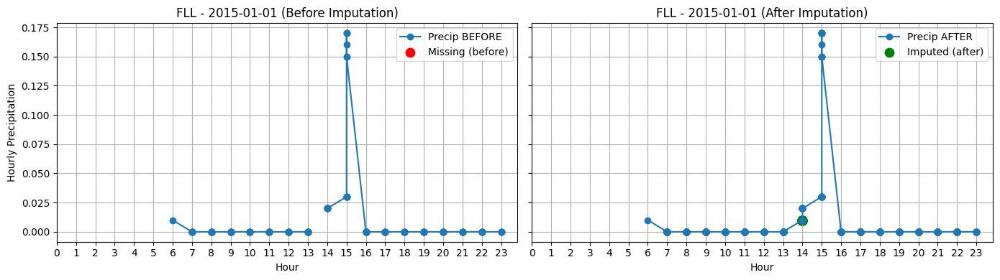

In [0]:
# BEFORE / AFTER imputation plot for precipitation (Databricks / PySpark)
import pyspark.sql.functions as F
import matplotlib.pyplot as plt
import pandas as pd

# ---------- Parameters ----------
airport = "FLL"
day = "2015-01-01"         # YYYY-MM-DD
orig_df_name = "df_otpw"   # original (before imputation) dataframe variable name
imputed_df_name = "df"     # imputed dataframe variable name
ts_col = "DATE"            # timestamp column name in both dataframes
precip_col = "HourlyPrecipitation"
# --------------------------------

# Helper to get a DataFrame variable by name (raises informative error if missing)
def get_df(varname):
    try:
        # try retrieving variable from python globals
        obj = globals()[varname]
        return obj
    except KeyError:
        raise RuntimeError(f"DataFrame named '{varname}' was not found in the notebook environment. "
                           "Make sure you have that variable defined (e.g., df_otpw for original data).")

# Load DataFrames
df_before_spark = get_df(orig_df_name)
df_after_spark  = get_df(imputed_df_name)

# Prepare and filter: ensure timestamp is parsed and extract hour
df_b = (df_before_spark
        .withColumn("ts", F.to_timestamp(F.col(ts_col)))
        .filter((F.col("ORIGIN") == airport) & (F.to_date("ts") == F.lit(day)))
        .withColumn("hour", F.hour("ts"))
        .select("ts", "hour", precip_col)
        .orderBy("ts")
)

df_a = (df_after_spark
        .withColumn("ts", F.to_timestamp(F.col(ts_col)))
        .filter((F.col("ORIGIN") == airport) & (F.to_date("ts") == F.lit(day)))
        .withColumn("hour", F.hour("ts"))
        # preserve a flag if you created one (was_missing) else compute from original nulls later
        .select("ts", "hour", precip_col, F.col("ORIGIN"))
        .orderBy("ts")
)

# Convert to pandas (should be small for a single day & airport)
pdf_b = df_b.toPandas()
pdf_a = df_a.toPandas()

# Defensive checks
if pdf_b.empty:
    print(f"WARNING: No rows found in '{orig_df_name}' for {airport} on {day}. Check the original DF or date/airport.")
if pdf_a.empty:
    print(f"WARNING: No rows found in '{imputed_df_name}' for {airport} on {day}. Check the imputed DF or date/airport.")

# Normalize column names in pandasframes
pdf_b = pdf_b.rename(columns={precip_col: "precip_before"})
pdf_a = pdf_a.rename(columns={precip_col: "precip_after"})

# Make sure ts columns are datetime
pdf_b["ts"] = pd.to_datetime(pdf_b["ts"])
pdf_a["ts"] = pd.to_datetime(pdf_a["ts"])

# Mark missing in the BEFORE snapshot
pdf_b["was_missing"] = pdf_b["precip_before"].isna()

# Mark which rows were imputed in the AFTER snapshot.
# If you created a flag in the imputed DF (e.g., 'was_missing'), prefer using it.
if "was_missing" in pdf_a.columns:
    pdf_a["was_missing_after"] = pdf_a["was_missing"].astype(bool)
else:
    # fallback: compare with before: if timestamp exists in both, check if it was null before and has value after
    #pdf_a = pdf_a.merge(pdf_b[["ts", "precip_before", "was_missing"]], on="ts", how="left")
    pdf_a = pdf_a.merge(pdf_b[["ts", "precip_before", "was_missing"]],
                    on="ts",
                    how="inner")

    pdf_a["was_missing_after"] = pdf_a["was_missing"].fillna(False).astype(bool)
    # keep precip_after column
    pdf_a = pdf_a.drop(columns=["was_missing"])

# Convert precip columns to numeric (coerce strings like "T" if present)
pdf_b["precip_before"] = pd.to_numeric(pdf_b["precip_before"], errors="coerce")
pdf_a["precip_after"]  = pd.to_numeric(pdf_a["precip_after"], errors="coerce")

# Plot side-by-side
fig, axes = plt.subplots(1, 2, figsize=(14,4), sharey=True)

# BEFORE plot
if not pdf_b.empty:
    axes[0].plot(pdf_b["hour"], pdf_b["precip_before"], marker="o", label="Precip BEFORE")
    # highlight missing points (red)
    if pdf_b["was_missing"].any():
        axes[0].scatter(
            pdf_b.loc[pdf_b["was_missing"], "hour"],
            pdf_b.loc[pdf_b["was_missing"], "precip_before"],
            color="red", s=80, label="Missing (before)"
        )
axes[0].set_title(f"{airport} - {day} (Before Imputation)")
axes[0].set_xlabel("Hour")
axes[0].set_ylabel("Hourly Precipitation")
axes[0].set_xticks(range(0,24))
axes[0].grid(True)
axes[0].legend()

# AFTER plot
if not pdf_a.empty:
    axes[1].plot(pdf_a["hour"], pdf_a["precip_after"], marker="o", label="Precip AFTER")
    # highlight imputed points (green)
    if pdf_a["was_missing_after"].any():
        axes[1].scatter(
            pdf_a.loc[pdf_a["was_missing_after"], "hour"],
            pdf_a.loc[pdf_a["was_missing_after"], "precip_after"],
            color="green", s=80, label="Imputed (after)"
        )
axes[1].set_title(f"{airport} - {day} (After Imputation)")
axes[1].set_xlabel("Hour")
axes[1].set_xticks(range(0,24))
axes[1].grid(True)
axes[1].legend()

plt.tight_layout()
plt.show()

# # Print quick comparison stats
# print("\nQuick stats:")
# print(f"Rows (before): {len(pdf_b)}  |  missing (before): {int(pdf_b['was_missing'].sum()) if 'was_missing' in pdf_b else 'N/A'}")
# print(f"Rows (after) : {len(pdf_a)}  |  imputed (after): {int(pdf_a['was_missing_after'].sum()) if 'was_missing_after' in pdf_a else 'N/A'}")

# # Show table of timestamps where imputation happened (if any)
# if pdf_a["was_missing_after"].any():
#     print("\nTimestamps that were imputed (timestamp, value_after):")
#     display(pdf_a.loc[pdf_a["was_missing_after"], ["ts","hour","precip_after"]].sort_values("ts"))
# else:
#     print("\nNo imputed timestamps detected for this airport/day in the imputed DF.")


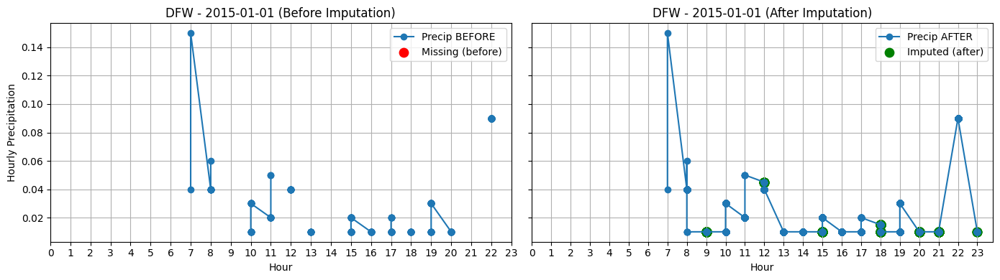

In [0]:
# BEFORE / AFTER imputation plot for precipitation (Databricks / PySpark)
import pyspark.sql.functions as F
import matplotlib.pyplot as plt
import pandas as pd

# ---------- Parameters ----------
airport = "DFW"
day = "2015-01-01"         # YYYY-MM-DD
orig_df_name = "df_otpw"   # original (before imputation) dataframe variable name
imputed_df_name = "df"     # imputed dataframe variable name
ts_col = "DATE"            # timestamp column name in both dataframes
precip_col = "HourlyPrecipitation"
# --------------------------------

# Helper to get a DataFrame variable by name (raises informative error if missing)
def get_df(varname):
    try:
        # try retrieving variable from python globals
        obj = globals()[varname]
        return obj
    except KeyError:
        raise RuntimeError(f"DataFrame named '{varname}' was not found in the notebook environment. "
                           "Make sure you have that variable defined (e.g., df_otpw for original data).")

# Load DataFrames
df_before_spark = get_df(orig_df_name)
df_after_spark  = get_df(imputed_df_name)

# Prepare and filter: ensure timestamp is parsed and extract hour
df_b = (df_before_spark
        .withColumn("ts", F.to_timestamp(F.col(ts_col)))
        .filter((F.col("ORIGIN") == airport) & (F.to_date("ts") == F.lit(day)))
        .withColumn("hour", F.hour("ts"))
        .select("ts", "hour", precip_col)
        .orderBy("ts")
)

df_a = (df_after_spark
        .withColumn("ts", F.to_timestamp(F.col(ts_col)))
        .filter((F.col("ORIGIN") == airport) & (F.to_date("ts") == F.lit(day)))
        .withColumn("hour", F.hour("ts"))
        # preserve a flag if you created one (was_missing) else compute from original nulls later
        .select("ts", "hour", precip_col, F.col("ORIGIN"))
        .orderBy("ts")
)

# Convert to pandas (should be small for a single day & airport)
pdf_b = df_b.toPandas()
pdf_a = df_a.toPandas()

# Defensive checks
if pdf_b.empty:
    print(f"WARNING: No rows found in '{orig_df_name}' for {airport} on {day}. Check the original DF or date/airport.")
if pdf_a.empty:
    print(f"WARNING: No rows found in '{imputed_df_name}' for {airport} on {day}. Check the imputed DF or date/airport.")

# Normalize column names in pandasframes
pdf_b = pdf_b.rename(columns={precip_col: "precip_before"})
pdf_a = pdf_a.rename(columns={precip_col: "precip_after"})

# Make sure ts columns are datetime
pdf_b["ts"] = pd.to_datetime(pdf_b["ts"])
pdf_a["ts"] = pd.to_datetime(pdf_a["ts"])

# Mark missing in the BEFORE snapshot
pdf_b["was_missing"] = pdf_b["precip_before"].isna()

# Mark which rows were imputed in the AFTER snapshot.
# If you created a flag in the imputed DF (e.g., 'was_missing'), prefer using it.
if "was_missing" in pdf_a.columns:
    pdf_a["was_missing_after"] = pdf_a["was_missing"].astype(bool)
else:
    # fallback: compare with before: if timestamp exists in both, check if it was null before and has value after
    #pdf_a = pdf_a.merge(pdf_b[["ts", "precip_before", "was_missing"]], on="ts", how="left")
    pdf_a = pdf_a.merge(pdf_b[["ts", "precip_before", "was_missing"]],
                    on="ts",
                    how="inner")

    pdf_a["was_missing_after"] = pdf_a["was_missing"].fillna(False).astype(bool)
    # keep precip_after column
    pdf_a = pdf_a.drop(columns=["was_missing"])

# Convert precip columns to numeric (coerce strings like "T" if present)
pdf_b["precip_before"] = pd.to_numeric(pdf_b["precip_before"], errors="coerce")
pdf_a["precip_after"]  = pd.to_numeric(pdf_a["precip_after"], errors="coerce")

# Plot side-by-side
fig, axes = plt.subplots(1, 2, figsize=(14,4), sharey=True)

# BEFORE plot
if not pdf_b.empty:
    axes[0].plot(pdf_b["hour"], pdf_b["precip_before"], marker="o", label="Precip BEFORE")
    # highlight missing points (red)
    if pdf_b["was_missing"].any():
        axes[0].scatter(
            pdf_b.loc[pdf_b["was_missing"], "hour"],
            pdf_b.loc[pdf_b["was_missing"], "precip_before"],
            color="red", s=80, label="Missing (before)"
        )
axes[0].set_title(f"{airport} - {day} (Before Imputation)")
axes[0].set_xlabel("Hour")
axes[0].set_ylabel("Hourly Precipitation")
axes[0].set_xticks(range(0,24))
axes[0].grid(True)
axes[0].legend()

# AFTER plot
if not pdf_a.empty:
    axes[1].plot(pdf_a["hour"], pdf_a["precip_after"], marker="o", label="Precip AFTER")
    # highlight imputed points (green)
    if pdf_a["was_missing_after"].any():
        axes[1].scatter(
            pdf_a.loc[pdf_a["was_missing_after"], "hour"],
            pdf_a.loc[pdf_a["was_missing_after"], "precip_after"],
            color="green", s=80, label="Imputed (after)"
        )
axes[1].set_title(f"{airport} - {day} (After Imputation)")
axes[1].set_xlabel("Hour")
axes[1].set_xticks(range(0,24))
axes[1].grid(True)
axes[1].legend()

plt.tight_layout()
plt.show()

# # Print quick comparison stats
# print("\nQuick stats:")
# print(f"Rows (before): {len(pdf_b)}  |  missing (before): {int(pdf_b['was_missing'].sum()) if 'was_missing' in pdf_b else 'N/A'}")
# print(f"Rows (after) : {len(pdf_a)}  |  imputed (after): {int(pdf_a['was_missing_after'].sum()) if 'was_missing_after' in pdf_a else 'N/A'}")

# # Show table of timestamps where imputation happened (if any)
# if pdf_a["was_missing_after"].any():
#     print("\nTimestamps that were imputed (timestamp, value_after):")
#     display(pdf_a.loc[pdf_a["was_missing_after"], ["ts","hour","precip_after"]].sort_values("ts"))
# else:
#     print("\nNo imputed timestamps detected for this airport/day in the imputed DF.")


In [0]:
# HourlyPrecipitation - Done
# HourlyAltimeterSetting - Done
# HourlySkyConditions
# HourlyWetBulbTemperature - Done
# HourlyStationPressure
# HourlyWindDirection
# HourlyRelativeHumidity
# HourlyWindSpeed
# HourlyDryBulbTemperature - Done
# HourlyDewPointTemperature - Done
# HourlyVisibility
# ACTUAL_ELAPSED_TIME
# REM

In [0]:
from pyspark.sql import functions as F

df_rain = df_otpw.filter(F.col("HourlyAltimeterSetting").isNull())

print("Total rows where precipitation > 0:", df_rain.count())

# Show 10 sample rows

display(df_rain.orderBy("DATE").limit(30))

Total rows where precipitation > 0: 60658


HourlyPrecipitation,HourlyAltimeterSetting,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,ORIGIN,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH
null,null,0.0,158,-1.0,-1,41,34,28.88,N606NK,070,79,30,3,36,9.94,33.4277,2015-01-01T05:00:00,72278023183,2015-01-01T06:59:00,2015-01-01T04:59:00,2015-01-01T08:59:00,2015-01-01T01:59:00,0001-0559,4,868.0,502,1,14107,972,159,1,"PHOENIX AIRPORT, AZ US",337.4,11298,-112.0,33.4,4,-97.0,PHX,2015-01-01,1,32.9,US-TX,large_airport,-112.0038,123.0,DFW,US-AZ,large_airport,PHX,1
null,null,0.0,550,-5.0,-1,26,20,29.32,N334JB,220,81,16,10,21,5.59,43.11722,2015-01-01T07:00:00,72529014768,2015-01-01T08:55:00,2015-01-01T06:55:00,2015-01-01T10:55:00,2015-01-01T05:55:00,0001-0559,2,264.0,720,1,14576,185,555,1,"ROCHESTER GREATER INTERNATIONAL, NY US",164.3,12478,-77.7,43.1,4,-73.8,ROC,2015-01-01,1,40.6,US-NY,large_airport,-77.67541,85.0,JFK,US-NY,large_airport,ROC,1
null,null,19.0,619,19.0,1,null,30,29.21,N949FR,310,79,26,7,32,9.94,33.6301,2015-01-01T07:00:00,72219013874,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,3,701.0,750,1,10397,902,600,1,"ATLANTA HARTSFIELD JACKSON INTERNATIONAL AIRPORT, GA US",307.8,15356,-84.4,33.6,4,-74.8,ATL,2015-01-01,1,40.3,US-NJ,medium_airport,-84.4418,110.0,TTN,US-GA,large_airport,ATL,1
null,null,0.0,557,-3.0,-1,null,24,30.15,N203JB,230,49,12,5,29,9.94,38.8472,2015-01-01T07:00:00,72405013743,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,2,399.0,724,1,11278,1790,600,1,"WASHINGTON REAGAN NATIONAL AIRPORT, VA US",3.0,10721,-77.0,38.8,4,-71.0,DCA,2015-01-01,1,42.4,US-MA,large_airport,-77.03454,84.0,BOS,US-DC,large_airport,DCA,1
null,null,0.0,555,0.0,0,26,18,29.00,N16561,220,68,11,13,20,9.94,42.7761,2015-01-01T07:00:00,72539014836,2015-01-01T08:55:00,2015-01-01T06:55:00,2015-01-01T10:55:00,2015-01-01T05:55:00,0001-0559,1,179.0,604,1,12884,3941,555,1,"LANSING CAPITAL CITY AIRPORT, MI US",261.8,13930,-84.6,42.8,4,-87.9,LAN,2015-01-01,1,42.0,US-IL,large_airport,-84.5997,69.0,ORD,US-MI,medium_airport,LAN,1
null,null,68.0,708,68.0,4,41,22,30.12,N3JYAA,260,39,6,13,28,9.94,40.77944,2015-01-01T07:00:00,72503014732,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,5,1096.0,912,1,12953,1297,600,1,"LAGUARDIA AIRPORT, NY US",3.4,13303,-73.9,40.8,4,-80.3,LGA,2015-01-01,1,25.8,US-FL,large_airport,-73.88035,192.0,MIA,US-NY,large_airport,LGA,1
null,null,0.0,556,-4.0,-1,null,19,30.14,N766JB,230,57,9,6,22,9.94,40.6825,2015-01-01T07:00:00,72502014734,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,5,1065.0,900,1,11618,605,600,1,"NEWARK LIBERTY INTERNATIONAL AIRPORT, NJ US",2.1,11697,-74.2,40.7,4,-80.2,EWR,2015-01-01,1,26.1,US-FL,large_airport,-74.1694,180.0,FLL,US-NJ,large_airport,EWR,1
null,null,0.0,559,-1.0,-1,null,16,28.89,N910WN,220,52,5,11,20,9.94,40.4846,2015-01-01T07:00:00,72520094823,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,4,994.0,850,1,14122,2787,600,1,"PITTSBURGH ASOS, PA US",366.7,11697,-80.2,40.5,4,-80.2,PIT,2015-01-01,1,26.1,US-FL,large_airport,-80.2144,170.0,FLL,US-PA,large_airport,PIT,1
null,null,0.0,554,-6.0,-1,15,56,30.19,N598JB,030,83,54,9,59,9.94,27.96194,2015-01-01T07:00:00,72211012842,2015-01-01T09:00:00,2015-01-01T07:00:0

In [0]:
display(df_otpw.filter(
    (F.col("ORIGIN") == "MCO") &
    (F.to_date(F.col("Date")) == "2015-01-01")
))


HourlyPrecipitation,HourlyAltimeterSetting,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,ORIGIN,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH
0.00,30.17,0.0,1545,-5.0,-1,BKN:07 7 BKN:07 13 OVC:08 37,69,30.06,N3AXAA,020,90,68,9,71,10.00,28.4339,2015-01-01T16:53:00,72205012815,2015-01-01T18:50:00,2015-01-01T16:50:00,2015-01-01T20:50:00,2015-01-01T15:50:00,1500-1559,4,944.0,1825,1,13204,1016,1550,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,12478,-81.3,28.4,4,-73.8,MCO,2015-01-01,1,40.6,US-NY,large_airport,-81.325,155.0,JFK,US-FL,large_airport,MCO,1
0.00,30.20,0.0,1123,-2.0,-1,BKN:07 12 BKN:07 20 BKN:07 43,67,30.09,N39418,010,76,64,7,72,10.00,28.4339,2015-01-01T12:53:00,72205012815,2015-01-01T14:25:00,2015-01-01T12:25:00,2015-01-01T16:25:00,2015-01-01T11:25:00,1100-1159,4,937.0,1359,1,13204,1065,1125,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,11618,-81.3,28.4,4,-74.2,MCO,2015-01-01,1,40.7,US-NJ,large_airport,-81.325,154.0,EWR,US-FL,large_airport,MCO,1
null,null,20.0,1215,20.0,1,15,67,30.09,N58101,010,76,64,7,72,9.94,28.4339,2015-01-01T13:00:00,72205012815,2015-01-01T14:55:00,2015-01-01T12:55:00,2015-01-01T16:55:00,2015-01-01T11:55:00,1100-1159,4,854.0,1330,1,13204,1131,1155,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,12266,-81.3,28.4,4,-95.4,MCO,2015-01-01,1,30.0,US-TX,large_airport,-81.325,155.0,IAH,US-FL,large_airport,MCO,1
0.00,30.27,34.0,846,34.0,2,BKN:07 12 BKN:07 44,62,30.16,N63820,010,84,60,11,65,10.00,28.4339,2015-01-01T09:53:00,72205012815,2015-01-01T11:12:00,2015-01-01T09:12:00,2015-01-01T13:12:00,2015-01-01T08:12:00,0800-0859,7,1546.0,1020,1,13204,1142,812,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,11292,-81.3,28.4,4,-104.7,MCO,2015-01-01,1,39.8,US-CO,large_airport,-81.325,248.0,DEN,US-FL,large_airport,MCO,1
null,30.25,0.0,600,-5.0,-1,SCT:04 13 OVC:08 20,59,30.14,N641JB,360,90,58,9,61,10.00,28.4339,2015-01-01T07:27:00,72205012815,2015-01-01T09:05:00,2015-01-01T07:05:00,2015-01-01T11:05:00,2015-01-01T06:05:00,0600-0659,4,944.0,831,1,13204,1184,605,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,12478,-81.3,28.4,4,-73.8,MCO,2015-01-01,1,40.6,US-NY,large_airport,-81.325,146.0,JFK,US-FL,large_airport,MCO,1
null,30.27,0.0,849,-6.0,-1,SCT:04 10 BKN:07 26 OVC:08 44,63,30.16,N919WN,360,83,61,11,66,10.00,28.4339,2015-01-01T10:47:00,72205012815,2015-01-01T11:55:00,2015-01-01T09:55:00,2015-01-01T13:55:00,2015-01-01T08:55:00,0800-0859,4,882.0,1025,1,13204,1190,855,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,15016,-81.3,28.4,4,-90.4,MCO,2015-01-01,1,38.8,US-MO,large_airport,-81.325,150.0,STL,US-FL,large_airport,MCO,1
null,30.27,0.0,943,-2.0,-1,SCT:04 10 BKN:07 26 OVC:08 44,63,30.16,N7718B,360,83,61,11,66,10.00,28.4339,2015-01-01T10:47:00,72205012815,2015-01-01T12:45:00,2015-01-01T10:45:00,2015-01-01T14:45:00,2015-01-01T09:45:00,0900-0959,3,616.0,1040,1,13204,1251,945,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,10693,-81.3,28.4,4,-86.7,MCO,2015-01-01,1,36.1,US-TN,large_airport,-81.325,115.0,BNA,US-FL,large_airport,MCO,1
0.00,30.22,0.0,1929,-6.0,-1,FEW:02 2 OVC:08 5,65,30.11,N925WN,360,96,65,10,66,7.00,28.4339,2015-01-01T20:53:00,72205012815,2015-01-01T22:35:00,2015-01-01T20:35:00,2015-01-02T00:35:00,2015-01-01T19:35:00,1900-1959,5,1050.0,2210,1,13204,1517,1935,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,10529,-81.3,28.4,4,-72.7,MCO,2015-01-01,1,41.9,US-CT,large_airport,-81.325,15

In [0]:
display(df.filter(
    (F.col("ORIGIN") == "MCO") &
    (F.to_date(F.col("Date")) == "2015-01-01")
))


HourlyPrecipitation,HourlyAltimeterSetting,ACTUAL_ELAPSED_TIME,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,REM,DEST_STATE_FIPS,SOURCE,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DIVERTED,CANCELLED,ARR_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,DEST_STATE_ABR,DEST_CITY_NAME,DEST,DEST_CITY_MARKET_ID,DEST_AIRPORT_SEQ_ID,DEST_STATE_NM,ORIGIN_WAC,ORIGIN_STATE_NM,CRS_DEP_TIME,DEST_WAC,_row_desc,REPORT_TYPE,NAME,ELEVATION,FLIGHTS,DEST_AIRPORT_ID,dest_station_id,dest_station_name,dest_airport_name,origin_station_dis,origin_airport_lon,origin_airport_lat,origin_station_lon,dest_station_dis,DAY_OF_WEEK,dest_airport_lon,ORIGIN_STATE_ABR,ORIGIN_CITY_NAME,ORIGIN,ORIGIN_CITY_MARKET_ID,ORIGIN_AIRPORT_SEQ_ID,OP_CARRIER,OP_CARRIER_AIRLINE_ID,OP_UNIQUE_CARRIER,FL_DATE,ORIGIN_STATE_FIPS,QUARTER,dest_airport_lat,dest_station_lon,dest_station_lat,dest_region,dest_type,dest_icao,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,YEAR,origin_station_lat,origin_region,origin_type,origin_icao,origin_iata_code,origin_station_id,origin_station_name,origin_airport_name,MONTH,HourlyPrecipitation_was_missing
0.0,30.24,55.0,0.0,507,-3.0,-1,BKN:07 14 OVC:08 24,59,30.13,N3CXAA,350,90,58,8,61,10.00,MET09801/01/15 06:32:02 SPECI KMCO 011132Z 35007KT 10SM BKN014 OVC024 16/14 A3024 RMK AO2 T01610144 (RK),12,7,28.4339,2015-01-01T06:32:00,72205012815,2015-01-01T08:10:00,2015-01-01T06:10:00,2015-01-01T10:10:00,2015-01-01T05:10:00,0001-0559,0.0,0.0,0600-0659,1,192.0,613,1,13204,1323,FL,"Miami, FL",MIA,32467,1330303,Florida,33,Florida,510,33,1,FM-16,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,1.0,13303,72202012839,MIAMI INTERNATIONAL AIRPORT,Miami International Airport,0.0,-81.3,28.4,-81.3,0.0,4,-80.3,FL,"Orlando, FL",MCO,31454,1320402,AA,19805,AA,2015-01-01,12,1,25.8,-80.3,25.8,US-FL,large_airport,KMIA,-81.325,63.0,MIA,2015,28.4,US-FL,large_airport,KMCO,MCO,72205012815,ORLANDO INTERNATIONAL AIRPORT,Orlando International Airport,1,1
0.0,30.24,144.0,0.0,548,-2.0,-1,OVC:08 14,59,30.13,N231JB,360,90,58,8,61,10.00,MET12201/01/15 06:53:02 METAR KMCO 011153Z 36007KT 10SM OVC014 16/14 A3024 RMK AO2 SLP238 60000 T01610144 10161 20156 53007 (RK),34,7,28.4339,2015-01-01T06:53:00,72205012815,2015-01-01T08:50:00,2015-01-01T06:50:00,2015-01-01T10:50:00,2015-01-01T05:50:00,0001-0559,0.0,0.0,0800-0859,4,937.0,819,1,13204,2228,NJ,"Newark, NJ",EWR,31703,1161802,New Jersey,33,Florida,550,21,1,FM-15,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,1.0,11618,72502014734,NEWARK LIBERTY INTERNATIONAL,Newark Liberty International Airport,0.0,-81.3,28.4,-81.3,0.0,4,-74.2,FL,"Orlando, FL",MCO,31454,1320402,B6,20409,B6,2015-01-01,12,1,40.7,-74.2,40.7,US-NJ,large_airport,KEWR,-81.325,149.0,EWR,2015,28.4,US-FL,large_airport,KMCO,MCO,72205012815,ORLANDO INTERNATIONAL AIRPORT,Orlando International Airport,1,0
0.005,null,212.0,0.0,550,-10.0,-1,15,59,30.14,N532US,360,90,58,8,61,9.94,SYN08672205 12466 83607 10161 20144 30205 40238 53007 69901 91153 333 10183 20156 555 90112=,27,4,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,0.0,0.0,0800-0859,6,1310.0,829,1,13204,1574,MN,"Minneapolis, MN",MSP,31650,1348702,Minnesota,33,Florida,600,63,1,FM-12,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,1.0,13487,72658014922,MINNEAPOLIS-ST PAUL INTERNATI,Minneapolis-St Paul International/Wold-Chamberlain Airport,0.0,-81.3,28.4,-81.3,0.0,4,-93.2,FL,"Orlando, FL",MCO,31454,1320402,DL,19790,DL,2015-01-01,12,1,44.9,-93.2,44.9,US-MN,large_airport,KMSP,-81.325,209.0,MSP,2015,28.4,US-FL,large_airport,KMCO,MCO,72205012815,ORLANDO INTERNATIONAL AIRPORT,Orlando International Airport,1,1
0.005,null,150.0,0.0,557

In [0]:
display(df.select("HourlyPrecipitation").summary())

summary,HourlyPrecipitation
count,1357884
mean,0.0031422529464953204
stddev,0.015804045264108335
min,0.0
25%,0.0
50%,0.0
75%,0.0
max,1.69


In [0]:
display(df.select("HourlyAltimeterSetting").summary())

summary,HourlyAltimeterSetting
count,1297226
mean,30.122446934816843
stddev,0.19874273699157827
min,28.62
25%,29.99
50%,30.12
75%,30.25
max,31.09


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

# ---------- SETTINGS ----------
df_in = df
ts_col = "DATE"
origin_col = "ORIGIN"
col = "HourlyAltimeterSetting"   # overwrite this column
hour_col = "ts_hour"
HARDCODE_FALLBACK = 30.12
MEDIAN_BUCKETS = 100
# -------------------------------

# 1) normalize timestamp & cast numeric
df1 = (df_in
       .withColumn("ts", F.to_timestamp(F.col(ts_col)))
       .withColumn(col, F.col(col).cast("double"))
)

# 2) origin-hour aggregation
df_hourly = (df1
    .withColumn(hour_col, F.date_trunc("hour", "ts"))
    .groupBy(origin_col, hour_col)
    .agg(F.avg(col).alias("hourly_avg"))  # you can switch to median if needed
)

# 3) per-origin median fallback
origin_median = df_hourly.groupBy(origin_col) \
    .agg(F.expr(f"percentile_approx(hourly_avg, 0.5, {MEDIAN_BUCKETS})").alias("origin_median"))

# 4) global median fallback
gm = df_hourly.selectExpr(f"percentile_approx(hourly_avg, 0.5, {MEDIAN_BUCKETS}) as gm").limit(1).collect()
global_median = gm[0]["gm"] if gm and gm[0]["gm"] is not None else HARDCODE_FALLBACK

# join medians
df_hourly = df_hourly.join(origin_median, on=origin_col, how="left")

# 5) forward-fill previous value
w = Window.partitionBy(origin_col).orderBy(hour_col).rowsBetween(Window.unboundedPreceding, 0)
df_hourly = df_hourly.withColumn("prev_val", F.last("hourly_avg", ignorenulls=True).over(w))

# 6) impute + ROUND to 2 decimals + overwrite original column name
df_hourly = df_hourly.withColumn(
    "imputed",
    F.round(
        F.coalesce(
            "hourly_avg",
            "prev_val",
            "origin_median",
            F.lit(global_median),
            F.lit(HARDCODE_FALLBACK)
        ), 2
    )
)

# 7) join back and overwrite the same column
df_final = (df1
    .withColumn(hour_col, F.date_trunc("hour", "ts"))
    .join(df_hourly.select(origin_col, hour_col, "imputed"), [origin_col, hour_col], "left")
    .drop(col)
    .withColumnRenamed("imputed", col)  # 
)

df_imputed = df_final

df_imputed.select(origin_col, hour_col, col).show(10, False)


+------+-------------------+----------------------+
|ORIGIN|ts_hour            |HourlyAltimeterSetting|
+------+-------------------+----------------------+
|LAX   |2015-01-01 15:00:00|30.12                 |
|DFW   |2015-01-01 20:00:00|30.22                 |
|LAX   |2015-01-02 02:00:00|30.13                 |
|JFK   |2015-01-01 19:00:00|30.02                 |
|LGB   |2015-01-01 18:00:00|30.14                 |
|AUS   |2015-01-01 10:00:00|30.28                 |
|BUF   |2015-01-01 21:00:00|29.93                 |
|ATL   |2015-01-01 18:00:00|30.28                 |
|MHT   |2015-01-01 13:00:00|29.9                  |
|LAX   |2015-01-02 01:00:00|30.14                 |
+------+-------------------+----------------------+
only showing top 10 rows


In [0]:
display(df_imputed.filter(
    (F.col("ORIGIN") == "MCO") &
    (F.to_date(F.col("Date")) == "2015-01-01")
))


ORIGIN,ts_hour,HourlyPrecipitation,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH,HourlyPrecipitation_was_missing,ts,HourlyAltimeterSetting
MCO,2015-01-01T06:00:00Z,0.0,0.0,507,-3.0,-1,BKN:07 14 OVC:08 24,59,30.13,N3CXAA,350,90,58,8,61,10.00,28.4339,2015-01-01T06:32:00,72205012815,2015-01-01T08:10:00,2015-01-01T06:10:00,2015-01-01T10:10:00,2015-01-01T05:10:00,0001-0559,1,192.0,613,1,13204,1323,510,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,13303,-81.3,28.4,4,-80.3,2015-01-01,1,25.8,US-FL,large_airport,-81.325,63.0,MIA,US-FL,large_airport,MCO,1,1,2015-01-01T06:32:00Z,30.24
MCO,2015-01-01T06:00:00Z,0.0,0.0,548,-2.0,-1,OVC:08 14,59,30.13,N231JB,360,90,58,8,61,10.00,28.4339,2015-01-01T06:53:00,72205012815,2015-01-01T08:50:00,2015-01-01T06:50:00,2015-01-01T10:50:00,2015-01-01T05:50:00,0001-0559,4,937.0,819,1,13204,2228,550,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,11618,-81.3,28.4,4,-74.2,2015-01-01,1,40.7,US-NJ,large_airport,-81.325,149.0,EWR,US-FL,large_airport,MCO,1,0,2015-01-01T06:53:00Z,30.24
MCO,2015-01-01T07:00:00Z,0.005,0.0,550,-10.0,-1,15,59,30.14,N532US,360,90,58,8,61,9.94,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,6,1310.0,829,1,13204,1574,600,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,13487,-81.3,28.4,4,-93.2,2015-01-01,1,44.9,US-MN,large_airport,-81.325,209.0,MSP,US-FL,large_airport,MCO,1,1,2015-01-01T07:00:00Z,30.25
MCO,2015-01-01T07:00:00Z,0.005,0.0,557,-3.0,-1,15,59,30.14,N523JB,360,90,58,8,61,9.94,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,4,950.0,825,1,13204,198,600,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,12953,-81.3,28.4,4,-73.9,2015-01-01,1,40.8,US-NY,large_airport,-81.325,145.0,LGA,US-FL,large_airport,MCO,1,1,2015-01-01T07:00:00Z,30.25
MCO,2015-01-01T07:00:00Z,0.005,0.0,555,-5.0,-1,15,59,30.14,N24224,360,90,58,8,61,9.94,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,4,937.0,834,1,13204,1163,600,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,11618,-81.3,28.4,4,-74.2,2015-01-01,1,40.7,US-NJ,large_airport,-81.325,154.0,EWR,US-FL,large_airport,MCO,1,1,2015-01-01T07:00:00Z,30.25
MCO,2015-01-01T07:00:00Z,0.005,2.0,557,2.0,0,15,59,30.14,N68452,360,90,58,8,61,9.94,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T08:55:00,2015-01-01T06:55:00,2015-01-01T10:55:00,2015-01-01T05:55:00,0001-0559,9,2218.0,836,1,13204,1222,555,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,12892,-81.3,28.4,4,-118.4,2015-01-01,1,33.9,US-CA,large_airport,-81.325,341.0,LAX,US-FL,large_airport,MCO,1,1,2015-01-01T07:00:00Z,30.25
MCO,2015-01-01T07:00:00Z,0.005,0.0,557,-3.0,-1,15,59,30.14,N536UW,360,90,58,8,61,9.94,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,8,1849.0,841,1,13204,459,600,1,"ORLANDO INTERNATIONAL AIRPORT, FL US",27.4,14107,-81.3,28.4,4,-112.0,2015-01-01,1,33.4,US-AZ,large_airport,-81.325,281.0,PHX,US-FL,large_airport,MCO,1,1,2015-01-01T07:00:00Z,30.25
MCO,2015-01-01T07:00:00Z,0.005,0.0,554,-6.0,-1,15,59,30.14,N358NW,360,90,58,8,61,9.94,28.4339,2015-01-01T07:00:00,72205012815,2015-01-01T09:00:00,2015

In [0]:
display(df_imputed.select("HourlyWetBulbTemperature").summary())

summary,HourlyWetBulbTemperature
count,1348117
mean,41.19847961883652
stddev,16.701693858207122
min,*
25%,30.0
50%,42.0
75%,54.0
max,9


In [0]:
from pyspark.sql import functions as F

df = df_imputed.withColumn(
    "HourlyWetBulbTemperature",
    F.when(F.trim("HourlyWetBulbTemperature").rlike("^[0-9.+-]+$"), 
           F.col("HourlyWetBulbTemperature").cast("double"))
     .otherwise(None)
)





In [0]:
display(df.select("HourlyWetBulbTemperature").summary())

summary,HourlyWetBulbTemperature
count,1348083
mean,41.19847961883652
stddev,16.701693858207122
min,-32.0
25%,30.0
50%,42.0
75%,54.0
max,78.0


In [0]:
# HourlyDryBulbTemperature
# HourlyDewPointTemperature

display(df.select("HourlyDryBulbTemperature").summary())


df = df.withColumn(
    "HourlyDryBulbTemperature",
    F.when(F.trim("HourlyDryBulbTemperature").rlike("^[0-9.+-]+$"), 
           F.col("HourlyDryBulbTemperature").cast("double"))
     .otherwise(None)
)



summary,HourlyDryBulbTemperature
count,1353605
mean,47.81910326946557
stddev,19.336166366191588
min,*
25%,34.0
50%,49.0
75%,63.0
max,99


In [0]:
display(df.select("HourlyDryBulbTemperature").summary())


summary,HourlyDryBulbTemperature
count,1353004
mean,47.81910326946557
stddev,19.336166366191588
min,-40.0
25%,34.0
50%,49.0
75%,63.0
max,99.0


In [0]:
display(df.select("HourlyDewPointTemperature").summary())

summary,HourlyDewPointTemperature
count,1353492
mean,32.4231427557868
stddev,19.169882220861464
min,*
25%,19.0
50%,32.0
75%,48.0
max,9


In [0]:
df = df.withColumn(
    "HourlyDewPointTemperature",
    F.when(F.trim("HourlyDewPointTemperature").rlike("^[0-9.+-]+$"), 
           F.col("HourlyDewPointTemperature").cast("double"))
     .otherwise(None)
)


In [0]:
# HourlyPrecipitation - Done
# HourlyAltimeterSetting - Done
# HourlySkyConditions
# HourlyWetBulbTemperature - Done
# HourlyStationPressure - Done
# HourlyWindDirection
# HourlyRelativeHumidity
# HourlyWindSpeed
# HourlyDryBulbTemperature - Done
# HourlyDewPointTemperature - Done
# HourlyVisibility
# ACTUAL_ELAPSED_TIME
# REM

In [0]:
display(df.select("HourlyDewPointTemperature").summary())

summary,HourlyDewPointTemperature
count,1353080
mean,32.4231427557868
stddev,19.169882220861464
min,-38.0
25%,19.0
50%,32.0
75%,48.0
max,76.0


In [0]:
display(df.select("HourlyStationPressure").summary())

summary,HourlyStationPressure
count,1348723
mean,29.22211112083337
stddev,1.3566573086664082
min,22.22
25%,29.13
50%,29.62
75%,30.0
max,30.96


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

origin_col = "ORIGIN"
time_col = "DATE"
col = "HourlyWetBulbTemperature"

# Ensure timestamp format
df = df_imputed.withColumn("ts", F.to_timestamp(time_col))

# 1) Compute median per origin and global median
origin_median = df.groupBy(origin_col).agg(
    F.expr(f"percentile_approx({col}, 0.5)").alias("origin_median")
)

global_median = df.selectExpr(f"percentile_approx({col}, 0.5) as gm").collect()[0]["gm"]

# 2) Forward fill window
w = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)

# 3) Apply imputation
df = (
    df.join(origin_median, on=origin_col, how="left")
    .withColumn("ffill", F.last(col, ignorenulls=True).over(w))
    .withColumn(
        col,
        F.coalesce(
            F.col(col),      # keep original if not null
            F.col("ffill"),  # forward fill
            F.col("origin_median"),  # origin median fallback
            F.lit(global_median)     # global median fallback
        ).cast("double")
    )
    .drop("origin_median", "ffill")
)


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

origin_col = "ORIGIN"
time_col = "DATE"
col = "HourlyDryBulbTemperature"

# Ensure timestamp format
df = df.withColumn("ts", F.to_timestamp(time_col))

# 1) Compute median per origin and global median
origin_median = df.groupBy(origin_col).agg(
    F.expr(f"percentile_approx({col}, 0.5)").alias("origin_median")
)

global_median = df.selectExpr(f"percentile_approx({col}, 0.5) as gm").collect()[0]["gm"]

# 2) Forward fill window
w = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)

# 3) Apply imputation
df = (
    df.join(origin_median, on=origin_col, how="left")
    .withColumn("ffill", F.last(col, ignorenulls=True).over(w))
    .withColumn(
        col,
        F.coalesce(
            F.col(col),      # keep original if not null
            F.col("ffill"),  # forward fill
            F.col("origin_median"),  # origin median fallback
            F.lit(global_median)     # global median fallback
        ).cast("double")
    )
    .drop("origin_median", "ffill")
)


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

origin_col = "ORIGIN"
time_col = "DATE"
col = "HourlyDewPointTemperature"

# Ensure timestamp format
df = df.withColumn("ts", F.to_timestamp(time_col))

# 1) Compute median per origin and global median
origin_median = df.groupBy(origin_col).agg(
    F.expr(f"percentile_approx({col}, 0.5)").alias("origin_median")
)

global_median = df.selectExpr(f"percentile_approx({col}, 0.5) as gm").collect()[0]["gm"]

# 2) Forward fill window
w = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)

# 3) Apply imputation
df = (
    df.join(origin_median, on=origin_col, how="left")
    .withColumn("ffill", F.last(col, ignorenulls=True).over(w))
    .withColumn(
        col,
        F.coalesce(
            F.col(col),      # keep original if not null
            F.col("ffill"),  # forward fill
            F.col("origin_median"),  # origin median fallback
            F.lit(global_median)     # global median fallback
        ).cast("double")
    )
    .drop("origin_median", "ffill")
)


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

# ---------- PARAMETERS ----------
df_in = df                      # your DataFrame
ts_col = "DATE"                 # timestamp col - must be parseable by to_timestamp
origin_col = "ORIGIN"
col = "HourlyStationPressure"
# sensible physical range in inHg (adjust if units differ)
RANGE_LO, RANGE_HI = 22.0, 32.0
HARDCODE_FALLBACK = 29.62       # typical sea-level-ish median (use your observed median if you want)
# ---------------------------------

# 0) setup: ensure timestamp and trim
df_work = (
    df_in
    .withColumn("ts", F.to_timestamp(F.col(ts_col)))
)

# 1) clean: keep only numeric tokens, else NULL
num_regex = r"^[+-]?\d+(\.\d+)?$"
df_work = df_work.withColumn(
    col,
    F.when(F.trim(F.col(col)).rlike(num_regex), F.col(col).cast("double"))
     .otherwise(None)
)

# 2) clip to physical range (treat out-of-range as null so it gets imputed)
df_work = df_work.withColumn(col, F.when((F.col(col) >= RANGE_LO) & (F.col(col) <= RANGE_HI), F.col(col)).otherwise(None))

# 3) compute per-origin median and global median (percentile_approx w/o third arg)
origin_meds = df_work.groupBy(origin_col).agg(F.expr(f"percentile_approx({col}, 0.5)").alias(f"{col}_origin_med"))

gm_row = df_work.selectExpr(f"percentile_approx({col}, 0.5) as gm").limit(1).collect()
global_med = gm_row[0]["gm"] if gm_row and gm_row[0]["gm"] is not None else HARDCODE_FALLBACK

# 4) join origin median
df_work = df_work.join(origin_meds, on=origin_col, how="left")

# 5) forward-fill window per origin (order by ts)
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df_work = df_work.withColumn("ffill_" + col, F.last(col, ignorenulls=True).over(w_ffill))

# 6) coalesce: original -> forward-fill -> origin median -> global median -> hard fallback
df_work = df_work.withColumn(
    col,
    F.coalesce(
        F.col(col),
        F.col("ffill_" + col),
        F.col(f"{col}_origin_med"),
        F.lit(global_med),
        F.lit(HARDCODE_FALLBACK)
    ).cast("double")
).drop("ffill_" + col)

# 7) round to 2 decimals and keep same column name (overwrite)
df_work = df_work.withColumn(col, F.round(F.col(col), 2))

# 8) drop helper origin median col
if f"{col}_origin_med" in df_work.columns:
    df_work = df_work.drop(f"{col}_origin_med")

# # 9) validation: null count & summary
# null_count = df_work.filter(F.col(col).isNull()).count()
# print(f"Nulls remaining in {col} after imputation: {null_count:,}")

# print("\nSummary after imputation:")
# df_work.select(col).summary("min","25%","50%","75%","max","mean","stddev").show()

# assign out
df_imputed = df_work


In [0]:
df_imputed.select("HourlyWetBulbTemperature").summary("min","25%","50%","75%","max","mean").show()


+-------+------------------------+
|summary|HourlyWetBulbTemperature|
+-------+------------------------+
|    min|                   -32.0|
|    25%|                    30.0|
|    50%|                    42.0|
|    75%|                    54.0|
|    max|                    78.0|
|   mean|      41.198823316277384|
+-------+------------------------+



In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

# ---------- PARAMETERS ----------
df_in = df_imputed                      # your DataFrame
ts_col = "DATE"                 # timestamp col - must be parseable by to_timestamp
origin_col = "ORIGIN"
col = "HourlyStationPressure"
# sensible physical range in inHg (adjust if units differ)
RANGE_LO, RANGE_HI = 22.0, 32.0
HARDCODE_FALLBACK = 29.62       # typical sea-level-ish median (use your observed median if you want)
# ---------------------------------

# 0) setup: ensure timestamp and trim
df_work = (
    df_in
    .withColumn("ts", F.to_timestamp(F.col(ts_col)))
)

# 1) clean: keep only numeric tokens, else NULL
num_regex = r"^[+-]?\d+(\.\d+)?$"
df_work = df_work.withColumn(
    col,
    F.when(F.trim(F.col(col)).rlike(num_regex), F.col(col).cast("double"))
     .otherwise(None)
)

# 2) clip to physical range (treat out-of-range as null so it gets imputed)
df_work = df_work.withColumn(col, F.when((F.col(col) >= RANGE_LO) & (F.col(col) <= RANGE_HI), F.col(col)).otherwise(None))

# 3) compute per-origin median and global median (percentile_approx w/o third arg)
origin_meds = df_work.groupBy(origin_col).agg(F.expr(f"percentile_approx({col}, 0.5)").alias(f"{col}_origin_med"))

gm_row = df_work.selectExpr(f"percentile_approx({col}, 0.5) as gm").limit(1).collect()
global_med = gm_row[0]["gm"] if gm_row and gm_row[0]["gm"] is not None else HARDCODE_FALLBACK

# 4) join origin median
df_work = df_work.join(origin_meds, on=origin_col, how="left")

# 5) forward-fill window per origin (order by ts)
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df_work = df_work.withColumn("ffill_" + col, F.last(col, ignorenulls=True).over(w_ffill))

# 6) coalesce: original -> forward-fill -> origin median -> global median -> hard fallback
df_work = df_work.withColumn(
    col,
    F.coalesce(
        F.col(col),
        F.col("ffill_" + col),
        F.col(f"{col}_origin_med"),
        F.lit(global_med),
        F.lit(HARDCODE_FALLBACK)
    ).cast("double")
).drop("ffill_" + col)

# 7) round to 2 decimals and keep same column name (overwrite)
df_work = df_work.withColumn(col, F.round(F.col(col), 2))

# 8) drop helper origin median col
if f"{col}_origin_med" in df_work.columns:
    df_work = df_work.drop(f"{col}_origin_med")

# # 9) validation: null count & summary
# null_count = df_work.filter(F.col(col).isNull()).count()
# print(f"Nulls remaining in {col} after imputation: {null_count:,}")

# print("\nSummary after imputation:")
# df_work.select(col).summary("min","25%","50%","75%","max","mean","stddev").show()

# assign out
df_imputed = df_work


In [0]:
df.select("HourlyWindDirection").summary("min","25%","50%","75%","max","mean").show()


+-------+-------------------+
|summary|HourlyWindDirection|
+-------+-------------------+
|    min|                000|
|    25%|               80.0|
|    50%|              200.0|
|    75%|              290.0|
|    max|                VRB|
|   mean|  183.2216826970112|
+-------+-------------------+



In [0]:
#HourlyRelativeHumidity

df_imputed.select("HourlyRelativeHumidity").summary("min","25%","50%","75%","max","mean").show()


+-------+----------------------+
|summary|HourlyRelativeHumidity|
+-------+----------------------+
|    min|                     *|
|    25%|                  44.0|
|    50%|                  61.0|
|    75%|                  78.0|
|    max|                    99|
|   mean|     60.16982089891925|
+-------+----------------------+



In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

# -------- PARAMETERS ----------
df_in = df_imputed                    # your input Spark DataFrame
ts_col = "DATE"
origin_col = "ORIGIN"
col = "HourlyRelativeHumidity"
NUM_DECIMALS = 1                 # round to 1 decimal (use 0 for integers)
HARDCODE_FALLBACK = 60.0         # sensible fallback if medians missing (use observed median if you prefer)
RANGE_LO, RANGE_HI = 0.0, 100.0  # allowed RH range (percent)
# -------------------------------

# 0) ensure timestamp column parsed
df_work = df_in.withColumn("ts", F.to_timestamp(F.col(ts_col)))

# 1) normalize and keep only numeric tokens (e.g., remove '*' or other text)
num_regex = r"^[+-]?\d+(\.\d+)?$"
df_work = df_work.withColumn(
    col,
    F.when(F.trim(F.col(col)).rlike(num_regex), F.col(col).cast("double"))
     .otherwise(None)
)

# 2) clip to allowed RH range, otherwise set to NULL (so it will get imputed)
df_work = df_work.withColumn(col, F.when((F.col(col) >= RANGE_LO) & (F.col(col) <= RANGE_HI), F.col(col)).otherwise(None))

# 3) compute per-origin median (percentile_approx) and global median
origin_meds = df_work.groupBy(origin_col).agg(F.expr(f"percentile_approx({col}, 0.5)").alias(f"{col}_origin_med"))
gm_row = df_work.selectExpr(f"percentile_approx({col}, 0.5) as gm").limit(1).collect()
global_med = gm_row[0]["gm"] if gm_row and gm_row[0]["gm"] is not None else HARDCODE_FALLBACK

# 4) join origin median
df_work = df_work.join(origin_meds, on=origin_col, how="left")

# 5) forward-fill window per origin (order by timestamp)
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df_work = df_work.withColumn("ffill_" + col, F.last(col, ignorenulls=True).over(w_ffill))

# 6) coalesce: original -> ffill -> origin median -> global median -> hard fallback
df_work = df_work.withColumn(
    col,
    F.coalesce(
        F.col(col),
        F.col("ffill_" + col),
        F.col(f"{col}_origin_med"),
        F.lit(global_med),
        F.lit(HARDCODE_FALLBACK)
    ).cast("double")
)

# 7) round and overwrite same column
df_work = df_work.withColumn(col, F.round(F.col(col), NUM_DECIMALS))

# 8) cleanup helper cols
df_work = df_work.drop("ffill_" + col)
if f"{col}_origin_med" in df_work.columns:
    df_work = df_work.drop(f"{col}_origin_med")

# # 9) validation: null count & summary
# null_count = df_work.filter(F.col(col).isNull()).count()
# print(f"Remaining nulls in {col} after imputation: {null_count:,}")

# print("\nSummary after imputation:")
# df_work.select(col).summary("min","25%","50%","75%","max","mean","stddev").show()

# final DF
df_imputed = df_work


In [0]:
#HourlyWindSpeed
df_imputed.select("HourlyWindSpeed").summary("min","25%","50%","75%","max","mean").show()


+-------+-----------------+
|summary|  HourlyWindSpeed|
+-------+-----------------+
|    min|                0|
|    25%|              5.0|
|    50%|              8.0|
|    75%|             13.0|
|    max|               9s|
|   mean|8.885570117461553|
+-------+-----------------+



In [0]:
#HourlyVisibility
df_imputed.select("HourlyVisibility").summary("min","25%","50%","75%","max","mean").show()


+-------+-----------------+
|summary| HourlyVisibility|
+-------+-----------------+
|    min|                *|
|    25%|             10.0|
|    50%|             10.0|
|    75%|             10.0|
|    max|             9.94|
|   mean|9.063972570620441|
+-------+-----------------+



In [0]:
# HourlySkyConditions
# HourlyWetBulbTemperature - Done
# HourlyStationPressure - Done
# HourlyWindDirection - Done
# HourlyRelativeHumidity - DOne
# HourlyWindSpeed
# HourlyDryBulbTemperature - Done
# HourlyDewPointTemperature - Done
# HourlyVisibility

out_path = "dbfs:/student-groups/Group_4_1/otpw_imputed_3M_1/"

df_otpw = spark.read.parquet(out_path)
df_otpw.printSchema()

display(df_otpw.limit(5))

com.databricks.backend.common.rpc.CommandCancelledException
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:434)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:473)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:750)
	at com.databricks.logging.UsageLogging.$anonfun$recordOperation$1(UsageLogging.scala:510)
	at com.databricks.logging.UsageLogging.executeThunkAndCaptureResultTags$1(UsageLogging.scala:616)
	at com.databricks.logging.UsageLogging.$anonfun$recordOperationWithResultTags$4(UsageLogging.scala:643)
	at com.databricks.logging.AttributionContextTracing.$anonfun$withAttributionContext$1(AttributionContextTracing.scala:49)
	at com.databricks.logging.AttributionContext$.$anonfun$withValue$1(AttributionContext.scala:293)
	at scala.util.DynamicVariable.withValue(DynamicVariable.scala:62)
	at com.databricks.logging.AttributionContext$.withValue(Attr

In [0]:
# |-- HourlySkyConditions: string (nullable = true)

df_otpw.select("HourlySkyConditions").distinct().show(100, truncate=False)
#sky_primary sky_base_ft

# CLR	Clear - No Impact
# FEW	Few clouds - Low Impact
# SCT	Scattered - Moderate Impact
# BKN	Broken - Bad Impact
# OVC	Overcast - Worst Impact

#<SKY_CODE>:<LAYER_NUM> <HEIGHT>  <SKY_CODE>:<LAYER_NUM> <HEIGHT> ...

# derived features from this column:
# - sky_primary
# - sky_base_ft




+--------------------------------+
|HourlySkyConditions             |
+--------------------------------+
|CLR:00                          |
|SCT:04 110 SCT:04 180           |
|SCT:04 170 BKN:07 200 BKN:07 250|
|FEW:02 23 BKN:07 100 OVC:08 150 |
|BKN:07 37 OVC:08 50             |
|FEW:02 27 FEW:02 80 BKN:07 230  |
|FEW:02 30 BKN:07 39 OVC:08 65   |
|SCT:04 42 BKN:07 65             |
|FEW:02 23 FEW:02 38             |
|BKN:07 100 BKN:07 170           |
|BKN:07 38 BKN:07 44             |
|BKN:07 13 OVC:08 15             |
|FEW:02 120 BKN:07 200 OVC:08 250|
|BKN:07 13 BKN:07 19 OVC:08 25   |
|FEW:02 21 SCT:04 29 BKN:07 50   |
|SCT:04 44 BKN:07 150            |
|SCT:04 30 OVC:08 50             |
|SCT:04 4 BKN:07 10 OVC:08 49    |
|FEW:02 3 BKN:07 34 OVC:08 48    |
|FEW:02 45 SCT:04 60 SCT:04 250  |
|SCT:04 3 BKN:07 250             |
|FEW:02 5 BKN:07 33 OVC:08 45    |
|BKN:07 90 OVC:08 120            |
|BKN:07 140 OVC:08 210           |
|BKN:07 17                       |
|BKN:07 150         

In [0]:

from pyspark.sql import functions as F
from pyspark.sql import Window

df_rain = df_otpw.filter(F.col("HourlySkyConditions").isNull())

print("Total rows where precipitation > 0:", df_rain.count())

# Show 10 sample rows
display(df_rain.orderBy("DATE").limit(30))

Total rows where precipitation > 0: 31804


ORIGIN,ts_hour,HourlyPrecipitation,ACTUAL_ELAPSED_TIME,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,REM,DEST_STATE_FIPS,SOURCE,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DIVERTED,CANCELLED,ARR_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,DEST_STATE_ABR,DEST_CITY_NAME,DEST,DEST_CITY_MARKET_ID,DEST_AIRPORT_SEQ_ID,DEST_STATE_NM,ORIGIN_WAC,ORIGIN_STATE_NM,CRS_DEP_TIME,DEST_WAC,_row_desc,REPORT_TYPE,NAME,ELEVATION,FLIGHTS,DEST_AIRPORT_ID,dest_station_id,dest_station_name,dest_airport_name,origin_station_dis,origin_airport_lon,origin_airport_lat,origin_station_lon,dest_station_dis,DAY_OF_WEEK,dest_airport_lon,ORIGIN_STATE_ABR,ORIGIN_CITY_NAME,ORIGIN_CITY_MARKET_ID,ORIGIN_AIRPORT_SEQ_ID,OP_CARRIER,OP_CARRIER_AIRLINE_ID,OP_UNIQUE_CARRIER,FL_DATE,ORIGIN_STATE_FIPS,QUARTER,dest_airport_lat,dest_station_lon,dest_station_lat,dest_region,dest_type,dest_icao,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,YEAR,origin_station_lat,origin_region,origin_type,origin_icao,origin_iata_code,origin_station_id,origin_station_name,origin_airport_name,MONTH,HourlyPrecipitation_was_missing,ts,HourlyAltimeterSetting
GSO,2015-01-01T07:00:00Z,0.0,90.0,0.0,538,-18.0,-2,null,23,29.31,N12563,000,72,17,0,25,9.94,SYN08072317 32966 20000 11039 21083 39924 40261 50001 91154 333 10067 21056 555 90112=,34,4,36.0969,2015-01-01T07:00:00,72317013723,2015-01-01T08:56:00,2015-01-01T06:56:00,2015-01-01T10:56:00,2015-01-01T05:56:00,0001-0559,0.0,0.0,0700-0759,2,445.0,730,1,11995,5677,NJ,"Newark, NJ",EWR,31703,1161802,New Jersey,36,North Carolina,556,21,1,FM-12,"GREENSBORO AIRPORT, NC US",271.3,1.0,11618,72502014734,NEWARK LIBERTY INTERNATIONAL,Newark Liberty International Airport,0.0,-79.9,36.1,-79.9,0.0,4,-74.2,NC,"Greensboro/High Point, NC",31995,1199502,EV,20366,EV,2015-01-01,37,1,40.7,-74.2,40.7,US-NJ,large_airport,KEWR,-79.9432,94.0,EWR,2015,36.1,US-NC,large_airport,KGSO,GSO,72317013723,PIEDMONT TRIAD INTERNATIONAL,Piedmont Triad International Airport,1,1,2015-01-01T07:00:00Z,30.29
CVG,2015-01-01T07:00:00Z,0.0,150.0,0.0,556,-4.0,-1,null,18,29.29,N618MQ,230,55,8,8,22,9.94,SYN08072421 32966 62307 11056 21133 39918 40250 56007 91152 333 11022 21067 555 90112=,12,4,39.0444,2015-01-01T07:00:00,72421093814,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,0.0,0.0,0800-0859,4,948.0,833,1,11193,3355,FL,"Miami, FL",MIA,32467,1330303,Florida,52,Kentucky,600,33,1,FM-12,"CINCINNATI NORTHERN KENTUCKY INTERNATIONAL AIRPORT, KY US",269.1,1.0,13303,72202012839,MIAMI INTERNATIONAL AIRPORT,Miami International Airport,0.0,-84.7,39.0,-84.7,0.0,4,-80.3,KY,"Cincinnati, OH",33105,1119302,MQ,20398,MQ,2015-01-01,21,1,25.8,-80.3,25.8,US-FL,large_airport,KMIA,-84.6724,153.0,MIA,2015,39.0,US-KY,large_airport,KCVG,CVG,72421093814,CINCINNATI/NORTHERN KENTUCKY,Cincinnati Northern Kentucky International Airport,1,1,2015-01-01T07:00:00Z,30.16
RDU,2015-01-01T07:00:00Z,0.0,103.0,0.0,555,-5.0,-1,null,23,29.85,N830MQ,000,84,20,0,24,9.94,SYN08072306 32966 20000 11044 21067 30110 40271 53004 91151 333 10078 21044 555 90112=,36,4,35.8923,2015-01-01T07:00:00,72306013722,2015-01-01T09:00:00,2015-01-01T07:00:00,2015-01-01T11:00:00,2015-01-01T06:00:00,0600-0659,0.0,0.0,0700-0759,2,427.0,735,1,14492,3350,NY,"New York, NY",JFK,31703,1247802,New York,36,North Carolina,600,22,1,FM-12,"RALEIGH AIRPORT, NC US",126.8,1.0,12478,74486094789,JOHN F KENNEDY INTERNATIONAL,John F Kennedy International Airport,0.0,-78.8,35.9,-78.8,0.0,4,-73.8,NC,"Raleigh/Durham, NC",34492,1449202,MQ,20398,MQ,2015-01-01,37,1,40.6,-73.8,40.6,US-NY,large_airport,KJFK,-78.7819,95.0,JFK,2015,35.9,US-NC,large_airport,KRDU,RDU,72306013722,RALEIGH-DURHAM INTERNATIONAL

In [0]:
from pyspark.sql import functions as F, Window

# Replace "*" with NULL

# Convert column to double

# Impute missing values using median per ORIGIN (airport) with global median fallback

# No interpolation needed (visibility does not change smoothly like temperature)

# Optionally cap values > 10 to 10 (METAR standard), but your data already respects it

col = "HourlyVisibility"
origin_col = "ORIGIN"

# 1) Replace '*' and cast to double
df = df_imputed.withColumn(col, F.when(F.col(col) == "*", None).otherwise(F.col(col).cast("double")))

# 2) Compute median per airport
origin_median = df.groupBy(origin_col).agg(
    F.expr(f"percentile_approx({col}, 0.5)").alias("origin_median")
)

# 3) Global median fallback
global_median = df.selectExpr(f"percentile_approx({col}, 0.5) as gm").first()["gm"]

# 4) Join medians back
df = df.join(origin_median, on=origin_col, how="left")

# 5) Impute → airport median → global median (no interpolation)
df = df.withColumn(
    col,
    F.coalesce(F.col(col), F.col("origin_median"), F.lit(global_median))
).drop("origin_median")

# 6) Validate no nulls remain
df.filter(F.col(col).isNull()).count()


0

In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_2_temp/"

# create folder (optional)
dbutils.fs.mkdirs(out_path)

# write parquet (coalesce(1) writes one file — ok for moderate-sized DF)
df.coalesce(1).write.mode("overwrite").parquet(out_path)

print("Wrote parquet to:", out_path)

In [0]:
#Forward-fill from the previous observation at the same airport

#Backward-fill if no previous value exists

#If still null → impute "CLR:00" (clear sky)


from pyspark.sql import functions as F, Window

col = "HourlySkyConditions"
origin_col = "ORIGIN"
ts_col = "DATE"

# Window ordered by timestamp for each origin airport
w_prev = Window.partitionBy(origin_col).orderBy(ts_col).rowsBetween(Window.unboundedPreceding, 0)
w_next = Window.partitionBy(origin_col).orderBy(ts_col).rowsBetween(0, Window.unboundedFollowing)

# Forward-fill and backward-fill logic
df_sky_imputed = (
    df
    .withColumn("prev_val", F.last(col, ignorenulls=True).over(w_prev))
    .withColumn("next_val", F.first(col, ignorenulls=True).over(w_next))
    .withColumn(
        f"{col}_imputed",
        F.coalesce(
            F.col(col),           # keep original if present
            F.col("prev_val"),    # forward fill
            F.col("next_val"),    # backward fill
            F.lit("CLR:00")       # fallback if both missing
        )
    )
    .drop("prev_val", "next_val")
)

df_otpw = df_sky_imputed.withColumn("HourlySkyConditions", F.col("HourlySkyConditions_imputed")).drop("HourlySkyConditions_imputed")


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

# ---------- PARAMETERS ----------
df_in = df_otpw                     # your dataframe
ts_col = "DATE"
origin_col = "ORIGIN"
col_raw = "HourlyWindDirection"
HARD_FALLBACK_DEG = 180.0      # fallback wind direction in degrees if medians missing
# ---------------------------------

# 0) ensure timestamp column parsed
df_work = df_in.withColumn("ts", F.to_timestamp(F.col(ts_col)))

# 1) Normalize raw wind dir: trim, uppercase
df_work = df_work.withColumn(col_raw, F.trim(F.col(col_raw).cast("string")))

# 2) Keep only numeric digits (including padded '000') — else NULL
# numeric regex allows integers like 0..360
num_regex = r"^\d{1,3}$"
df_work = df_work.withColumn(
    "wind_deg_raw",
    F.when(F.col(col_raw).rlike(num_regex), F.col(col_raw).cast("int")).otherwise(None)
)

# 3) Handle boundary values >360 or negative by treating as NULL (clip)
df_work = df_work.withColumn(
    "wind_deg_raw",
    F.when((F.col("wind_deg_raw") >= 0) & (F.col("wind_deg_raw") <= 360), F.col("wind_deg_raw")).otherwise(None)
)

# 4) compute per-origin median and global median (use percentile_approx)
origin_med = df_work.groupBy(origin_col).agg(F.expr("percentile_approx(wind_deg_raw, 0.5)").alias("wind_deg_origin_med"))
gm_row = df_work.selectExpr("percentile_approx(wind_deg_raw, 0.5) as gm").limit(1).collect()
global_med = gm_row[0]["gm"] if gm_row and gm_row[0]["gm"] is not None else HARD_FALLBACK_DEG

# join origin median
df_work = df_work.join(origin_med, on=origin_col, how="left")

# 5) forward-fill per origin (ordered by timestamp) — leakage safe
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df_work = df_work.withColumn("wind_ffill", F.last("wind_deg_raw", ignorenulls=True).over(w_ffill))

# 6) coalesce to impute numeric wind degrees
df_work = df_work.withColumn(
    "wind_deg_imputed",
    F.coalesce(
        F.col("wind_deg_raw"),
        F.col("wind_ffill"),
        F.col("wind_deg_origin_med"),
        F.lit(global_med),
        F.lit(HARD_FALLBACK_DEG)
    ).cast("double")
)

# 7) convert degrees -> radians and create sin/cos features (circular encoding)
df_work = df_work.withColumn("wind_dir_rad", F.radians(F.col("wind_deg_imputed")))
df_work = df_work.withColumn("wind_dir_sin", F.round(F.sin(F.col("wind_dir_rad")), 4))
df_work = df_work.withColumn("wind_dir_cos", F.round(F.cos(F.col("wind_dir_rad")), 4))

# 8) optional: drop intermediate helper columns, and overwrite original name if you want
df_work = df_work.drop("wind_deg_raw", "wind_ffill", "wind_deg_origin_med", "wind_dir_rad")

# 9) validation: check nulls and distribution
null_count_deg = df_work.filter(F.col("wind_deg_imputed").isNull()).count()
null_count_sin = df_work.filter(F.col("wind_dir_sin").isNull()).count()
print(f"Remaining nulls: wind_deg_imputed={null_count_deg:,}, wind_dir_sin={null_count_sin:,}")

# print("\nWind degree summary (after imputation):")
# df_work.select("wind_deg_imputed").summary("min","25%","50%","75%","max","mean","stddev").show()

# print("\nWind sin/cos sample:")
# df_work.select("wind_dir_sin","wind_dir_cos").describe().show()

# 10) assign output DF
df_imputed = df_work


Remaining nulls: wind_deg_imputed=0, wind_dir_sin=0


In [0]:
## HourlyWindSpeed - Done
## HourlyVisibility - Done
#HourlySkyConditions - Done


from pyspark.sql import functions as F
from pyspark.sql import Window

# ---------- PARAMETERS ----------
df_in = df_imputed                     # your input Spark DataFrame (change if needed)
ts_col = "DATE"
origin_col = "ORIGIN"
col_raw = "HourlyWindSpeed"
NUM_DECIMALS = 1               # final rounding
HARDCODE_FALLBACK = 8.0        # sensible fallback (dataset median ~8.9)
# ---------------------------------

# 0) ensure timestamp parsed
df_work = df_in.withColumn("ts", F.to_timestamp(F.col(ts_col)))

# 1) normalize raw column to string and trim
df_work = df_work.withColumn(col_raw, F.trim(F.col(col_raw).cast("string")))

# 2) extract first numeric token (integer or decimal) — handles '9s', '0.01', 'T', etc.
# This extracts a leading number anywhere in the string; returns '' if none
df_work = df_work.withColumn(
    "_w_num",
    F.regexp_extract(F.col(col_raw), r'([+-]?\d+(\.\d+)?)', 1)
)

# 3) map empty string -> NULL and cast to double
df_work = df_work.withColumn(
    "_w_num",
    F.when(F.col("_w_num") == "", None).otherwise(F.col("_w_num").cast("double"))
)

# 4) treat obviously invalid values (<0) as NULL (wind speed can't be negative)
df_work = df_work.withColumn("_w_num", F.when(F.col("_w_num") >= 0, F.col("_w_num")).otherwise(None))

# 5) compute per-origin median and global median (percentile_approx)
origin_med = df_work.groupBy(origin_col).agg(F.expr(f"percentile_approx(_w_num, 0.5)").alias("origin_med_wind"))
gm_row = df_work.selectExpr("percentile_approx(_w_num, 0.5) as global_med").limit(1).collect()
global_med = gm_row[0]["global_med"] if gm_row and gm_row[0]["global_med"] is not None else HARDCODE_FALLBACK

# join origin median
df_work = df_work.join(origin_med, on=origin_col, how="left")

# 6) forward-fill per origin ordered by timestamp (leakage-safe)
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df_work = df_work.withColumn("wind_ffill", F.last("_w_num", ignorenulls=True).over(w_ffill))

# 7) coalesce to impute: original numeric -> ffill -> origin median -> global median -> hard fallback
df_work = df_work.withColumn(
    "HourlyWindSpeed_imputed",
    F.coalesce(
        F.col("_w_num"),
        F.col("wind_ffill"),
        F.col("origin_med_wind"),
        F.lit(global_med),
        F.lit(HARDCODE_FALLBACK)
    ).cast("double")
)

# 8) round and overwrite the original column name
df_work = df_work.withColumn(col_raw, F.round(F.col("HourlyWindSpeed_imputed"), NUM_DECIMALS))

# 9) cleanup helper columns
df_work = df_work.drop("_w_num", "wind_ffill", "origin_med_wind", "HourlyWindSpeed_imputed")

# # 10) validation: null count and before/after summary (after imputation)
# null_count = df_work.filter(F.col(col_raw).isNull()).count()
# print(f"Remaining nulls in {col_raw} after imputation: {null_count:,}")

# print("\nSummary after imputation:")
# df_work.select(col_raw).summary("min","25%","50%","75%","max","mean","stddev").show()

# final df
df_otpw = df_work


In [0]:
from pyspark.sql import functions as F

cols_to_check = [
    "HourlyAltimeterSetting",
    "HourlyDewPointTemperature",
    "HourlyDryBulbTemperature",
    "HourlyPrecipitation",
    "HourlyRelativeHumidity",
    "HourlySkyConditions",
    "HourlySeaLevelPressure",
    "HourlyStationPressure",
    "HourlyVisibility",
    "HourlyWetBulbTemperature",
    "HourlyWindDirection",
    "HourlyWindSpeed"
]

# Compute null counts for each column
null_summary = (
    df_otpw.select([
        F.sum(F.col(c).isNull().cast("int")).alias(c) for c in cols_to_check
    ])
)

# Display neatly
display(null_summary)


HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindSpeed
0,412,665,0,0,0,142905,0,0,34,5876,0


### Checkpoint - 3 - After imputing null columns

In [0]:
# list files in your output directory
files = dbutils.fs.ls("dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/")
display(files)

dbutils.fs.rm("dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/", recurse=True)
print("✅ All files deleted successfully.")


path,name,size,modificationTime
dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/_started_6890295352584101220,_started_6890295352584101220,0,1763134110000


✅ All files deleted successfully.


In [0]:
# out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/"

# # create folder (optional)
# dbutils.fs.mkdirs(out_path)

# # write parquet (coalesce(1) writes one file — ok for moderate-sized DF)
# df_otpw.coalesce(1).write.mode("overwrite").parquet(out_path)

# print("Wrote parquet to:", out_path)

out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/"

# Create folder (optional)
dbutils.fs.mkdirs(out_path)

# Write parquet in parallel (fast, distributed)
df_otpw.write.mode("overwrite").parquet(out_path)

print("Parquet write completed successfully at:", out_path)






Parquet write completed successfully at: dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_3/"

df_otpw = spark.read.parquet(out_path)
df_otpw.printSchema()

display(df_otpw.limit(5))



root
 |-- ORIGIN: string (nullable = true)
 |-- ts_hour: timestamp (nullable = true)
 |-- HourlyPrecipitation: double (nullable = true)
 |-- HourlySeaLevelPressure: string (nullable = true)
 |-- DEP_DELAY_NEW: string (nullable = true)
 |-- DEP_TIME: string (nullable = true)
 |-- DEP_DELAY: string (nullable = true)
 |-- DEP_DELAY_GROUP: string (nullable = true)
 |-- HourlySkyConditions: string (nullable = true)
 |-- HourlyWetBulbTemperature: double (nullable = true)
 |-- HourlyStationPressure: double (nullable = true)
 |-- TAIL_NUM: string (nullable = true)
 |-- HourlyWindDirection: string (nullable = true)
 |-- HourlyRelativeHumidity: double (nullable = true)
 |-- HourlyDewPointTemperature: double (nullable = true)
 |-- HourlyWindSpeed: double (nullable = true)
 |-- HourlyDryBulbTemperature: double (nullable = true)
 |-- HourlyVisibility: double (nullable = true)
 |-- LATITUDE: string (nullable = true)
 |-- DATE: string (nullable = true)
 |-- STATION: string (nullable = true)
 |-- two_

ORIGIN,ts_hour,HourlyPrecipitation,HourlySeaLevelPressure,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,MONTH,HourlyPrecipitation_was_missing,ts,HourlyAltimeterSetting,wind_deg_imputed,wind_dir_sin,wind_dir_cos
ADQ,2015-01-02T22:00:00Z,0.0,30.19,0.0,1709,-16.0,-2,CLR:00,31.0,30.07,N799AS,290,70.0,25.0,9.0,34.0,10.0,57.7511,2015-01-02T22:53:00,70350025501,2015-01-03T00:25:00,2015-01-02T22:25:00,2015-01-03T02:25:00,2015-01-02T17:25:00,1700-1759,2,253.0,1815,2,10170,40,1725,1,"KODIAK AIRPORT, AK US",24.4,10299,-152.5,57.8,5,-150.0,2015-01-02,1,61.2,US-AK,large_airport,-152.4855,50.0,ANC,US-AK,medium_airport,ADQ,1,0,2015-01-02T22:53:00Z,30.19,290.0,-0.9397,0.342
ADQ,2015-01-03T22:00:00Z,0.0,30.35,0.0,1702,-23.0,-2,FEW:02 42 OVC:08 65,32.0,30.23,N796AS,290,82.0,29.0,5.0,34.0,10.0,57.7511,2015-01-03T22:53:00,70350025501,2015-01-04T00:25:00,2015-01-03T22:25:00,2015-01-04T02:25:00,2015-01-03T17:25:00,1700-1759,2,253.0,1815,3,10170,40,1725,1,"KODIAK AIRPORT, AK US",24.4,10299,-152.5,57.8,6,-150.0,2015-01-03,1,61.2,US-AK,large_airport,-152.4855,50.0,ANC,US-AK,medium_airport,ADQ,1,0,2015-01-03T22:53:00Z,30.35,290.0,-0.9397,0.342
ADQ,2015-01-04T22:00:00Z,0.0,30.10,0.0,1718,-7.0,-1,FEW:02 27,26.0,29.98,N764AS,000,89.0,24.0,0.0,27.0,10.0,57.7511,2015-01-04T22:53:00,70350025501,2015-01-05T00:25:00,2015-01-04T22:25:00,2015-01-05T02:25:00,2015-01-04T17:25:00,1700-1759,2,253.0,1815,4,10170,40,1725,1,"KODIAK AIRPORT, AK US",24.4,10299,-152.5,57.8,7,-150.0,2015-01-04,1,61.2,US-AK,large_airport,-152.4855,50.0,ANC,US-AK,medium_airport,ADQ,1,0,2015-01-04T22:53:00Z,30.1,0.0,0.0,1.0
ADQ,2015-01-05T22:00:00Z,0.01,29.85,0.0,1716,-9.0,-1,FEW:02 28 BKN:07 36 OVC:08 50,35.0,29.73,N765AS,080,70.0,30.0,22.0,39.0,10.0,57.7511,2015-01-05T22:53:00,70350025501,2015-01-06T00:25:00,2015-01-05T22:25:00,2015-01-06T02:25:00,2015-01-05T17:25:00,1700-1759,2,253.0,1815,5,10170,40,1725,1,"KODIAK AIRPORT, AK US",24.4,10299,-152.5,57.8,1,-150.0,2015-01-05,1,61.2,US-AK,large_airport,-152.4855,50.0,ANC,US-AK,medium_airport,ADQ,1,0,2015-01-05T22:53:00Z,29.85,80.0,0.9848,0.1736
ADQ,2015-01-06T22:00:00Z,0.07,29.91,0.0,1710,-15.0,-1,OVC:08 8,42.0,29.79,N764AS,040,96.0,41.0,11.0,42.0,3.0,57.7511,2015-01-06T22:53:00,70350025501,2015-01-07T00:25:00,2015-01-06T22:25:00,2015-01-07T02:25:00,2015-01-06T17:25:00,1700-1759,2,253.0,1815,6,10170,40,1725,1,"KODIAK AIRPORT, AK US",24.4,10299,-152.5,57.8,2,-150.0,2015-01-06,1,61.2,US-AK,large_airport,-152.4855,50.0,ANC,US-AK,medium_airport,ADQ,1,0,2015-01-06T22:53:00Z,29.91,40.0,0.6428,0.766


# Add External Data - US Holiday Details

In [0]:
from pyspark.sql import functions as F

# 1) US Federal Holidays list (extend the list if needed for other years)
us_holidays = [
    "2015-01-01", # New Year's Day
    "2015-01-19", # MLK Day
    "2015-02-16", # Presidents' Day
    "2015-05-25", # Memorial Day
    "2015-07-04", # Independence Day
    "2015-09-07", # Labor Day
    "2015-11-26", # Thanksgiving
    "2015-12-25"  # Christmas
]

df = df_otpw.withColumn("FL_DATE", F.to_date("FL_DATE"))

# 2) is_us_holiday flag
df = df.withColumn(
    "is_us_holiday",
    F.when(F.col("FL_DATE").isin(us_holidays), 1).otherwise(0)
)

# 3) is_holiday_window (± 3 days)
df = df.withColumn(
    "is_holiday_window",
    F.when(
        F.expr("exists(array({}), d -> abs(datediff(FL_DATE, to_date(d))) <= 3)".format(
            ",".join([f"'{d}'" for d in us_holidays])
        )), 1
    ).otherwise(0)
)

# 4) Summer travel peak (June, July, August)
df = df.withColumn("month", F.month("FL_DATE"))
df = df.withColumn(
    "is_summer_peak",
    F.when(F.col("month").between(6, 8), 1).otherwise(0)
)

# 5) Season
df = df.withColumn(
    "season",
    F.when(F.col("month").isin(12, 1, 2), "Winter")
     .when(F.col("month").isin(3, 4, 5), "Spring")
     .when(F.col("month").isin(6, 7, 8), "Summer")
     .otherwise("Fall")
)

df.select("FL_DATE","is_us_holiday","is_holiday_window","is_summer_peak","season").show(10)

from pyspark.sql import functions as F

# pick your timestamp column
ts_col = "sched_depart_date_time"


df = df.withColumn("day_of_week", F.date_format(F.col(ts_col), "u").cast("int"))  # 1=Mon ... 7=Sun
df = df.withColumn("hour_of_day", F.hour(F.col(ts_col)))

df = df.withColumn(
    "is_weekend",
    F.when(
        (F.col("day_of_week") == 5) & (F.col("hour_of_day") >= 15), 1  # Friday 3PM onwards
    ).when(
        (F.col("day_of_week").isin(6, 7)), 1  # Saturday or Sunday
    ).otherwise(0)
)

#is_weekday, is_weekend()


+----------+-------------+-----------------+--------------+------+
|   FL_DATE|is_us_holiday|is_holiday_window|is_summer_peak|season|
+----------+-------------+-----------------+--------------+------+
|2015-01-02|            0|                1|             0|Winter|
|2015-01-03|            0|                1|             0|Winter|
|2015-01-04|            0|                1|             0|Winter|
|2015-01-05|            0|                0|             0|Winter|
|2015-01-06|            0|                0|             0|Winter|
|2015-01-07|            0|                0|             0|Winter|
|2015-01-08|            0|                0|             0|Winter|
|2015-01-09|            0|                0|             0|Winter|
|2015-01-10|            0|                0|             0|Winter|
|2015-01-11|            0|                0|             0|Winter|
+----------+-------------+-----------------+--------------+------+
only showing top 10 rows


In [0]:
from pyspark.sql import functions as F, Window

def impute_numeric_col(df, col, origin_col="ORIGIN", ts_col="DATE"):
    # ensure timestamp for ordering
    df1 = df.withColumn("ts", F.to_timestamp(F.col(ts_col)))

    # keep only valid numbers like -12, 3.5; else NULL
    valid_num = r"^-?\d+(\.\d+)?$"
    df1 = df1.withColumn(
        f"{col}__num",
        F.when(F.col(col).cast("string").rlike(valid_num), F.col(col).cast("double"))
         .otherwise(F.lit(None).cast("double"))
    )

    # per-origin & global medians
    origin_med = df1.groupBy(origin_col) \
        .agg(F.expr(f"percentile_approx({col}__num, 0.5)").alias("origin_median"))
    gm = df1.selectExpr(f"percentile_approx({col}__num, 0.5) as gm").first()["gm"]

    # forward fill per origin (leakage-safe)
    w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)

    df2 = (df1.join(origin_med, on=origin_col, how="left")
              .withColumn("ffill", F.last(F.col(f"{col}__num"), ignorenulls=True).over(w_ffill))
              .withColumn(
                  col,  # overwrite in place
                  F.coalesce(F.col(f"{col}__num"), F.col("ffill"), F.col("origin_median"), F.lit(gm)).cast("double")
              )
              .drop(f"{col}__num","origin_median","ffill","ts")
          )
    return df2


# df_imputed = impute_numeric_col(df, "HourlyDewPointTemperature")
# df_imputed = impute_numeric_col(df, "HourlyDryBulbTemperature")
    df = impute_numeric_col(df_imputed, "HourlyWetBulbTemperature", hard_fallback=42.0)   # F



In [0]:
from pyspark.sql import functions as F, Window

df = df  # or your current df

# ensure timestamp and clean raw
df = df.withColumn("ts", F.to_timestamp("DATE")) \
       .withColumn("HourlyWindDirection", F.trim(F.col("HourlyWindDirection").cast("string")))

# numeric degrees from 0..360, treat others (VRB, CALM, blanks) as null
df = df.withColumn(
    "wind_deg_raw",
    F.when(F.col("HourlyWindDirection").rlike(r"^\d{1,3}$"), F.col("HourlyWindDirection").cast("int"))
     .otherwise(F.lit(None).cast("int"))
).withColumn(
    "wind_deg_raw",
    F.when((F.col("wind_deg_raw") >= 0) & (F.col("wind_deg_raw") <= 360), F.col("wind_deg_raw")).otherwise(F.lit(None))
)

# per-origin median & global median
origin_med = df.groupBy("ORIGIN").agg(F.expr("percentile_approx(wind_deg_raw, 0.5, 1000)").alias("wind_deg_origin_med"))
gm_row = df.selectExpr("percentile_approx(wind_deg_raw, 0.5, 1000) as gm").limit(1).collect()
global_med = gm_row[0]["gm"] if gm_row and gm_row[0]["gm"] is not None else 180.0

df = df.join(origin_med, on="ORIGIN", how="left")

# forward-fill within ORIGIN ordered by time
w_ffill = Window.partitionBy("ORIGIN").orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df = df.withColumn("wind_ffill", F.last("wind_deg_raw", ignorenulls=True).over(w_ffill))

# final imputed degrees
df = df.withColumn(
    "wind_deg_imputed",
    F.coalesce("wind_deg_raw", "wind_ffill", "wind_deg_origin_med", F.lit(float(global_med)), F.lit(180.0)).cast("double")
)

# overwrite original and add sin/cos
df = df.withColumn("HourlyWindDirection", F.round("wind_deg_imputed").cast("int")) \
       .withColumn("wind_dir_rad", F.radians(F.col("wind_deg_imputed"))) \
       .withColumn("wind_dir_sin", F.sin("wind_dir_rad")) \
       .withColumn("wind_dir_cos", F.cos("wind_dir_rad")) \
       .drop("wind_deg_raw","wind_ffill","wind_deg_origin_med","wind_dir_rad")


In [0]:
from pyspark.sql import functions as F
from pyspark.sql import Window

# --------- CONFIG ---------
df_in      = df            # your working DF
origin_col = "ORIGIN"
ts_col     = "DATE"
col_raw    = "HourlySeaLevelPressure"   # in inches of mercury (inHg), typical ~27–31
COL_OUT    = col_raw                      # overwrite same column; change if you want a new name
ROUND_DEC  = 2
RANGE_LO, RANGE_HI = 26.0, 31.5          # conservative sanity bounds
HARD_FALLBACK = 29.92                     # standard pressure at sea level (inHg)
# --------------------------

# 1) Parse to numeric, kill obvious non-numeric tokens
num_regex = r"^-?\d+(\.\d+)?$"
df = (
    df_in
    .withColumn("ts", F.to_timestamp(F.col(ts_col)))
    .withColumn("slp_num_raw",
        F.when(F.col(col_raw).cast("string").rlike(num_regex),
               F.col(col_raw).cast("double"))
         .otherwise(F.lit(None).cast("double"))
    )
    # Treat extreme/unphysical values as missing before imputation
    .withColumn("slp_num_raw",
        F.when((F.col("slp_num_raw") >= RANGE_LO) & (F.col("slp_num_raw") <= RANGE_HI),
               F.col("slp_num_raw"))
         .otherwise(F.lit(None).cast("double"))
    )
)

# 2) Per-origin median + global median as fallbacks
origin_med = df.groupBy(origin_col).agg(
    F.expr("percentile_approx(slp_num_raw, 0.5)").alias("slp_origin_median")
)
gm_row = df.selectExpr("percentile_approx(slp_num_raw, 0.5) AS gm").limit(1).collect()
global_median = gm_row[0]["gm"] if gm_row and gm_row[0]["gm"] is not None else HARD_FALLBACK

df = df.join(origin_med, on=origin_col, how="left")

# 3) Leakage-safe forward fill within airport over time
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df = df.withColumn("slp_ffill", F.last("slp_num_raw", ignorenulls=True).over(w_ffill))

# 4) Impute with priority: original → ffill → origin median → global median → hard fallback
df = df.withColumn(
    "slp_imputed",
    F.coalesce(
        F.col("slp_num_raw"),
        F.col("slp_ffill"),
        F.col("slp_origin_median"),
        F.lit(global_median),
        F.lit(HARD_FALLBACK)
    ).cast("double")
)

# 5) Optional: clip to sane range and round
df = df.withColumn(
    COL_OUT,
    F.round(
        F.when(F.col("slp_imputed") < RANGE_LO, F.lit(RANGE_LO))
         .when(F.col("slp_imputed") > RANGE_HI, F.lit(RANGE_HI))
         .otherwise(F.col("slp_imputed")),
        ROUND_DEC
    )
)

# 6) Cleanup helpers
df = df.drop("slp_num_raw", "slp_ffill", "slp_origin_median", "slp_imputed")

# 7) Quick validation
# nulls = df.filter(F.col(COL_OUT).isNull()).count()
# print(f"[HourlySeaLevelPressure] remaining NULLs: {nulls}")
# df.selectExpr(
#     f"count({COL_OUT}) as n",
#     f"min({COL_OUT}) as min",
#     f"percentile_approx({COL_OUT}, 0.5) as median",
#     f"avg({COL_OUT}) as mean",
#     f"max({COL_OUT}) as max"
# ).show()

# Use df as your updated frame
df_imputed = df


[HourlySeaLevelPressure] remaining NULLs: 0
+-------+-----+------+------------------+-----+
|      n|  min|median|              mean|  max|
+-------+-----+------+------------------+-----+
|1357884|28.63| 30.12|30.126088222551854|31.18|
+-------+-----+------+------------------+-----+



In [0]:
from pyspark.sql import functions as F

# Remove rows where HourlyDewPointTemperature is NULL
df_clean = df_imputed.filter(F.col("HourlyDewPointTemperature").isNotNull())

# Optional: check row count difference
before = df_imputed.count()
after = df_clean.count()

print(f"Rows before: {before:,}")
print(f"Rows after:  {after:,}")
print(f"Removed {before - after:,} rows with null HourlyDewPointTemperature")

# Assign back if you want to keep using the same variable
df_imputed = df_clean


Rows before: 1,357,884
Rows after:  1,357,472
Removed 412 rows with null HourlyDewPointTemperature


In [0]:
from pyspark.sql import functions as F

# Remove rows where HourlyDewPointTemperature is NULL
df_clean = df_imputed.filter(F.col("HourlyDryBulbTemperature").isNotNull())

# Assign back if you want to keep using the same variable
df_imputed = df_clean


In [0]:
from pyspark.sql import functions as F

cols_to_check = [
    #"HourlyAltimeterSetting",
    "HourlyDewPointTemperature",
    "HourlyDryBulbTemperature",
    "HourlyPrecipitation",
    "HourlyRelativeHumidity",
    "HourlySkyConditions",
    "HourlySeaLevelPressure",
    "HourlyStationPressure",
    "HourlyVisibility",
    "HourlyWetBulbTemperature",
    # "HourlyWindDirection",
    # "HourlyWindSpeed"
]

# Compute null counts for each column
null_summary = (
    df_imputed.select([
        F.sum(F.col(c).isNull().cast("int")).alias(c) for c in cols_to_check
    ])
)

# Display neatly
display(null_summary)


HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindSpeed
0,0,0,0,0,0,0,0,0,0,0,0


**** Checkpoint 4 - Adding External Holiday Data 

In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_4"

# Delete the entire directory recursively
dbutils.fs.rm(out_path, recurse=True)

print(f"Deleted all files and folders under: {out_path}")


Deleted all files and folders under: dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_4


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_4"
spark.conf.set("spark.sql.legacy.timeParserPolicy", "LEGACY")

# Create folder (optional)
dbutils.fs.mkdirs(out_path)

# Write parquet in parallel (fast, distributed)
df_imputed.write.mode("overwrite").parquet(out_path)

print("Parquet write completed successfully at:", out_path)


Parquet write completed successfully at: dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_4


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_3M_checkpoint_4/"

df_otpw = spark.read.parquet(out_path)
df_otpw.printSchema()

display(df_otpw.limit(5))

com.databricks.backend.common.rpc.CommandCancelledException
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:434)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:473)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:750)
	at com.databricks.logging.UsageLogging.$anonfun$recordOperation$1(UsageLogging.scala:510)
	at com.databricks.logging.UsageLogging.executeThunkAndCaptureResultTags$1(UsageLogging.scala:616)
	at com.databricks.logging.UsageLogging.$anonfun$recordOperationWithResultTags$4(UsageLogging.scala:643)
	at com.databricks.logging.AttributionContextTracing.$anonfun$withAttributionContext$1(AttributionContextTracing.scala:49)
	at com.databricks.logging.AttributionContext$.$anonfun$withValue$1(AttributionContext.scala:293)
	at scala.util.DynamicVariable.withValue(DynamicVariable.scala:62)
	at com.databricks.logging.AttributionContext$.withValue(Attr

# Done with Data cleaning and Imputations


In [0]:
## HourlyWindSpeed - Done
## HourlyVisibility - Done
#HourlySkyConditions - Done


from pyspark.sql import functions as F
from pyspark.sql import Window

# ---------- PARAMETERS ----------
df_in = df_otpw                     # your input Spark DataFrame (change if needed)
ts_col = "DATE"
origin_col = "ORIGIN"
col_raw = "HourlyWindSpeed"
NUM_DECIMALS = 1               # final rounding
HARDCODE_FALLBACK = 8.0        # sensible fallback (dataset median ~8.9)
# ---------------------------------

# 0) ensure timestamp parsed
df_work = df_in.withColumn("ts", F.to_timestamp(F.col(ts_col)))

# 1) normalize raw column to string and trim
df_work = df_work.withColumn(col_raw, F.trim(F.col(col_raw).cast("string")))

# 2) extract first numeric token (integer or decimal) — handles '9s', '0.01', 'T', etc.
# This extracts a leading number anywhere in the string; returns '' if none
df_work = df_work.withColumn(
    "_w_num",
    F.regexp_extract(F.col(col_raw), r'([+-]?\d+(\.\d+)?)', 1)
)

# 3) map empty string -> NULL and cast to double
df_work = df_work.withColumn(
    "_w_num",
    F.when(F.col("_w_num") == "", None).otherwise(F.col("_w_num").cast("double"))
)

# 4) treat obviously invalid values (<0) as NULL (wind speed can't be negative)
df_work = df_work.withColumn("_w_num", F.when(F.col("_w_num") >= 0, F.col("_w_num")).otherwise(None))

# 5) compute per-origin median and global median (percentile_approx)
origin_med = df_work.groupBy(origin_col).agg(F.expr(f"percentile_approx(_w_num, 0.5)").alias("origin_med_wind"))
gm_row = df_work.selectExpr("percentile_approx(_w_num, 0.5) as global_med").limit(1).collect()
global_med = gm_row[0]["global_med"] if gm_row and gm_row[0]["global_med"] is not None else HARDCODE_FALLBACK

# join origin median
df_work = df_work.join(origin_med, on=origin_col, how="left")

# 6) forward-fill per origin ordered by timestamp (leakage-safe)
w_ffill = Window.partitionBy(origin_col).orderBy("ts").rowsBetween(Window.unboundedPreceding, 0)
df_work = df_work.withColumn("wind_ffill", F.last("_w_num", ignorenulls=True).over(w_ffill))

# 7) coalesce to impute: original numeric -> ffill -> origin median -> global median -> hard fallback
df_work = df_work.withColumn(
    "HourlyWindSpeed_imputed",
    F.coalesce(
        F.col("_w_num"),
        F.col("wind_ffill"),
        F.col("origin_med_wind"),
        F.lit(global_med),
        F.lit(HARDCODE_FALLBACK)
    ).cast("double")
)

# 8) round and overwrite the original column name
df_work = df_work.withColumn(col_raw, F.round(F.col("HourlyWindSpeed_imputed"), NUM_DECIMALS))

# 9) cleanup helper columns
df_work = df_work.drop("_w_num", "wind_ffill", "origin_med_wind", "HourlyWindSpeed_imputed")

# 10) validation: null count and before/after summary (after imputation)
null_count = df_work.filter(F.col(col_raw).isNull()).count()
print(f"Remaining nulls in {col_raw} after imputation: {null_count:,}")

print("\nSummary after imputation:")
df_work.select(col_raw).summary("min","25%","50%","75%","max","mean","stddev").show()

# final df
df_imputed = df_work


Remaining nulls in HourlyWindSpeed after imputation: 0

Summary after imputation:
+-------+------------------+
|summary|   HourlyWindSpeed|
+-------+------------------+
|    min|               0.0|
|    25%|               5.0|
|    50%|               8.0|
|    75%|              13.0|
|    max|              48.0|
|   mean| 8.880599521019468|
| stddev|5.6705012368225285|
+-------+------------------+



In [0]:
from pyspark.sql import functions as F, Window

# Replace "*" with NULL

# Convert column to double

# Impute missing values using median per ORIGIN (airport) with global median fallback

# No interpolation needed (visibility does not change smoothly like temperature)

# Optionally cap values > 10 to 10 (METAR standard), but your data already respects it

col = "HourlyVisibility"
origin_col = "ORIGIN"

# 1) Replace '*' and cast to double
df = df_imputed.withColumn(col, F.when(F.col(col) == "*", None).otherwise(F.col(col).cast("double")))

# 2) Compute median per airport
origin_median = df.groupBy(origin_col).agg(
    F.expr(f"percentile_approx({col}, 0.5)").alias("origin_median")
)

# 3) Global median fallback
global_median = df.selectExpr(f"percentile_approx({col}, 0.5) as gm").first()["gm"]

# 4) Join medians back
df = df.join(origin_median, on=origin_col, how="left")

# 5) Impute → airport median → global median (no interpolation)
df = df.withColumn(
    col,
    F.coalesce(F.col(col), F.col("origin_median"), F.lit(global_median))
).drop("origin_median")

# 6) Validate no nulls remain
df.filter(F.col(col).isNull()).count()


0

In [0]:
df_imputed.select("HourlySkyConditions").distinct().show(truncate=False)


+------------------------------+
|HourlySkyConditions           |
+------------------------------+
|CLR:00                        |
|FEW:02 36 OVC:08 47           |
|OVC:08 7                      |
|FEW:02 85                     |
|BKN:07 21 OVC:08 32           |
|FEW:02 13 SCT:04 25 OVC:08 34 |
|OVC:08 36                     |
|SCT:04 8                      |
|FEW:02 100                    |
|SCT:04 19 BKN:07 37 OVC:08 85 |
|FEW:02 24 OVC:08 34           |
|SCT:04 42                     |
|BKN:07 120                    |
|OVC:08 3                      |
|SCT:04 85 OVC:08 110          |
|SCT:04 75                     |
|FEW:02 38 BKN:07 95 OVC:08 110|
|FEW:02 23 OVC:08 45           |
|BKN:07 8 BKN:07 22            |
|FEW:02 31                     |
+------------------------------+
only showing top 20 rows


In [0]:
#Forward-fill from the previous observation at the same airport

#Backward-fill if no previous value exists

#If still null → impute "CLR:00" (clear sky)


from pyspark.sql import functions as F, Window

col = "HourlySkyConditions"
origin_col = "ORIGIN"
ts_col = "DATE"

# Window ordered by timestamp for each origin airport
w_prev = Window.partitionBy(origin_col).orderBy(ts_col).rowsBetween(Window.unboundedPreceding, 0)
w_next = Window.partitionBy(origin_col).orderBy(ts_col).rowsBetween(0, Window.unboundedFollowing)

# Forward-fill and backward-fill logic
df_sky_imputed = (
    df
    .withColumn("prev_val", F.last(col, ignorenulls=True).over(w_prev))
    .withColumn("next_val", F.first(col, ignorenulls=True).over(w_next))
    .withColumn(
        f"{col}_imputed",
        F.coalesce(
            F.col(col),           # keep original if present
            F.col("prev_val"),    # forward fill
            F.col("next_val"),    # backward fill
            F.lit("CLR:00")       # fallback if both missing
        )
    )
    .drop("prev_val", "next_val")
)

df_otpw = df_sky_imputed.withColumn("HourlySkyConditions", F.col("HourlySkyConditions_imputed")).drop("HourlySkyConditions_imputed")


In [0]:
df_sky_imputed.select(F.count(F.when(F.col("HourlySkyConditions_imputed").isNull(), 1)).alias("NullCount")).show()

df_sky_imputed.groupBy("HourlySkyConditions_imputed").count().orderBy(F.desc("count")).show(10)


+---------+
|NullCount|
+---------+
|        0|
+---------+

+---------------------------+------+
|HourlySkyConditions_imputed| count|
+---------------------------+------+
|                     CLR:00|223747|
|                 FEW:02 250| 74593|
|                 BKN:07 250| 35707|
|                 SCT:04 250| 29257|
|                 FEW:02 200| 14135|
|                   OVC:08 5|  8949|
|                   OVC:08 4|  8119|
|                   OVC:08 6|  7718|
|                         26|  7274|
|                 BKN:07 200|  6586|
+---------------------------+------+
only showing top 10 rows


In [0]:
df_otpw = df_sky_imputed.withColumn("HourlySkyConditions", F.col("HourlySkyConditions_imputed")).drop("HourlySkyConditions_imputed")


In [0]:
from pyspark.sql import functions as F

df_imputed.groupBy("HourlySkyConditions") \
    .agg(F.count("*").alias("count")) \
    .orderBy(F.desc("count")) \
    .show(20, truncate=False)


+-------------------+------+
|HourlySkyConditions|count |
+-------------------+------+
|CLR:00             |215161|
|FEW:02 250         |71309 |
|BKN:07 250         |34228 |
|NULL               |31804 |
|SCT:04 250         |28092 |
|FEW:02 200         |13381 |
|OVC:08 5           |8890  |
|OVC:08 4           |8052  |
|OVC:08 6           |7689  |
|26                 |7250  |
|BKN:07 200         |6371  |
|41                 |6107  |
|FEW:02 50          |5892  |
|SCT:04 200         |5706  |
|OVC:08 3           |5537  |
|OVC:08 7           |5465  |
|15                 |5236  |
|FEW:02 300         |5222  |
|OVC:08 8           |5107  |
|57                 |4672  |
+-------------------+------+
only showing top 20 rows


In [0]:
df_imputed.select("HourlyWindDirection").summary("min","25%","50%","75%","max","mean").show()




+-------+-------------------+
|summary|HourlyWindDirection|
+-------+-------------------+
|    min|                000|
|    25%|               80.0|
|    50%|              200.0|
|    75%|              290.0|
|    max|                VRB|
|   mean|  183.2216826970112|
+-------+-------------------+



In [0]:
from pyspark.sql import functions as F
from pyspark.sql.window import Window

origin_col = "ORIGIN"
raw_col    = "HourlyWindDirection"
ts_raw     = "DATE"

# 1) Normalize timestamp and wind direction to numeric
df1 = (
    df_otpw
    .withColumn("ts", F.to_timestamp(F.col(ts_raw)))
    .withColumn(
        "wind_dir_num",
        F.when(F.col(raw_col).isin("VRB", "*", "", " "), None)  # non-numeric -> null
         .otherwise(F.col(raw_col).cast("double"))              # cast numerics like "000","80","290"
    )
)

# 2) Per-origin median and global median (for origins with all-null)
origin_median = (
    df1.groupBy(origin_col)
       .agg(F.expr("percentile_approx(wind_dir_num, 0.5, 10000)").alias("origin_median"))
)

gm_row = df1.selectExpr("percentile_approx(wind_dir_num, 0.5, 10000) as global_median").limit(1).collect()
global_median = gm_row[0]["global_median"] if gm_row and gm_row[0]["global_median"] is not None else 180.0

# 3) Forward/backward windows ordered by real timestamp
w_prev = Window.partitionBy(origin_col).orderBy(F.col("ts")).rowsBetween(Window.unboundedPreceding, 0)
w_next = Window.partitionBy(origin_col).orderBy(F.col("ts")).rowsBetween(0, Window.unboundedFollowing)

df2 = (
    df1.join(origin_median, on=origin_col, how="left")
       .withColumn("prev_val", F.last("wind_dir_num", ignorenulls=True).over(w_prev))
       .withColumn("next_val", F.first("wind_dir_num", ignorenulls=True).over(w_next))
)

# 4) Impute: keep → prev → next → origin median → global median
df_imputed = (
    df2.withColumn(
            "HourlyWindDirection",
            F.coalesce(
                F.col("wind_dir_num"),
                F.col("prev_val"),
                F.col("next_val"),
                F.col("origin_median"),
                F.lit(float(global_median))
            ).cast("double")
        )
       .drop("wind_dir_num", "prev_val", "next_val", "origin_median", "ts")
)

# 5) Validation: should be zero
nulls_left = df_imputed.filter(F.col("HourlyWindDirection").isNull()).count()
print(f"Remaining nulls in HourlyWindDirection: {nulls_left}")


Remaining nulls in HourlyWindDirection: 0


In [0]:
from pyspark.sql.functions import col, when, sum as _sum

# Columns to check
cols_to_check = [
    "HourlySkyConditions",
    "HourlyWetBulbTemperature",
    "HourlyStationPressure",
    "HourlyWindDirection",
    "HourlyRelativeHumidity",
    "HourlyWindSpeed",
    "HourlyDryBulbTemperature",
    "HourlyDewPointTemperature",
    "HourlyVisibility",
    "wind_dir_sin",
    "wind_dir_cos",
    "wind_deg_imputed"
]

# Compute null count for only those columns
null_summary = (
    df_imputed
    .select([
        _sum(when(col(c).isNull(), 1).otherwise(0)).alias(c)
        for c in cols_to_check
        if c in df_imputed.columns
    ])
    .toPandas()
    .T
    .reset_index()
    .rename(columns={"index": "Column", 0: "Null_Count"})
)

# Add null percentage
total_rows = df_imputed.count()
null_summary["Null_%"] = (null_summary["Null_Count"] / total_rows * 100).round(2)

# Sort and show
display(null_summary.sort_values("Null_%", ascending=False))


Column,Null_Count,Null_%
HourlySkyConditions,0,0.0
HourlyWetBulbTemperature,0,0.0
HourlyStationPressure,0,0.0
HourlyWindDirection,0,0.0
HourlyRelativeHumidity,0,0.0
HourlyWindSpeed,0,0.0
HourlyDryBulbTemperature,0,0.0
HourlyDewPointTemperature,0,0.0
HourlyVisibility,0,0.0
wind_dir_sin,0,0.0


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_clean_3M"

# create folder (optional
dbutils.fs.mkdirs(out_path)

# write parquet (coalesce(1) writes one file — ok for moderate-sized DF)
df.coalesce(1).write.mode("overwrite").parquet(out_path)

print("Wrote parquet to:", out_path)


Wrote parquet to: dbfs:/student-groups/Group_4_1/otpw_clean_3M


In [0]:
out_path = "dbfs:/student-groups/Group_4_1/otpw_clean_3M/"

df_otpw = spark.read.parquet(out_path)
df_otpw.printSchema()

display(df_otpw.limit(5))

root
 |-- ORIGIN: string (nullable = true)
 |-- ts_hour: timestamp (nullable = true)
 |-- HourlyPrecipitation: double (nullable = true)
 |-- DEP_DELAY_NEW: string (nullable = true)
 |-- DEP_TIME: string (nullable = true)
 |-- DEP_DELAY: string (nullable = true)
 |-- DEP_DELAY_GROUP: string (nullable = true)
 |-- HourlySkyConditions: string (nullable = true)
 |-- HourlyWetBulbTemperature: double (nullable = true)
 |-- HourlyStationPressure: double (nullable = true)
 |-- TAIL_NUM: string (nullable = true)
 |-- HourlyWindDirection: string (nullable = true)
 |-- HourlyRelativeHumidity: double (nullable = true)
 |-- HourlyDewPointTemperature: double (nullable = true)
 |-- HourlyWindSpeed: double (nullable = true)
 |-- HourlyDryBulbTemperature: double (nullable = true)
 |-- HourlyVisibility: double (nullable = true)
 |-- LATITUDE: string (nullable = true)
 |-- DATE: string (nullable = true)
 |-- STATION: string (nullable = true)
 |-- two_hours_prior_depart_UTC: string (nullable = true)
 |-- 

ORIGIN,ts_hour,HourlyPrecipitation,DEP_DELAY_NEW,DEP_TIME,DEP_DELAY,DEP_DELAY_GROUP,HourlySkyConditions,HourlyWetBulbTemperature,HourlyStationPressure,TAIL_NUM,HourlyWindDirection,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyWindSpeed,HourlyDryBulbTemperature,HourlyVisibility,LATITUDE,DATE,STATION,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,sched_depart_date_time,DEP_TIME_BLK,DISTANCE_GROUP,DISTANCE,CRS_ARR_TIME,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,OP_CARRIER_FL_NUM,CRS_DEP_TIME,_row_desc,NAME,ELEVATION,DEST_AIRPORT_ID,origin_airport_lon,origin_airport_lat,DAY_OF_WEEK,dest_airport_lon,FL_DATE,QUARTER,dest_airport_lat,dest_region,dest_type,LONGITUDE,CRS_ELAPSED_TIME,dest_iata_code,origin_region,origin_type,origin_iata_code,month,HourlyPrecipitation_was_missing,ts,HourlyAltimeterSetting,wind_deg_imputed,wind_dir_sin,wind_dir_cos,is_us_holiday,is_holiday_window,is_summer_peak,season
ADK,2015-01-01T23:00:00Z,0.02,8.0,1723,8.0,0,null,42.0,29.62,N764AS,160,76.0,34.0,20.0,41.0,10.0,51.88333,2015-01-01T23:16:00,70454025704,2015-01-02T01:15:00,2015-01-01T23:15:00,2015-01-02T03:15:00,2015-01-01T17:15:00,1700-1759,5,1192.0,2059,1,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,4,-150.0,2015-01-01,1,61.2,US-AK,large_airport,-176.65,164.0,ANC,US-AK,medium_airport,ADK,1,1,2015-01-01T23:16:00Z,29.99,160.0,0.342,-0.9397,1,1,0,Winter
ADK,2015-01-04T23:00:00Z,0.02,0.0,1706,-9.0,-1,null,42.0,29.62,N797AS,120,81.0,34.0,17.0,39.0,6.0,51.88333,2015-01-04T23:16:00,70454025704,2015-01-05T01:15:00,2015-01-04T23:15:00,2015-01-05T03:15:00,2015-01-04T17:15:00,1700-1759,5,1192.0,2059,4,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,7,-150.0,2015-01-04,1,61.2,US-AK,large_airport,-176.65,164.0,ANC,US-AK,medium_airport,ADK,1,0,2015-01-04T23:16:00Z,29.74,120.0,0.866,-0.5,0,1,0,Winter
ADK,2015-01-08T23:00:00Z,0.015,0.0,1659,-16.0,-2,null,42.0,29.62,N764AS,340,86.0,27.0,5.0,30.0,10.0,51.88333,2015-01-08T23:16:00,70454025704,2015-01-09T01:15:00,2015-01-08T23:15:00,2015-01-09T03:15:00,2015-01-08T17:15:00,1700-1759,5,1192.0,2059,8,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,4,-150.0,2015-01-08,1,61.2,US-AK,large_airport,-176.65,164.0,ANC,US-AK,medium_airport,ADK,1,1,2015-01-08T23:16:00Z,29.69,340.0,-0.342,0.9397,0,0,0,Winter
ADK,2015-01-11T23:00:00Z,0.015,0.0,1649,-26.0,-2,null,42.0,29.62,N713AS,150,75.0,28.0,8.0,36.0,10.0,51.88333,2015-01-11T23:16:00,70454025704,2015-01-12T01:15:00,2015-01-11T23:15:00,2015-01-12T03:15:00,2015-01-11T17:15:00,1700-1759,5,1192.0,2100,11,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,7,-150.0,2015-01-11,1,61.2,US-AK,large_airport,-176.65,165.0,ANC,US-AK,medium_airport,ADK,1,1,2015-01-11T23:16:00Z,29.16,150.0,0.5,-0.866,0,0,0,Winter
ADK,2015-01-18T23:00:00Z,0.015,0.0,1640,-35.0,-2,null,42.0,29.62,N799AS,140,75.0,28.0,11.0,36.0,10.0,51.88333,2015-01-18T23:16:00,70454025704,2015-01-19T01:15:00,2015-01-18T23:15:00,2015-01-19T03:15:00,2015-01-18T17:15:00,1700-1759,5,1192.0,2100,18,10165,161,1715,1,"ADAK AIRPORT, AK US",5.2,10299,-176.6,51.9,7,-150.0,2015-01-18,1,61.2,US-AK,large_airport,-176.65,165.0,ANC,US-AK,medium_airport,ADK,1,1,2015-01-18T23:16:00Z,29.41,140.0,0.6428,-0.766,0,1,0,Winter


# Outlier Detection

In [0]:
numeric_cols = [
    "HourlyPrecipitation", "HourlyAltimeterSetting",
    "HourlyWetBulbTemperature", "HourlyStationPressure",
    "HourlyRelativeHumidity", "HourlyDewPointTemperature",
    "HourlyWindSpeed", "HourlyDryBulbTemperature",
    "HourlyVisibility", "wind_deg_imputed",
    "wind_dir_sin", "wind_dir_cos"
]


In [0]:
pdf = (
    df
    .select(numeric_cols)
    .sample(fraction=0.5, seed=42)  # ~1 % sample for visualization
    .toPandas()
)


<Figure size 1600x1000 with 0 Axes>

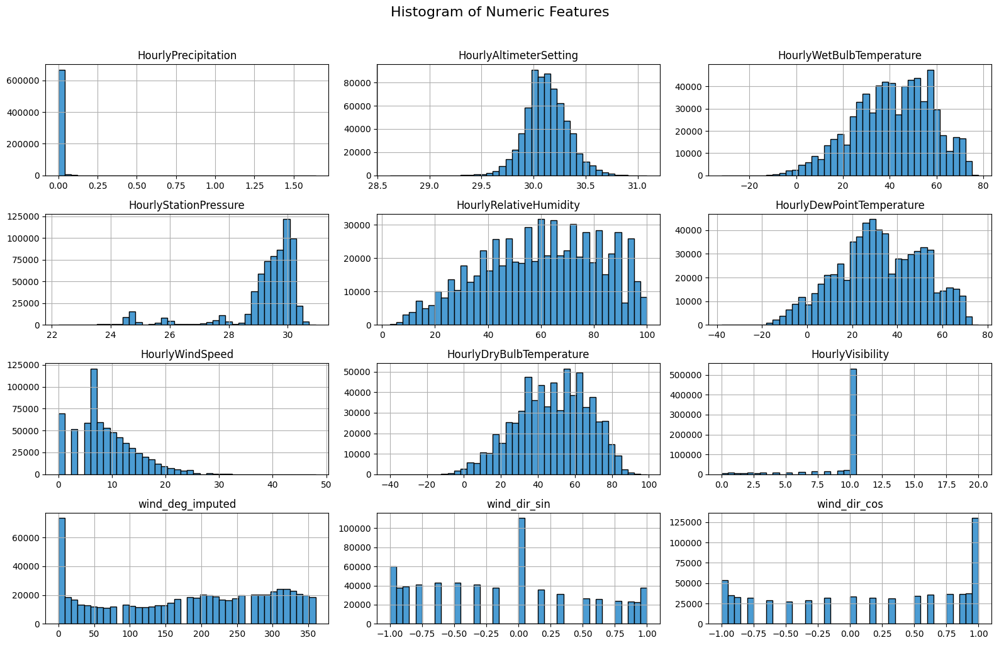

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(16, 10))
pdf.hist(bins=40, figsize=(16, 10), layout=(4, 3), color="#4B9CD3", edgecolor="black")
plt.suptitle("Histogram of Numeric Features", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()


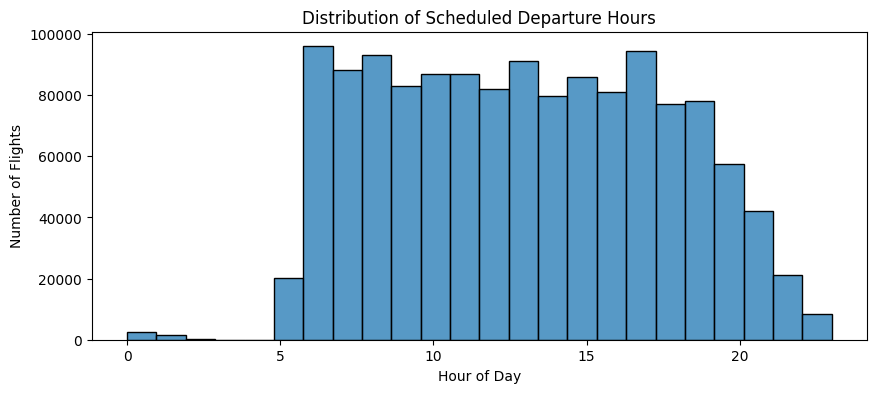

In [0]:
from pyspark.sql import functions as F
import matplotlib.pyplot as plt
import seaborn as sns

df_hr = df_imputed.withColumn("DEP_HOUR", F.floor(F.col("CRS_DEP_TIME")/100))
pd_df = df_hr.select("DEP_HOUR").toPandas()

plt.figure(figsize=(10,4))
sns.histplot(pd_df["DEP_HOUR"], bins=24, kde=False)
plt.title("Distribution of Scheduled Departure Hours")
plt.xlabel("Hour of Day")
plt.ylabel("Number of Flights")
plt.show()


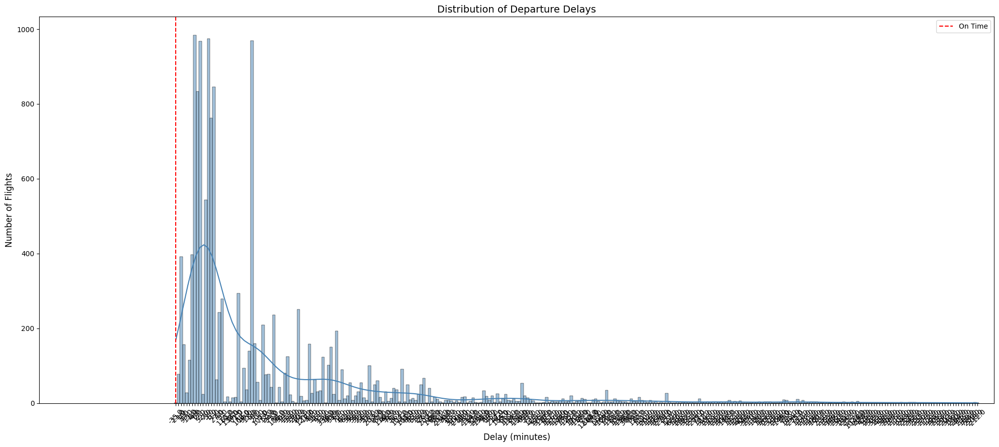

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# sample for visualization
delay_pd = df_imputed.select("DEP_DELAY").sample(fraction=0.01, seed=42).toPandas()

plt.figure(figsize=(20,9))
sns.histplot(delay_pd["DEP_DELAY"].dropna(), bins=100, kde=True, color="steelblue")

plt.title("Distribution of Departure Delays", fontsize=14)
plt.xlabel("Delay (minutes)", fontsize=12)
plt.ylabel("Number of Flights", fontsize=12)

# limit x-axis to remove extreme outliers
plt.xlim(-50, 300)
plt.xticks(rotation=45)
plt.axvline(0, color='red', linestyle='--', label='On Time')
plt.legend()
plt.tight_layout()
plt.show()


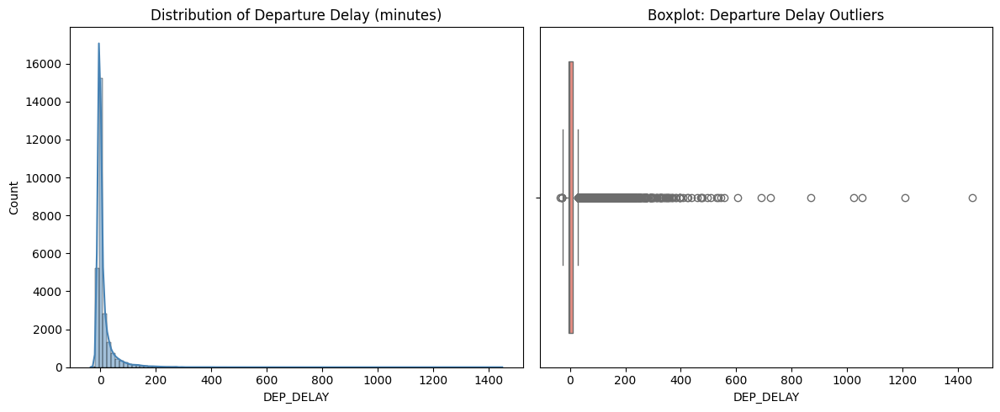

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Convert a manageable sample to Pandas
pdf = (
    df.select("DEP_DELAY")
      .filter(F.col("DEP_DELAY").isNotNull())
      .sample(fraction=0.02, seed=42)
      .toPandas()
)

# Convert to numeric (if stored as string)
pdf["DEP_DELAY"] = pd.to_numeric(pdf["DEP_DELAY"], errors="coerce")

# --- Plot histogram and boxplot ---
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
sns.histplot(pdf["DEP_DELAY"], bins=100, kde=True, color="steelblue")
plt.title("Distribution of Departure Delay (minutes)")
plt.xlabel("DEP_DELAY")

plt.subplot(1,2,2)
sns.boxplot(x=pdf["DEP_DELAY"], color="salmon")
plt.title("Boxplot: Departure Delay Outliers")
plt.xlabel("DEP_DELAY")

plt.tight_layout()
plt.show()


In [0]:
import pandas as pd

def detect_outliers_iqr(pdf, col):
    Q1 = pdf[col].quantile(0.25)
    Q3 = pdf[col].quantile(0.75)
    IQR = Q3 - Q1
    lower, upper = Q1 - 1.5*IQR, Q3 + 1.5*IQR
    mask = (pdf[col] < lower) | (pdf[col] > upper)
    return pd.DataFrame({
        "col": [col],
        "lower": [lower],
        "upper": [upper],
        "num_outliers": [mask.sum()],
        "pct_outliers": [100*mask.mean()]
    })

outlier_summary = pd.concat([detect_outliers_iqr(pdf, c) for c in numeric_cols])
print(outlier_summary.sort_values("pct_outliers", ascending=False))


                         col    lower     upper  num_outliers  pct_outliers
0           HourlyVisibility   10.000   10.0000          2994     21.806264
0        HourlyPrecipitation    0.000    0.0000          1977     14.399126
0      HourlyStationPressure   27.825   31.3050          1417     10.320466
0     HourlyAltimeterSetting   29.625   30.6250           225      1.638747
0            HourlyWindSpeed   -7.000   25.0000            86      0.626366
0   HourlyWetBulbTemperature   -6.000   90.0000            23      0.167516
0   HourlyDryBulbTemperature   -9.500  106.5000             6      0.043700
0  HourlyDewPointTemperature  -23.000   89.0000             1      0.007283
0     HourlyRelativeHumidity   -9.500  130.5000             0      0.000000
0           wind_deg_imputed -235.000  605.0000             0      0.000000
0               wind_dir_sin   -2.428    2.0040             0      0.000000
0               wind_dir_cos   -2.906    3.1292             0      0.000000


In [0]:
Q1 = pdf["DEP_DELAY"].quantile(0.25)
Q3 = pdf["DEP_DELAY"].quantile(0.75)
IQR = Q3 - Q1
upper = Q3 + 1.5 * IQR
lower = Q1 - 1.5 * IQR
print(f"Lower: {lower}, Upper: {upper}")

Lower: -26.0, Upper: 30.0


In [0]:
df.select("DEP_DELAY").describe().show()


+-------+------------------+
|summary|         DEP_DELAY|
+-------+------------------+
|  count|           1357884|
|   mean|10.314983459559137|
| stddev|37.714422801627165|
|    min|              -1.0|
|    max|             996.0|
+-------+------------------+



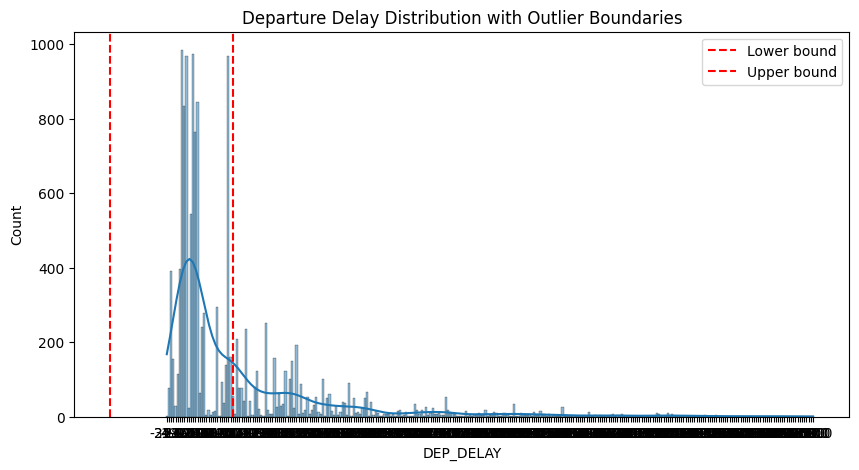

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

pdf = df.select("DEP_DELAY").sample(0.01, seed=42).toPandas()

plt.figure(figsize=(10, 5))
sns.histplot(pdf["DEP_DELAY"], bins=100, kde=True)
plt.axvline(-26, color='red', linestyle='--', label='Lower bound')
plt.axvline(30, color='red', linestyle='--', label='Upper bound')
plt.title("Departure Delay Distribution with Outlier Boundaries")
plt.legend()
plt.show()


In [0]:
from pyspark.sql import functions as F
from pyspark.sql.window import Window

# Mark outliers
df_delay_outliers = df.withColumn(
    "is_outlier",
    ((F.col("DEP_DELAY") < -26) | (F.col("DEP_DELAY") > 60)).cast("int")
)

# Summarize
outlier_summary = (
    df_delay_outliers.groupBy("is_outlier")
      .agg(F.count("*").alias("count"))
      .withColumn(
          "percent",
          F.round(F.col("count") / F.sum("count").over(Window.partitionBy()) * 100, 2)
      )
)
outlier_summary.show()


+----------+-------+-------+
|is_outlier|  count|percent|
+----------+-------+-------+
|         1|  81708|   6.02|
|         0|1276176|  93.98|
+----------+-------+-------+



# Feature Engineering


In [0]:
# HourlySkyConditions


In [0]:
# number of unique origin airports
unique_origins = df_otpw.select(F.countDistinct("ORIGIN")).collect()[0][0]
print(f"Number of unique origin airports: {unique_origins}")

Number of unique origin airports: 313


In [0]:
# number of unique airline
unique_airlines = df_otpw.select(F.countDistinct("OP_CARRIER")).collect()[0][0]
print(f"Number of unique airlines: {unique_airlines}")
# number of unique destination airports
unique_destinations = df_otpw.select(F.countDistinct("DEST")).collect()[0][0]
print(f"Number of unique destination airports: {unique_destinations}")


Number of unique airlines: 14
Number of unique destination airports: 315


In [0]:

selected_cols = ['WindEquipmentChangeDate','HourlyPrecipitation','HourlySeaLevelPressure','HourlyAltimeterSetting',
 'AIR_TIME','ARR_DELAY','ACTUAL_ELAPSED_TIME','ARR_DELAY_NEW','ARR_DELAY_GROUP','ARR_DEL15',
 'TAXI_IN','WHEELS_ON','ARR_TIME','TAXI_OUT','WHEELS_OFF','DEP_DELAY_NEW','DEP_TIME','DEP_DELAY',
 'DEP_DEL15','DEP_DELAY_GROUP','HourlySkyConditions','HourlyWetBulbTemperature','HourlyStationPressure','TAIL_NUM',
 'HourlyWindDirection','HourlyRelativeHumidity','HourlyDewPointTemperature','HourlyWindSpeed','HourlyDryBulbTemperature',
 'HourlyVisibility','REM','DEST_STATE_FIPS','SOURCE','LATITUDE','DATE','STATION','two_hours_prior_depart_UTC',
 'four_hours_prior_depart_UTC','sched_depart_date_time_UTC','sched_depart_date_time','DEP_TIME_BLK','DIVERTED',
 'CANCELLED','ARR_TIME_BLK','DISTANCE_GROUP','DISTANCE','CRS_ARR_TIME','DAY_OF_MONTH','ORIGIN_AIRPORT_ID',
 'OP_CARRIER_FL_NUM','DEST_STATE_ABR','DEST_CITY_NAME','DEST','DEST_CITY_MARKET_ID','DEST_AIRPORT_SEQ_ID',
 'DEST_STATE_NM','ORIGIN_WAC','ORIGIN_STATE_NM','CRS_DEP_TIME','DEST_WAC','_row_desc','REPORT_TYPE','NAME',
 'ELEVATION','FLIGHTS','DEST_AIRPORT_ID','dest_station_id','dest_station_name','dest_airport_name','origin_station_dis',
 'origin_airport_lon','origin_airport_lat','origin_station_lon','dest_station_dis','DAY_OF_WEEK','dest_airport_lon',
 'ORIGIN_STATE_ABR','ORIGIN_CITY_NAME','ORIGIN','ORIGIN_CITY_MARKET_ID','ORIGIN_AIRPORT_SEQ_ID','OP_CARRIER',
 'OP_CARRIER_AIRLINE_ID','OP_UNIQUE_CARRIER','FL_DATE','ORIGIN_STATE_FIPS','QUARTER','dest_airport_lat',
 'dest_station_lon','dest_station_lat','dest_region','dest_type','dest_icao','LONGITUDE','CRS_ELAPSED_TIME',
 'dest_iata_code','YEAR','origin_station_lat','origin_region','origin_type','origin_icao','origin_iata_code',
 'origin_station_id','origin_station_name','origin_airport_name','MONTH']

df_filtered = df_otpw.select([c for c in selected_cols if c in df_otpw.columns])

# Try to auto-cast any column that "looks numeric" into double.
cast_exprs = []
for c in df_filtered.columns:
    cleaned = F.regexp_replace(F.col(c).cast("string"), r"[^0-9\.\-]", "")
    cast_exprs.append(cleaned.cast("double").alias(c))

df_auto = df_filtered.select(*cast_exprs)

#Keep only columns where casting produced at least some non-nulls (i.e., truly numeric)
non_null_counts = df_auto.select([
    F.sum(F.when(F.col(c).isNotNull(), 1).otherwise(0)).alias(c) for c in df_auto.columns
]).collect()[0].asDict()

numeric_cols = [c for c, nn in non_null_counts.items() if nn and nn > 0]

print(f"Total selected columns: {len(df_filtered.columns)}")
print(f"Numeric columns detected after auto-cast: {len(numeric_cols)}")
if numeric_cols:
    # 3) Describe only numeric columns
    summary_df = df_auto.select(numeric_cols).describe()
    summary_pd = summary_df.toPandas()
    summary_transposed = (
        summary_pd.set_index("summary").T.reset_index().rename(columns={"index": "Column"})
    )

    # Convert numeric fields for nicer formatting (ignore 'count' which is string)
    for colname in ["mean","stddev","min","max"]:
        if colname in summary_transposed.columns:
            summary_transposed[colname] = pd.to_numeric(summary_transposed[colname], errors="coerce")

    display(summary_transposed.sort_values("Column"))


Total selected columns: 106
Numeric columns detected after auto-cast: 77


Column,count,mean,stddev,min,max
ACTUAL_ELAPSED_TIME,1354762,136.6265107819676,73.66362873319005,15.0,766.0
AIR_TIME,1354762,112.7795199452007,71.61841747759915,7.0,690.0
ARR_DEL15,1354762,0.2111625510606291,0.4081336191052308,0.0,1.0
ARR_DELAY,1354762,6.237716292603424,40.514577420360325,-87.0,1971.0
ARR_DELAY_GROUP,1354762,-0.0784196781427291,2.246344583367148,-2.0,12.0
ARR_DELAY_NEW,1354762,13.404223767717134,37.01009132007688,0.0,1971.0
ARR_TIME,1357047,1491.0795654093042,511.652694016885,1.0,2400.0
CANCELLED,1401363,0.0310048145983588,0.173330717153301,0.0,1.0
CRS_ARR_TIME,1401363,1504.956553726622,491.818773138305,1.0,2400.0
CRS_DEP_TIME,1401363,1327.3694809981423,473.6824407220864,1.0,2359.0


### How long the flight is delayed?

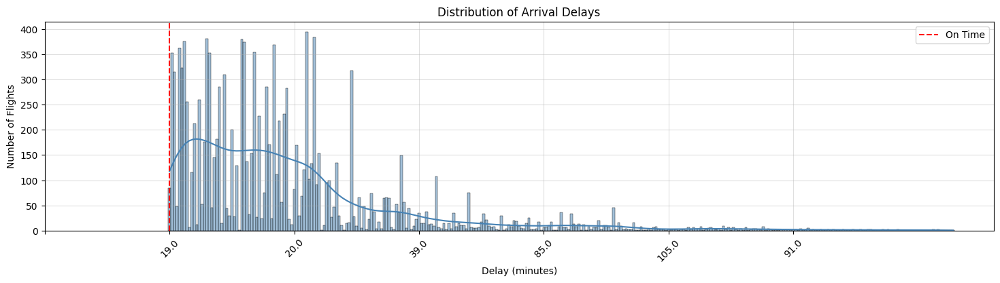

In [0]:

delay_pd = df_otpw.select("ARR_DELAY", "DEP_DELAY").sample(fraction=0.01, seed=42).toPandas()

plt.figure(figsize=(18,4))
sns.histplot(delay_pd["ARR_DELAY"].dropna(), bins=50, kde=True, color="steelblue")
plt.title("Distribution of Arrival Delays")
plt.xlabel("Delay (minutes)")
plt.ylabel("Number of Flights")
plt.axvline(0, color="red", linestyle="--", label="On Time")
plt.xticks(range(-50, 300, 50), rotation=45)
plt.legend()
plt.grid(alpha=0.4)
plt.show()



### Average Delay by Origin

/root/.ipykernel/4601/command-7595491226473208-2588220785:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=delayed_pd, x="num_delayed_flights", y="ORIGIN", palette="Blues_r")


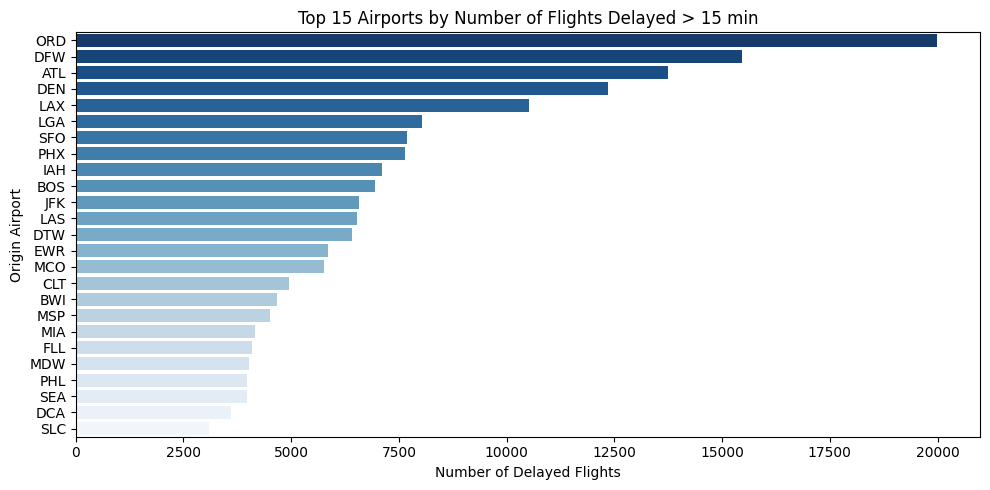

In [0]:
# avg_air = (df_otpw.groupBy("ORIGIN")
#        .agg(F.mean("ARR_DELAY").alias("avg_delay"))
#        .orderBy(F.desc("avg_delay")).limit(15))

# sns.barplot(data=avg_air.toPandas(), x="avg_delay", y="ORIGIN", palette="Blues_r")

delay_threshold = 15

delayed_flights = (
    df_otpw
    .filter(F.col("ARR_DELAY") > delay_threshold)
    .groupBy("ORIGIN")
    .agg(F.count("*").alias("num_delayed_flights"))
    .orderBy(F.desc("num_delayed_flights"))
    .limit(25)
)

delayed_pd = delayed_flights.toPandas()

plt.figure(figsize=(10,5))
sns.barplot(data=delayed_pd, x="num_delayed_flights", y="ORIGIN", palette="Blues_r")
plt.title(f"Top 15 Airports by Number of Flights Delayed > {delay_threshold} min")
plt.xlabel("Number of Delayed Flights")
plt.ylabel("Origin Airport")
plt.tight_layout()
plt.show()

### Delay Happened During the Day

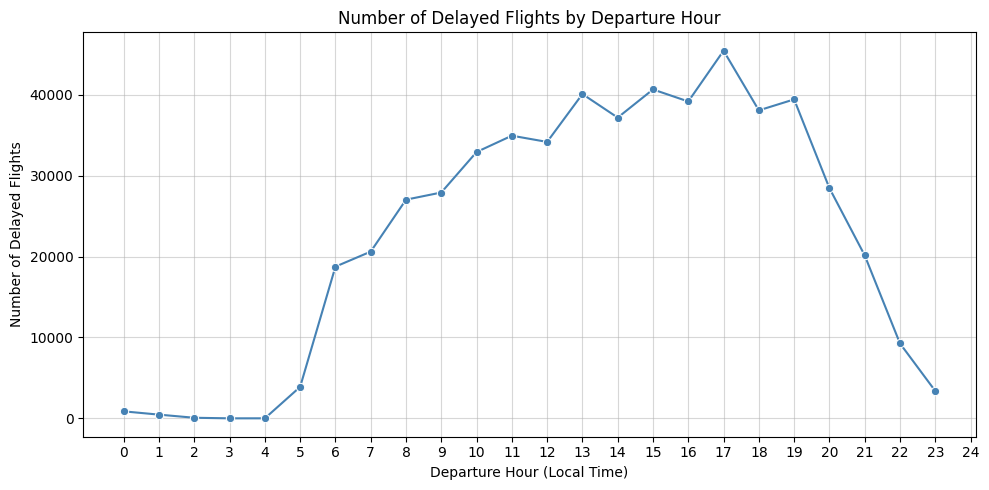

In [0]:

df_hr = df_otpw.withColumn("DEP_HOUR", F.floor(F.col("CRS_DEP_TIME") / 100))

# Count how many flights were delayed in each hour
delayed_by_hour = (
    df_hr.filter(F.col("DEP_DELAY") > 0)
         .groupBy("DEP_HOUR")
         .agg(F.count("*").alias("num_delayed_flights"))
         .orderBy("DEP_HOUR")
)

# Convert to Pandas for plotting
delayed_by_hour_pd = delayed_by_hour.toPandas()

# Plot actual delayed flights count per hour
plt.figure(figsize=(10,5))
sns.lineplot(data=delayed_by_hour_pd, x="DEP_HOUR", y="num_delayed_flights", marker="o", color="steelblue")
plt.title("Number of Delayed Flights by Departure Hour")
plt.xlabel("Departure Hour (Local Time)")
plt.ylabel("Number of Delayed Flights")
plt.grid(alpha=0.5)
plt.xticks(range(0, 25))
plt.tight_layout()
plt.show()



### Count of Delayed Flights per Airline

/root/.ipykernel/4601/command-7595491226473205-2544445240:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=delayed_count_pd, x="num_delayed_flights", y="OP_CARRIER", palette="Blues_r")


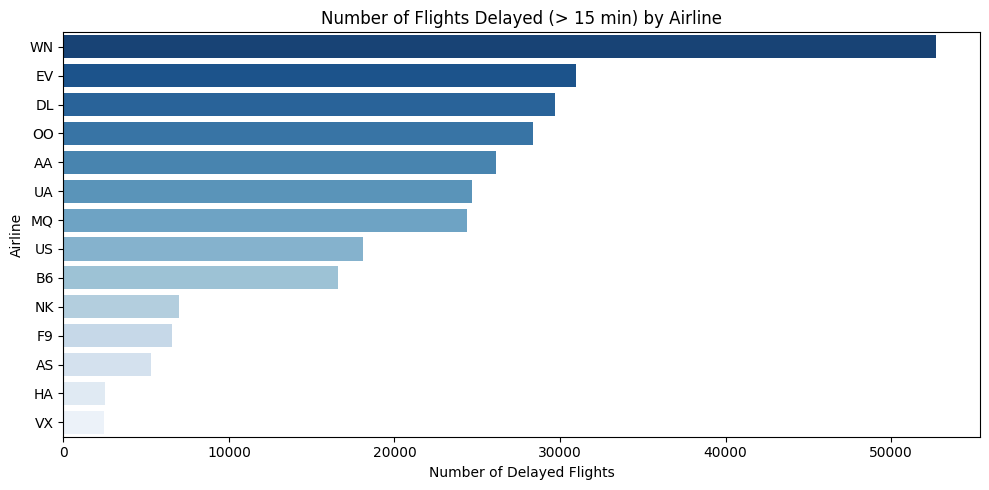

In [0]:

delay_threshold = 15  

delayed_count = (
    df_otpw.filter(F.col("ARR_DELAY") > delay_threshold)
           .groupBy("OP_CARRIER")
           .agg(F.count("*").alias("num_delayed_flights"))
           .orderBy(F.desc("num_delayed_flights"))
)

delayed_count_pd = delayed_count.toPandas()

plt.figure(figsize=(10,5))
sns.barplot(data=delayed_count_pd, x="num_delayed_flights", y="OP_CARRIER", palette="Blues_r")
plt.title(f"Number of Flights Delayed (> {delay_threshold} min) by Airline")
plt.xlabel("Number of Delayed Flights")
plt.ylabel("Airline")
plt.tight_layout()
plt.show()



### Number of filghts per day

In [0]:
from pyspark.sql.functions import count, col

flights_per_day = (
    df_otpw.groupBy("FL_DATE", "ORIGIN")
    .agg(count("*").alias("num_flights"))
    .orderBy("FL_DATE")
)

display(flights_per_day)


FL_DATE,ORIGIN,num_flights
2015-01-01,SMF,85
2015-01-01,BLI,3
2015-01-01,RNO,34
2015-01-01,BJI,2
2015-01-01,SJC,85
2015-01-01,MSY,93
2015-01-01,MOB,12
2015-01-01,EVV,6
2015-01-01,OMA,39
2015-01-01,BIS,7
